## Automated Julia Package Installation Script

1) This script installs a predefined list of Julia packages commonly used for data analysis, machine learning, and visualization. 
2) It uses a loop to add each package, handles errors gracefully, and prints informative messages about the installation process. 
3) Wrapping the script with @time helps measure total execution time.

In [3]:
# ----------------------------------------------------------
# Automated Julia Package Installation Script
# ----------------------------------------------------------
# This script installs a set of useful Julia packages for:
# - Data manipulation and storage (DataFrames, CSV, Pandas)
# - Visualization (Plots, StatsPlots)
# - Statistics and probability (Statistics, Distributions)
# - Machine learning and modeling (GLM, Turing, ScikitLearn)
# - Interfacing with Python (PyCall, Conda)
# - Benchmarking performance (BenchmarkTools)
# - Notebook support (IJulia)
#
# The script also uses error handling to ensure that if one
# package fails to install, the rest still proceed.
# ----------------------------------------------------------

@time begin  # Measure total execution time

    using Pkg  # Julia's package manager

    # List of packages to be installed
    packages = [
        "DataFrames",      # Tabular data manipulation
        "CSV",             # Reading and writing CSV files
        "Plots",           # General plotting library
        "StatsPlots",      # Statistical plotting recipes
        "Statistics",      # Built-in statistical functions
        "Distributions",   # Probability distributions and functions
        "GLM",             # Generalized linear models
        "Turing",          # Probabilistic programming and Bayesian inference
        "IJulia",          # Jupyter notebook integration
        "PyCall",          # Call Python functions from Julia
        "Conda",           # Manage Python dependencies
        "Pandas",          # Interface to Python Pandas
        "ScikitLearn",     # Interface to Python Scikit-learn
        "BenchmarkTools"   # Performance benchmarking
    ]

    # Loop through each package and attempt installation
    for pkg in packages
        try
            Pkg.add(pkg)  # Install package
            println("✅ Successfully added $pkg")
        catch e
            # Print error if installation fails
            println("❌ Could not add $pkg. Error: $e")
        end
    end

end


    Updating registry at `C:\Users\Lenovo\.julia\registries\General.toml`
   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added DataFrames


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added CSV


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added Plots


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added StatsPlots


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added Statistics


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added Distributions


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added GLM


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added Turing


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added IJulia


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added PyCall


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added Conda


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added Pandas


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added ScikitLearn


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


✅ Successfully added BenchmarkTools
358.427712 seconds (134.89 M allocations: 10.848 GiB, 2.54% gc time, 2.07% compilation time: 48% of which was recompilation)


## Reading Large CSV Files in Chunks with Julia

1) This Julia script defines a function to read a large CSV file in manageable batches using the CSV.jl and DataFrames.jl packages.
2) It processes the file iteratively by reading a fixed number of rows (batch_size) at a time, ensuring consistent column names, and then combines all batches into a single DataFrame.
3) This approach is useful for handling files that are too large to load entirely into memory at once.

In [4]:
# ----------------------------------------------------------
# Reading Large CSV Files in Chunks with Julia
# ----------------------------------------------------------
# This script defines a function `read_csv_in_chunks` that:
# - Reads large CSV files in smaller batches (chunks)
# - Preserves column headers across all chunks
# - Combines the chunks into one final DataFrame
#
# Advantages:
# - Useful when CSV is too large to fit into memory at once
# - Provides batch-wise feedback on progress
# ----------------------------------------------------------

@time begin   # Measure total execution time of the block

    using CSV, DataFrames

    """
    read_csv_in_chunks(filename::String, batch_size::Int) -> DataFrame

    Reads a CSV file in chunks of `batch_size` rows, 
    and combines them into a single DataFrame.

    Arguments:
        filename::String  : Path to the CSV file
        batch_size::Int   : Number of rows to read per chunk

    Returns:
        DataFrame containing all rows of the CSV
    """
    function read_csv_in_chunks(filename::String, batch_size::Int)
        dfs = DataFrame[]   # Store individual batch DataFrames
        offset = 2          # Start at row 2 (row 1 is the header)

        # Extract column names from the first row
        header = CSV.File(filename; limit=1) |> DataFrame
        colnames = names(header)

        # Loop to read batches until no rows are left
        while true
            # Read next batch (skipto ensures correct offset)
            df = DataFrame(CSV.File(filename; limit=batch_size, skipto=offset))

            # Exit if no more rows are available
            if nrow(df) == 0
                break
            end

            # Ensure the column names are consistent
            rename!(df, colnames)

            # Save batch to list
            push!(dfs, df)
            println("📦 Read batch with $(nrow(df)) rows")

            # Update offset for next chunk
            offset += batch_size
        end

        # Combine all batches into a single DataFrame
        return vcat(dfs...)
    end

end


  1.676984 seconds (604.54 k allocations: 37.703 MiB, 4.12% gc time)


read_csv_in_chunks

## Loading and Inspecting a Large CSV File in Batches

1) This script demonstrates how to load a large dataset (loan.csv from Kaggle’s Lending Club dataset) in chunks of 100,000 rows at a time using the previously defined read_csv_in_chunks function.
2) After reading the file, it prints the final DataFrame’s size and displays the first few rows to confirm successful loading and column structure.

In [5]:
# ----------------------------------------------------------
# Loading and Inspecting a Large CSV File in Batches
# ----------------------------------------------------------
# This script uses the custom function `read_csv_in_chunks`
# to load a large CSV file in smaller, manageable batches.
#
# Steps:
# 1. Specify the CSV file path
# 2. Read the file in chunks of 100,000 rows
# 3. Combine all chunks into one DataFrame
# 4. Print the final size of the DataFrame
# 5. Preview the first 5 rows with column names
# ----------------------------------------------------------

@time begin   # Measure total execution time of the block

    # Path to the Lending Club dataset
    filename = "D:/Kaggle/Lending Club Loan Data/loan.csv"

    # Read the CSV in chunks of 100,000 rows
    df_final = read_csv_in_chunks(filename, 100_000)

    # Print overall shape of the final DataFrame
    println("✅ Final DataFrame size: ", size(df_final))

    # Display the first 5 rows with column names
    println("🔍 Preview of data:")
    println(first(df_final, 5))

end


📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 100000 rows
📦 Read batch with 60668 rows
✅ Final DataFrame size: (2260668, 145)
🔍 Preview of data:
5×145 DataFrame
 Row │ id       member_id  loan_amnt  funded_amnt  funded_amnt_inv  term        int_rate  installment  grade    sub_grade  emp_title       emp_length  home_ownership  annual_inc  verification_status  issue_d   loan_status  pymnt_plan  ur

## Checking the Shape of a DataFrame in Julia

1) This script retrieves the dimensions of a DataFrame (df_final) using Julia’s size function.
2) The result is returned as a tuple (rows, columns), which provides a quick overview of the dataset size.
3) This is useful for validating data loading steps and understanding the scale of the dataset before further analysis.

In [6]:
# ----------------------------------------------------------
# Checking the Shape of a DataFrame in Julia
# ----------------------------------------------------------
# This script retrieves the dimensions of `df_final`
# using the `size()` function.
#
# - The result is a tuple: (number of rows, number of columns)
# - Helps verify the dataset size after loading or processing
# ----------------------------------------------------------

@time begin   # Measure total execution time of this block

    # Get the shape as a tuple (rows, columns)
    shape = size(df_final)

    # Print the shape of the DataFrame
    println("📐 DataFrame shape: ", shape)

end


📐 DataFrame shape: (2260668, 145)
  0.001670 seconds (206 allocations: 10.438 KiB)


## Generating a Statistical Summary of a DataFrame

1) This script uses Julia’s describe() function to produce a summary of each column in the DataFrame.
2) The output includes statistics such as the number of missing values, mean, minimum, maximum, and percentiles (for numeric data), as well as type and unique counts (for categorical data).
3) It’s a quick way to understand the structure and quality of the dataset.

In [7]:
# ----------------------------------------------------------
# Generating a Statistical Summary of a DataFrame
# ----------------------------------------------------------
# This script applies the `describe()` function on `df_final`
# to obtain summary statistics for each column.
#
# Output typically includes:
# - Variable name and type
# - Number of missing values
# - Mean, min, max, and percentiles (for numeric columns)
# - Unique counts (for categorical columns)
#
# This is useful for quick data exploration and validation.
# ----------------------------------------------------------

@time begin   # Measure execution time of this block

    # Generate and display summary statistics of the DataFrame
    describe(df_final)

end


 32.137551 seconds (7.66 M allocations: 2.900 GiB, 29.63% gc time, 18.41% compilation time: 22% of which was recompilation)


Row,variable,mean,min,median,max,nmissing,eltype
,Symbol,Union…,Any,Union…,Any,Int64,Type
1,id,,,,,2260668,Missing
2,member_id,,,,,2260668,Missing
3,loan_amnt,15046.9,500,12900.0,40000,0,Int64
4,funded_amnt,15041.7,500,12875.0,40000,0,Int64
5,funded_amnt_inv,15023.4,0.0,12800.0,40000.0,0,Float64
6,term,,36 months,,60 months,0,String15
7,int_rate,13.0929,5.31,12.62,30.99,0,Float64
8,installment,445.808,4.93,377.99,1719.83,0,Float64
9,grade,,A,,G,0,String1


## Identifying Missing Values in a DataFrame

1) This script calculates the number of missing values in each column of a DataFrame (df_final).
2) It maps the ismissing function over every column, pairs the results with column names, and stores them in a NamedTuple.
3) This provides a quick overview of data quality and highlights which columns may require cleaning or imputation.

In [8]:
# ----------------------------------------------------------
# Identifying Missing Values in a DataFrame
# ----------------------------------------------------------
# This script computes the count of missing values in each
# column of `df_final` and pairs the results with column names.
#
# Steps:
# 1. Use `ismissing` to detect missing entries in each column
# 2. Count missing values with `sum(ismissing, col)`
# 3. Collect results into a NamedTuple (column => missing_count)
# 4. Print the summary for inspection
#
# This is useful for data cleaning and preprocessing steps.
# ----------------------------------------------------------

@time begin   # Measure total execution time of the block

    using DataFrames

    # Count missing values per column
    missing_counts = map(col -> sum(ismissing, col), eachcol(df_final))

    # Get column names
    column_names = names(df_final)

    # Pair column names with their missing counts in a NamedTuple
    missing_data_summary = NamedTuple(Symbol.(column_names) .=> missing_counts)

    # Display summary of missing values
    println("🔎 Missing values per column:")
    println(missing_data_summary)

end

🔎 Missing values per column:
(id = 2260668, member_id = 2260668, loan_amnt = 0, funded_amnt = 0, funded_amnt_inv = 0, term = 0, int_rate = 0, installment = 0, grade = 0, sub_grade = 0, emp_title = 166931, emp_length = 0, home_ownership = 0, annual_inc = 4, verification_status = 0, issue_d = 0, loan_status = 0, pymnt_plan = 0, url = 2260668, desc = 2134600, purpose = 0, title = 23322, zip_code = 1, addr_state = 0, dti = 1711, delinq_2yrs = 29, earliest_cr_line = 29, inq_last_6mths = 30, mths_since_last_delinq = 1158502, mths_since_last_record = 1901512, open_acc = 29, pub_rec = 29, revol_bal = 0, revol_util = 1802, total_acc = 29, initial_list_status = 0, out_prncp = 0, out_prncp_inv = 0, total_pymnt = 0, total_pymnt_inv = 0, total_rec_prncp = 0, total_rec_int = 0, total_rec_late_fee = 0, recoveries = 0, collection_recovery_fee = 0, last_pymnt_d = 2426, last_pymnt_amnt = 0, next_pymnt_d = 1303607, last_credit_pull_d = 73, collections_12_mths_ex_med = 145, mths_since_last_major_derog = 1

## Calculating Missing Value Percentages in a DataFrame

1) This script computes the percentage of missing values in each column of a DataFrame (df_final).
2) It divides the count of missing entries by the column length, multiplies by 100, and pairs results with column names in a NamedTuple.
3) This helps assess data quality and quickly identify columns that may require cleaning, imputation, or removal.

In [9]:
# ----------------------------------------------------------
# Calculating Missing Value Percentages in a DataFrame
# ----------------------------------------------------------
# This script calculates the percentage of missing values 
# for each column in `df_final`.
#
# Steps:
# 1. For each column, compute (#missing / total rows) * 100
# 2. Store results as percentages in a NamedTuple
# 3. Pair column names with their missing percentages
# 4. Print the summary for inspection
#
# This helps identify which columns have high proportions
# of missing data and may need special handling.
# ----------------------------------------------------------

@time begin   # Measure total execution time of the block

    using DataFrames

    # Compute percentage of missing values for each column
    missing_percentages = map(col -> (sum(ismissing, col) / length(col)) * 100,
                              eachcol(df_final))

    # Extract column names
    column_names = names(df_final)

    # Pair column names with their missing value percentages
    missing_data_summary = NamedTuple(Symbol.(column_names) .=> missing_percentages)

    # Display summary of missing value percentages
    println("📊 Missing value percentages per column:")
    println(missing_data_summary)

end


📊 Missing value percentages per column:
(id = 100.0, member_id = 100.0, loan_amnt = 0.0, funded_amnt = 0.0, funded_amnt_inv = 0.0, term = 0.0, int_rate = 0.0, installment = 0.0, grade = 0.0, sub_grade = 0.0, emp_title = 7.384144863376665, emp_length = 0.0, home_ownership = 0.0, annual_inc = 0.00017693885170224022, verification_status = 0.0, issue_d = 0.0, loan_status = 0.0, pymnt_plan = 0.0, url = 100.0, desc = 94.4234182109005, purpose = 0.0, title = 1.0316419748499115, zip_code = 4.4234712925560055e-5, addr_state = 0.0, dti = 0.07568559381563325, delinq_2yrs = 0.0012828066748412415, earliest_cr_line = 0.0012828066748412415, inq_last_6mths = 0.0013270413877668017, mths_since_last_delinq = 51.246003393687175, mths_since_last_record = 84.11283744450755, open_acc = 0.0012828066748412415, pub_rec = 0.0012828066748412415, revol_bal = 0.0, revol_util = 0.07971095269185922, total_acc = 0.0012828066748412415, initial_list_status = 0.0, out_prncp = 0.0, out_prncp_inv = 0.0, total_pymnt = 0.0, 

## Dropping Columns with Excessive Missing Values in a DataFrame

1) This script identifies and removes columns from a DataFrame (df_final) where more than 75% of the values are missing.
2) It uses a list comprehension to filter column names based on their missing percentage, prints the affected columns, and then applies select! to drop them in place.
3) This step is useful in data cleaning pipelines, where features with too much missing information add little value to analysis or modeling.

In [10]:
# ----------------------------------------------------------
# Dropping Columns with Excessive Missing Values in a DataFrame
# ----------------------------------------------------------
# This script identifies columns in `df_final` where more than
# 75% of the data is missing, prints their names, and removes
# them from the DataFrame.
#
# Steps:
# 1. Calculate missing percentage for each column
# 2. Select column names where missing % > 75
# 3. Print the list of such columns
# 4. Drop those columns from `df_final` in place
#
# This ensures only columns with sufficient data are retained.
# ----------------------------------------------------------

@time begin   # Measure total execution time of the block

    using DataFrames

    # Identify columns with more than 75% missing values
    columns_to_drop = [
        name for (name, col) in pairs(eachcol(df_final))
        if sum(ismissing, col) / length(col) * 100 > 75
    ]

    # Print the columns flagged for removal
    println("🗑️ Columns with more than 75% missing values:")
    println(columns_to_drop)

    # Drop the identified columns from the DataFrame (in-place)
    select!(df_final, Not(columns_to_drop))

end


🗑️ Columns with more than 75% missing values:
[:id, :member_id, :url, :desc, :mths_since_last_record, :annual_inc_joint, :dti_joint, :verification_status_joint, :mths_since_recent_bc_dlq, :revol_bal_joint, :sec_app_earliest_cr_line, :sec_app_inq_last_6mths, :sec_app_mort_acc, :sec_app_open_acc, :sec_app_revol_util, :sec_app_open_act_il, :sec_app_num_rev_accts, :sec_app_chargeoff_within_12_mths, :sec_app_collections_12_mths_ex_med, :sec_app_mths_since_last_major_derog, :hardship_type, :hardship_reason, :hardship_status, :deferral_term, :hardship_amount, :hardship_start_date, :hardship_end_date, :payment_plan_start_date, :hardship_length, :hardship_dpd, :hardship_loan_status, :orig_projected_additional_accrued_interest, :hardship_payoff_balance_amount, :hardship_last_payment_amount, :debt_settlement_flag_date, :settlement_status, :settlement_date, :settlement_amount, :settlement_percentage, :settlement_term]
  3.306153 seconds (2.91 M allocations: 154.271 MiB, 92.99% compilation time)


Row,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,inq_last_6mths,mths_since_last_delinq,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,⋯
,Int64,Int64,Float64,String15,Float64,Float64,String1,String3,String?,String15,String15,Float64?,String15,String15,String,String1,String31,String?,String7?,String3,Float64?,Int64?,String15?,Int64?,Int64?,Int64?,Int64?,Int64,Float64?,Int64?,String1,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,String15?,Float64,String15?,String15?,Int64?,Int64?,Int64,String15,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Float64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Float64?,Float64?,Int64?,Int64?,Int64?,Int64?,⋯
1,2500,2500,2500.0,36 months,13.56,84.92,C,C1,Chef,10+ years,RENT,55000.0,Not Verified,Dec-2018,Current,n,debt_consolidation,Debt consolidation,109xx,NY,18.24,0,Apr-2001,1,missing,9,1,4341,10.3,34,w,2386.02,2386.02,167.02,167.02,113.98,53.04,0.0,0.0,0.0,Feb-2019,84.92,Mar-2019,Feb-2019,0,missing,1,Individual,0,0,16901,2,2,1,2,2,12560,69,2,7,2137,28,42000,1,11,2,9,1878,34360,5.9,0,0,140,212,1,1,0,1,2,missing,0,2,5,3,3,16,7,18,5,9,0,0,0,3,100.0,0.0,1,0,60124,16901,⋯
2,30000,30000,30000.0,60 months,18.94,777.23,D,D2,Postmaster,10+ years,MORTGAGE,90000.0,Source Verified,Dec-2018,Current,n,debt_consolidation,Debt consolidation,713xx,LA,26.52,0,Jun-1987,0,71,13,1,12315,24.2,44,w,29387.8,29387.8,1507.11,1507.11,612.25,894.86,0.0,0.0,0.0,Feb-2019,777.23,Mar-2019,Feb-2019,0,missing,1,Individual,0,1208,321915,4,4,2,3,3,87153,88,4,5,998,57,50800,2,15,2,10,24763,13761,8.3,0,0,163,378,4,3,3,4,4,missing,0,2,4,4,9,27,8,14,4,13,0,0,0,6,95.0,0.0,1,0,372872,99468,⋯
3,5000,5000,5000.0,36 months,17.97,180.69,D,D1,Administrative,6 years,MORTGAGE,59280.0,Source Verified,Dec-2018,Current,n,debt_consolidation,Debt consolidation,490xx,MI,10.51,0,Apr-2011,0,missing,8,0,4599,19.1,13,w,4787.21,4787.21,353.89,353.89,212.79,141.1,0.0,0.0,0.0,Feb-2019,180.69,Mar-2019,Feb-2019,0,missing,1,Individual,0,0,110299,0,1,0,2,14,7150,72,0,2,0,35,24100,1,5,0,4,18383,13800,0.0,0,0,87,92,15,14,2,77,14,missing,0,0,3,3,3,4,6,7,3,8,0,0,0,0,100.0,0.0,0,0,136927,11749,⋯
4,4000,4000,4000.0,36 months,18.94,146.51,D,D2,IT Supervisor,10+ years,MORTGAGE,92000.0,Source Verified,Dec-2018,Current,n,debt_consolidation,Debt consolidation,985xx,WA,16.74,0,Feb-2006,0,missing,10,0,5468,78.1,13,w,3831.93,3831.93,286.71,286.71,168.07,118.64,0.0,0.0,0.0,Feb-2019,146.51,Mar-2019,Feb-2019,0,missing,1,Individual,0,686,305049,1,5,3,5,5,30683,68,0,0,3761,70,7

## Checking the Dimensions of a DataFrame

1) This script retrieves the shape (rows, columns) of a DataFrame (df_final) using Julia’s size function.
2) The result is printed as a tuple (number of rows, number of columns).
3) This is a quick way to verify the dataset’s dimensions after loading or cleaning.

In [11]:
# ----------------------------------------------------------
# Checking the Dimensions of a DataFrame
# ----------------------------------------------------------
# This script uses the `size()` function to get the shape 
# of the DataFrame `df_final`.
#
# - The result is a tuple: (rows, columns)
# - Helps confirm dataset size after loading/cleaning
# ----------------------------------------------------------

@time begin   # Measure execution time of this block

    # Get the shape of the DataFrame as (rows, columns)
    shape = size(df_final)

    # Print the shape tuple
    println("📐 DataFrame shape: ", shape)

end


📐 DataFrame shape: (2260668, 105)
  0.002865 seconds (207 allocations: 10.211 KiB)


## Checking Column Data Types in a DataFrame

1) This script inspects the element type (eltype) of specific columns in a DataFrame (df_final).
2) By checking the data type (e.g., Int64, Float64, String, Union{Missing, Float64}), you can better understand how data is stored and decide whether transformations, conversions, or cleaning are needed.

In [12]:
# ----------------------------------------------------------
# Checking Column Data Types in a DataFrame
# ----------------------------------------------------------
# This script checks the element type of specific columns
# in the DataFrame `df_final` using the `eltype()` function.
#
# Example columns:
# - `annual_inc` (annual income)
# - `num_tl_30dpd` (number of trade lines 30+ days past due)
#
# `eltype()` returns the data type stored in a column,
# which is useful for validating schema or preparing data
# for modeling.
# ----------------------------------------------------------

# Get the data type of the 'annual_inc' column
column_a_type = eltype(df_final.annual_inc)
println("📊 Data type of annual_inc: ", column_a_type)

# Get the data type of the 'num_tl_30dpd' column
column_b_type = eltype(df_final.num_tl_30dpd)
println("📊 Data type of num_tl_30dpd: ", column_b_type)


📊 Data type of annual_inc: Union{Missing, Float64}
📊 Data type of num_tl_30dpd: Union{Missing, Int64}


## Selecting Non-Numeric and Non-Date Columns from a DataFrame

1) This script identifies columns in a DataFrame (df_final) that are not numeric (Int64/Float64), missing-numeric, or date types (Date/DateTime).
2) These are typically categorical or “object-like” columns.
3) The result is a list of column names that can be used for further categorical analysis, encoding, or transformation.

In [13]:
# ----------------------------------------------------------
# Selecting Non-Numeric and Non-Date Columns from a DataFrame
# ----------------------------------------------------------
# This script extracts column names from `df_final` that are 
# likely categorical or object-type by excluding:
# - Numeric types: Int64, Float64
# - Nullable numeric types: Union{Missing, Int64}, Union{Missing, Float64}
# - Date types: Date, DateTime
#
# Steps:
# 1. Define a tuple of types to exclude
# 2. Loop through all columns and filter out those types
# 3. Store the remaining column names in `object_column_names`
# ----------------------------------------------------------

@time begin

    using DataFrames, Dates

    # Define types to exclude (numeric and date types)
    types_to_exclude = (
        Int64,
        Float64,
        Union{Missing, Float64},
        Union{Missing, Int64},
        Date,
        DateTime
    )

    # Select column names whose type is not in the exclusion list
    object_column_names = [
        col for col in names(df_final) 
        if !(eltype(df_final[!, col]) in types_to_exclude)
    ]

    # Display the object-like column names
    println("🗂️ Object-like columns: ", object_column_names)

end


🗂️ Object-like columns: ["term", "grade", "sub_grade", "emp_title", "emp_length", "home_ownership", "verification_status", "issue_d", "loan_status", "pymnt_plan", "purpose", "title", "zip_code", "addr_state", "earliest_cr_line", "initial_list_status", "last_pymnt_d", "next_pymnt_d", "last_credit_pull_d", "application_type", "hardship_flag", "disbursement_method", "debt_settlement_flag"]
  0.541290 seconds (542.30 k allocations: 28.496 MiB, 80.50% compilation time)


## Counting Unique Values in a Categorical Column

1) This script computes the frequency of each unique value in the :term column of a DataFrame (df_final).
2) It uses groupby to group rows by the :term values and then counts the number of rows per group using nrow.
3) This is equivalent to pandas’ value_counts() and is useful for understanding the distribution of categorical features.

In [14]:
# ----------------------------------------------------------
# Counting Unique Values in a Categorical Column
# ----------------------------------------------------------
# This script calculates the frequency of each unique value
# in the 'term' column of `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'term' column
# 2. Count the number of rows in each group
# 3. Combine the results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding categorical distributions.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'term' and count rows in each group
    value_counts = combine(groupby(df_final, :term), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'term':")
    println(value_counts)

end


📊 Value counts for 'term':
2×2 DataFrame
 Row │ term        count   
     │ String15    Int64   
─────┼─────────────────────
   1 │  36 months  1609754
   2 │  60 months   650914
  1.932350 seconds (1.93 M allocations: 167.224 MiB, 90.18% compilation time: 62% of which was recompilation)


## Bar Chart of Borrower Counts by Term

1) This script visualizes the distribution of borrowers across different loan terms using a bar chart.
2) It counts the occurrences of each unique value in the :term column of the DataFrame (df_final) and plots them with a custom color palette.
3) This helps in quickly understanding categorical distributions and spotting imbalances.

 29.550568 seconds (6.77 M allocations: 424.952 MiB, 1.61% gc time, 14.01% compilation time: 51% of which was recompilation)


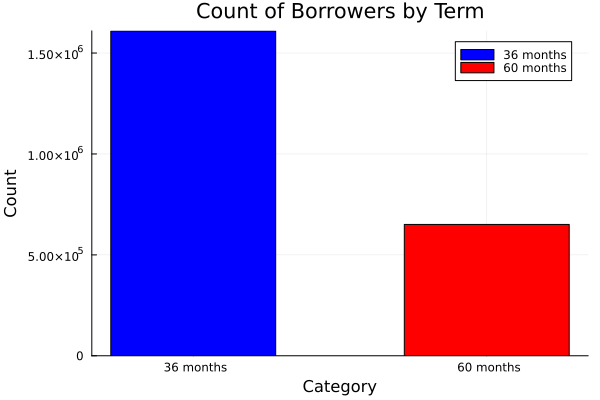

In [15]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Term
# ----------------------------------------------------------
# This script performs the following steps:
# 1. Counts the number of borrowers for each unique loan term
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick data exploration
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'term' column
    counts = combine(groupby(df_final, :term), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.term,            # x-axis: unique terms
        counts.count,           # y-axis: counts
        group = counts.term,    # group by term for colors
        title = "Count of Borrowers by Term",
        palette = custom_palette,
        xlabel = "Category",
        ylabel = "Count",
        bar_labels = true       # Show counts on top of bars
    )

end


## Counting Unique Values in the sub_grade Column

1) This script computes the frequency of each unique value in the :sub_grade column of a DataFrame (df_final).
2) It groups the data by :sub_grade and counts the number of rows in each group.
3) This provides insight into the distribution of loan sub-grades, helping in exploratory data analysis and understanding feature distributions.

In [17]:
# ----------------------------------------------------------
# Counting Unique Values in the `sub_grade` Column
# ----------------------------------------------------------
# This script calculates how many borrowers fall into each
# loan sub-grade category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'sub_grade' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding categorical distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'sub_grade' and count rows in each group
    value_counts = combine(groupby(df_final, :sub_grade), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'sub_grade':")
    println(value_counts)

end


📊 Value counts for 'sub_grade':
35×2 DataFrame
 Row │ sub_grade  count  
     │ String3    Int64  
─────┼───────────────────
   1 │ C1         145903
   2 │ D2          72899
   3 │ D1          81787
   4 │ C4         127115
   5 │ C3         129193
   6 │ C2         131116
   7 │ D5          48023
   8 │ B3         131514
   9 │ A4          95874
  10 │ B5         140288
  11 │ C5         116726
  12 │ D4          56896
  13 │ E1          33573
  14 │ E4          22763
  15 │ B4         139793
  16 │ D3          64819
  17 │ A1          86790
  18 │ E5          22671
  19 │ B2         126621
  20 │ B1         125341
  21 │ A5         107617
  22 │ F5           5167
  23 │ A3          73184
  24 │ E3          26708
  25 │ A2          69562
  26 │ E2          29924
  27 │ F4           6124
  28 │ G1           4106
  29 │ G2           2688
  30 │ F1          13413
  31 │ F2           9305
  32 │ F3           7791
  33 │ G4           1712
  34 │ G3           2094
  35 │ G5           1568


## Bar Chart of Borrower Counts by Loan Sub-Grade

1) This script visualizes the distribution of borrowers across different loan sub-grades in df_final.
2) It counts the occurrences of each unique :sub_grade value, defines a custom color palette, and plots a bar chart using StatsPlots.
3) This helps in understanding categorical distributions and identifying which sub-grades are most common.

  1.065521 seconds (1.00 M allocations: 116.257 MiB, 10.52% gc time, 82.13% compilation time)


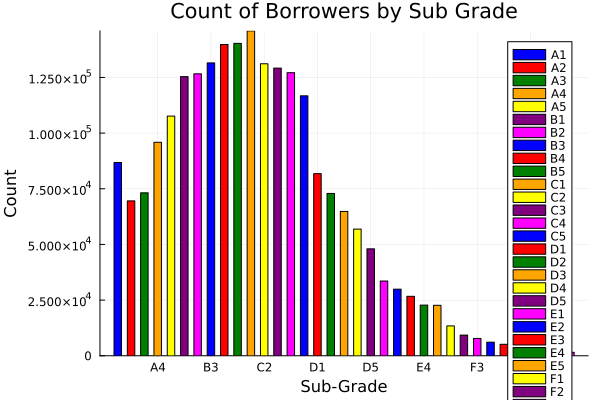

In [18]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Loan Sub-Grade
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each unique sub-grade
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'sub_grade' column
    counts = combine(groupby(df_final, :sub_grade), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.sub_grade,        # x-axis: unique sub-grades
        counts.count,            # y-axis: counts
        group = counts.sub_grade,# group by sub-grade for colors
        title = "Count of Borrowers by Sub Grade",
        palette = custom_palette,
        xlabel = "Sub-Grade",
        ylabel = "Count",
        bar_labels = true        # Show counts on top of bars
    )

end


## Counting Unique Values in the grade Column

1) This script computes the frequency of each unique value in the :grade column of a DataFrame (df_final).
2) It groups the data by :grade and counts the number of rows in each group.
3) This helps in understanding the distribution of loan grades and is useful for exploratory data analysis.

In [20]:
# ----------------------------------------------------------
# Counting Unique Values in the `grade` Column
# ----------------------------------------------------------
# This script calculates how many borrowers fall into each
# loan grade category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'grade' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding categorical distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'grade' and count rows in each group
    value_counts = combine(groupby(df_final, :grade), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'grade':")
    println(value_counts)

end


📊 Value counts for 'grade':
7×2 DataFrame
 Row │ grade    count  
     │ String1  Int64  
─────┼─────────────────
   1 │ C        650053
   2 │ D        324424
   3 │ B        663557
   4 │ A        433027
   5 │ E        135639
   6 │ F         41800
   7 │ G         12168
  0.343799 seconds (186.86 k allocations: 76.089 MiB, 69.69% compilation time)


## Bar Chart of Borrower Counts by Loan Grade

1) This script visualizes the distribution of borrowers across different loan grades in df_final.
2) It counts occurrences of each unique :grade value, applies a custom color palette, and plots a bar chart using StatsPlots.
3) This is useful for quick exploratory data analysis to understand the distribution of categorical features.

  0.046625 seconds (13.38 k allocations: 67.125 MiB)


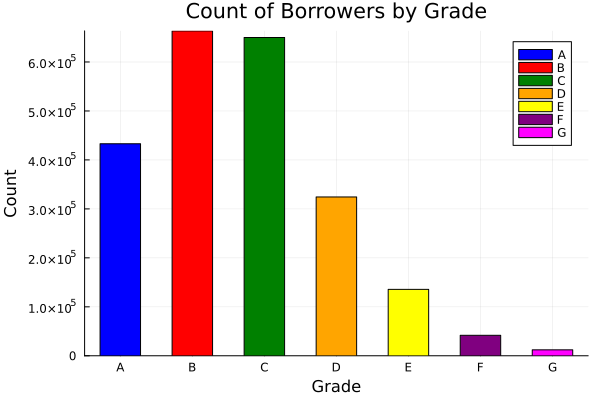

In [22]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Loan Grade
# ----------------------------------------------------------
# This script performs the following steps:
# 1. Counts the number of borrowers for each unique grade
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'grade' column
    counts = combine(groupby(df_final, :grade), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.grade,           # x-axis: unique grades
        counts.count,           # y-axis: counts
        group = counts.grade,   # group by grade for colors
        title = "Count of Borrowers by Grade",
        palette = custom_palette,
        xlabel = "Grade",
        ylabel = "Count",
        bar_labels = true       # Show counts on top of bars
    )

end


## Counting Unique Values in the emp_length Column

1) This script computes the frequency of each unique value in the :emp_length column of a DataFrame (df_final).
2) It groups the data by :emp_length and counts the number of rows in each group.
3) This helps in understanding the distribution of borrowers’ employment lengths, which can be important for exploratory data analysis and feature evaluation.

In [23]:
# ----------------------------------------------------------
# Counting Unique Values in the `emp_length` Column
# ----------------------------------------------------------
# This script calculates how many borrowers fall into each
# employment length category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'emp_length' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding categorical distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'emp_length' and count rows in each group
    value_counts = combine(groupby(df_final, :emp_length), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'emp_length':")
    println(value_counts)

end


📊 Value counts for 'emp_length':
12×2 DataFrame
 Row │ emp_length  count  
     │ String15    Int64  
─────┼────────────────────
   1 │ 10+ years   748005
   2 │ 6 years     102628
   3 │ 4 years     136605
   4 │ < 1 year    189988
   5 │ 2 years     203677
   6 │ 9 years      79395
   7 │ n/a         146907
   8 │ 5 years     139698
   9 │ 3 years     180753
  10 │ 7 years      92695
  11 │ 1 year      148403
  12 │ 8 years      91914
  0.240315 seconds (2.13 k allocations: 66.585 MiB)


## Bar Chart of Borrower Counts by Employment Length

1) This script plots the distribution of borrowers based on their employment length (emp_length) in df_final.
2) It counts occurrences of each unique value in :emp_length, applies a custom color palette, and generates a bar chart using StatsPlots.
3) This visualization helps in quickly understanding employment patterns among borrowers.

  0.142382 seconds (22.00 k allocations: 67.525 MiB, 43.07% gc time, 5.22% compilation time)


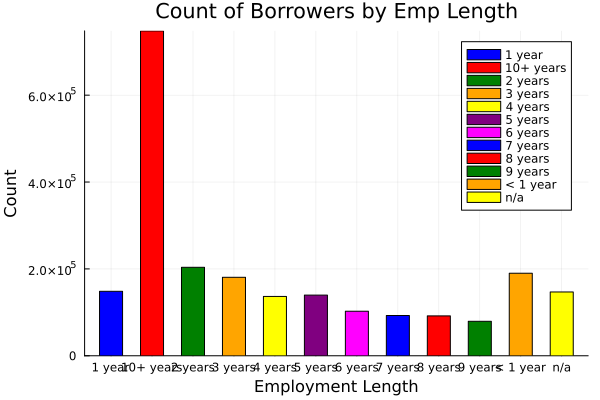

In [24]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Employment Length
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each unique employment length
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'emp_length' column
    counts = combine(groupby(df_final, :emp_length), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.emp_length,        # x-axis: unique employment lengths
        counts.count,             # y-axis: counts
        group = counts.emp_length,# group by employment length for colors
        title = "Count of Borrowers by Emp Length",
        palette = custom_palette,
        xlabel = "Employment Length",
        ylabel = "Count",
        bar_labels = true         # Show counts on top of bars
    )

end


## Counting Unique Values in the home_ownership Column

1) This script computes the frequency of each unique value in the :home_ownership column of a DataFrame (df_final).
2) By grouping the data by :home_ownership and counting rows per group, it helps analyze the distribution of borrowers’ home ownership status, which is often useful in exploratory data analysis and feature evaluation.

In [25]:
# ----------------------------------------------------------
# Counting Unique Values in the `home_ownership` Column
# ----------------------------------------------------------
# This script calculates how many borrowers fall into each
# home ownership category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'home_ownership' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding categorical distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'home_ownership' and count rows in each group
    value_counts = combine(groupby(df_final, :home_ownership), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'home_ownership':")
    println(value_counts)

end


📊 Value counts for 'home_ownership':
6×2 DataFrame
 Row │ home_ownership  count   
     │ String15        Int64   
─────┼─────────────────────────
   1 │ RENT             894929
   2 │ MORTGAGE        1111450
   3 │ OWN              253057
   4 │ ANY                 996
   5 │ NONE                 54
   6 │ OTHER               182
  0.207856 seconds (1.57 k allocations: 66.564 MiB)


## Bar Chart of Borrower Counts by Home Ownership

1) This script visualizes the distribution of borrowers based on their home ownership status in df_final.
2) It counts occurrences of each unique value in :home_ownership, applies a custom color palette, and plots a bar chart using StatsPlots.
3) This helps in quickly understanding categorical distributions and identifying the most common home ownership types among borrowers.

  0.069859 seconds (11.71 k allocations: 67.051 MiB)


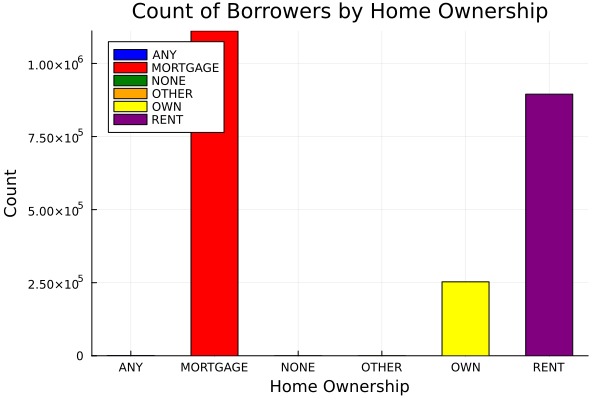

In [26]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Home Ownership
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each unique home ownership category
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'home_ownership' column
    counts = combine(groupby(df_final, :home_ownership), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.home_ownership,       # x-axis: unique home ownership categories
        counts.count,                # y-axis: counts
        group = counts.home_ownership,# group by category for colors
        title = "Count of Borrowers by Home Ownership",
        palette = custom_palette,
        xlabel = "Home Ownership",
        ylabel = "Count",
        bar_labels = true            # Show counts on top of bars
    )

end


## Counting Unique Values in the verification_status Column

1) This script computes the frequency of each unique value in the :verification_status column of a DataFrame (df_final).
2) By grouping the data by :verification_status and counting rows per group, it provides insight into how borrowers’ income verification is distributed, which is important for exploratory data analysis and feature assessment.

In [27]:
# ----------------------------------------------------------
# Counting Unique Values in the `verification_status` Column
# ----------------------------------------------------------
# This script calculates how many borrowers fall into each
# verification status category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'verification_status' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding categorical distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'verification_status' and count rows in each group
    value_counts = combine(groupby(df_final, :verification_status), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'verification_status':")
    println(value_counts)

end


📊 Value counts for 'verification_status':
3×2 DataFrame
 Row │ verification_status  count  
     │ String15             Int64  
─────┼─────────────────────────────
   1 │ Not Verified         744806
   2 │ Source Verified      886231
   3 │ Verified             629631
  0.239259 seconds (1.28 k allocations: 66.554 MiB, 21.48% gc time)


## Bar Chart of Borrower Counts by Verification Status

1) This script visualizes the distribution of borrowers based on their income verification status (verification_status) in df_final.
2) It counts occurrences of each unique value in the column, applies a custom color palette, and generates a bar chart using StatsPlots.
3) This helps in quickly identifying how borrowers’ verification statuses are distributed.

  0.077977 seconds (6.71 k allocations: 66.823 MiB)


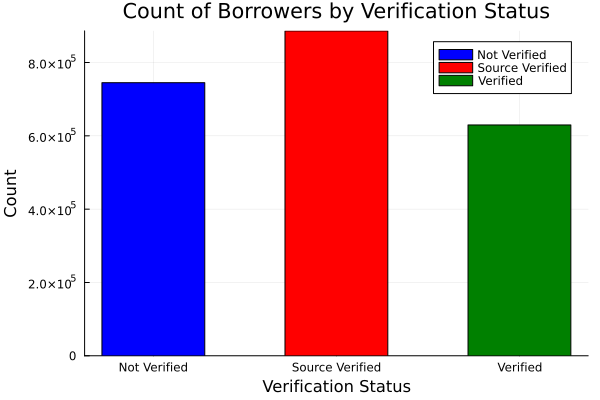

In [28]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Verification Status
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each verification status category
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'verification_status' column
    counts = combine(groupby(df_final, :verification_status), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.verification_status,      # x-axis: unique verification statuses
        counts.count,                    # y-axis: counts
        group = counts.verification_status, # group by category for colors
        title = "Count of Borrowers by Verification Status",
        palette = custom_palette,
        xlabel = "Verification Status",
        ylabel = "Count",
        bar_labels = true                # Show counts on top of bars
    )

end


## Counting Unique Values in the loan_status Column

1) This script computes the frequency of each unique value in the :loan_status column of a DataFrame (df_final).
2) By grouping the data by :loan_status and counting rows per group, it provides insight into the distribution of loan outcomes, which is useful for exploratory data analysis and understanding dataset balance.

In [30]:
# ----------------------------------------------------------
# Counting Unique Values in the `loan_status` Column
# ----------------------------------------------------------
# This script calculates how many loans fall into each
# loan status category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'loan_status' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding categorical distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'loan_status' and count rows in each group
    value_counts = combine(groupby(df_final, :loan_status), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'loan_status':")
    println(value_counts)

end


📊 Value counts for 'loan_status':
9×2 DataFrame
 Row │ loan_status                        count   
     │ String                             Int64   
─────┼────────────────────────────────────────────
   1 │ Current                             919695
   2 │ Fully Paid                         1041952
   3 │ Late (31-120 days)                   21897
   4 │ In Grace Period                       8952
   5 │ Charged Off                         261655
   6 │ Late (16-30 days)                     3737
   7 │ Default                                 31
   8 │ Does not meet the credit policy.…     1988
   9 │ Does not meet the credit policy.…      761
  0.520260 seconds (3.00 k allocations: 66.630 MiB, 4.95% compilation time)


## Bar Chart of Borrower Counts by Loan Status

1) This script visualizes the distribution of borrowers based on their loan status (loan_status) in df_final.
2) It counts occurrences of each unique value in the column, applies a custom color palette, and generates a bar chart using StatsPlots.
3) This helps in quickly understanding the loan outcome distribution, which is crucial for exploratory data analysis and modeling.

  0.388347 seconds (168.54 k allocations: 74.773 MiB, 9.71% gc time, 59.58% compilation time)


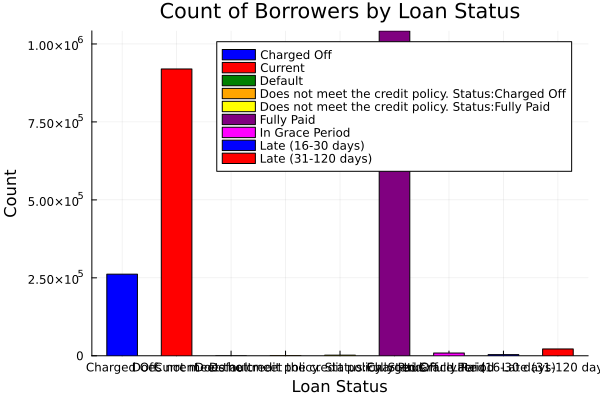

In [31]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Loan Status
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each loan status category
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# - Understanding dataset balance for modeling
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'loan_status' column
    counts = combine(groupby(df_final, :loan_status), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.loan_status,        # x-axis: unique loan statuses
        counts.count,              # y-axis: counts
        group = counts.loan_status,# group by category for colors
        title = "Count of Borrowers by Loan Status",
        palette = custom_palette,
        xlabel = "Loan Status",
        ylabel = "Count",
        bar_labels = true          # Show counts on top of bars
    )

end


## Counting Unique Values in the pymnt_plan Column

1) This script computes the frequency of each unique value in the :pymnt_plan column of a DataFrame (df_final).
2) By grouping the data by :pymnt_plan and counting rows per group, it provides insight into borrowers’ payment plan selections, which is useful for exploratory data analysis and understanding categorical feature distributions.

In [32]:
# ----------------------------------------------------------
# Counting Unique Values in the `pymnt_plan` Column
# ----------------------------------------------------------
# This script calculates how many borrowers are associated
# with each payment plan category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'pymnt_plan' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding categorical distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'pymnt_plan' and count rows in each group
    value_counts = combine(groupby(df_final, :pymnt_plan), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'pymnt_plan':")
    println(value_counts)

end


📊 Value counts for 'pymnt_plan':
2×2 DataFrame
 Row │ pymnt_plan  count   
     │ String1     Int64   
─────┼─────────────────────
   1 │ n           2259986
   2 │ y               682
  0.054677 seconds (1.19 k allocations: 66.549 MiB)


## Bar Chart of Borrower Counts by Payment Plan

1) This script visualizes the distribution of borrowers based on their payment plan (pymnt_plan) in df_final.
2) It counts occurrences of each unique value in the column, applies a custom color palette, and generates a bar chart using StatsPlots.
3) This helps in quickly understanding the frequency of each payment plan category, which is useful for exploratory data analysis.

  0.050022 seconds (5.04 k allocations: 66.746 MiB)


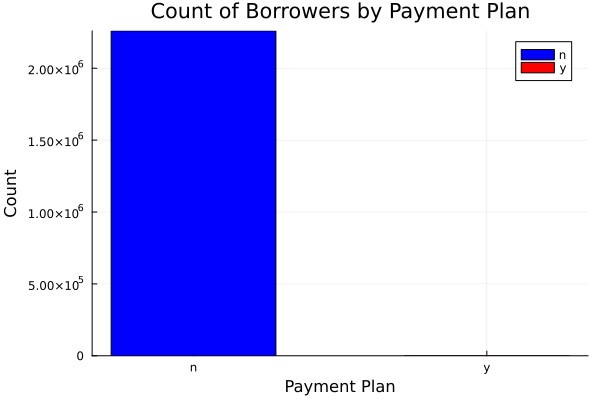

In [33]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Payment Plan
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each payment plan category
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'pymnt_plan' column
    counts = combine(groupby(df_final, :pymnt_plan), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.pymnt_plan,          # x-axis: unique payment plan categories
        counts.count,               # y-axis: counts
        group = counts.pymnt_plan,  # group by category for colors
        title = "Count of Borrowers by Payment Plan",
        palette = custom_palette,
        xlabel = "Payment Plan",
        ylabel = "Count",
        bar_labels = true           # Show counts on top of bars
    )

end


## Counting Unique Values in the purpose Column

1) This script computes the frequency of each unique value in the :purpose column of a DataFrame (df_final).
2) By grouping the data by :purpose and counting rows per group, it provides insight into borrowers’ loan purposes, which is useful for exploratory data analysis and understanding feature distributions.

In [35]:
# ----------------------------------------------------------
# Counting Unique Values in the `purpose` Column
# ----------------------------------------------------------
# This script calculates how many borrowers fall into each
# loan purpose category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'purpose' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding categorical distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'purpose' and count rows in each group
    value_counts = combine(groupby(df_final, :purpose), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'purpose':")
    println(value_counts)

end


📊 Value counts for 'purpose':
14×2 DataFrame
 Row │ purpose             count   
     │ String31            Int64   
─────┼─────────────────────────────
   1 │ debt_consolidation  1277877
   2 │ credit_card          516971
   3 │ house                 14136
   4 │ car                   24013
   5 │ other                139440
   6 │ vacation              15525
   7 │ home_improvement     150457
   8 │ small_business        24689
   9 │ major_purchase        50445
  10 │ medical               27488
  11 │ renewable_energy       1445
  12 │ moving                15403
  13 │ wedding                2355
  14 │ educational             424
  0.635970 seconds (187.54 k allocations: 76.059 MiB, 12.35% gc time, 42.13% compilation time)


## Bar Chart of Borrower Counts by Loan Purpose

1) This script visualizes the distribution of borrowers based on their loan purpose (purpose) in df_final.
2) It counts occurrences of each unique value in the column, applies a custom color palette, and generates a bar chart using StatsPlots.
3) This helps in quickly understanding which loan purposes are most common among borrowers, aiding exploratory data analysis.

  1.221823 seconds (900.80 k allocations: 111.829 MiB, 93.07% compilation time)


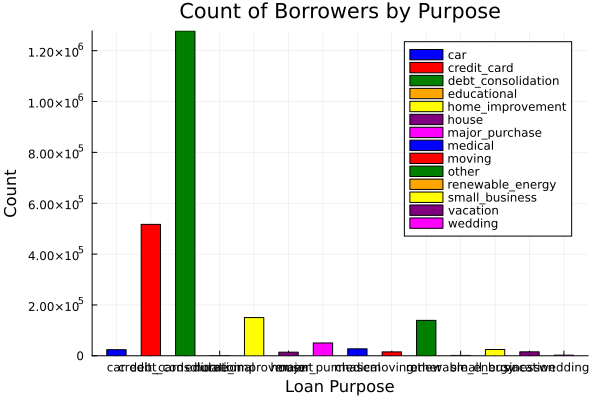

In [36]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Loan Purpose
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each loan purpose category
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'purpose' column
    counts = combine(groupby(df_final, :purpose), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.purpose,           # x-axis: unique loan purposes
        counts.count,             # y-axis: counts
        group = counts.purpose,   # group by purpose for colors
        title = "Count of Borrowers by Purpose",
        palette = custom_palette,
        xlabel = "Loan Purpose",
        ylabel = "Count",
        bar_labels = true         # Show counts on top of bars
    )

end


## Counting Unique Values in the addr_state Column

1) This script computes the frequency of borrowers from each state (addr_state) in the DataFrame df_final.
2) By grouping the data by :addr_state and counting the number of rows per group, it provides insight into the geographical distribution of borrowers, which is useful for exploratory data analysis and identifying regional trends.

In [37]:
# ----------------------------------------------------------
# Counting Unique Values in the `addr_state` Column
# ----------------------------------------------------------
# This script calculates how many borrowers belong to each
# state in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'addr_state' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding the geographical distribution of borrowers.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'addr_state' and count rows in each group
    value_counts = combine(groupby(df_final, :addr_state), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'addr_state':")
    println(value_counts)

end


📊 Value counts for 'addr_state':
51×2 DataFrame
 Row │ addr_state  count  
     │ String3     Int64  
─────┼────────────────────
   1 │ NY          186389
   2 │ LA           25759
   3 │ MI           58770
   4 │ WA           47060
   5 │ MD           54008
   6 │ IN           37515
   7 │ IL           91173
   8 │ FL          161991
   9 │ CT           35785
  10 │ GA           74196
  11 │ UT           14993
  12 │ NC           62730
  13 │ KY           21887
  14 │ OH           75132
  15 │ AR           17074
  16 │ OK           20691
  17 │ CA          314533
  18 │ WV            8351
  19 │ NJ           83132
  20 │ SC           28003
  21 │ TX          186335
  22 │ PA           76939
  23 │ KS           19109
  24 │ AL           27284
  25 │ VA           62954
  26 │ MO           36084
  27 │ AZ           53777
  28 │ NM           11986
  29 │ CO           48183
  30 │ RI           10005
  31 │ WI           29877
  32 │ TN           35483
  33 │ NV           32657
  34 │ MA    

## Bar Chart of Borrower Counts by Address State

1) This script visualizes the distribution of borrowers across different states (addr_state) in df_final.
2) It counts occurrences of each unique state, applies a custom color palette, and plots a bar chart using StatsPlots.
3) This helps in quickly understanding the geographical distribution of borrowers, which is useful for exploratory data analysis and identifying regional trends.

  0.142507 seconds (86.78 k allocations: 70.503 MiB, 51.10% gc time)


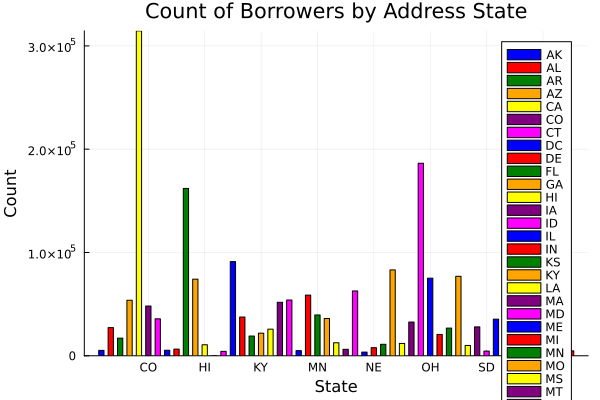

In [38]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Address State
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers in each state
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing geographical distributions of borrowers
# - Quick exploratory data analysis
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'addr_state' column
    counts = combine(groupby(df_final, :addr_state), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.addr_state,         # x-axis: unique states
        counts.count,              # y-axis: counts
        group = counts.addr_state, # group by state for colors
        title = "Count of Borrowers by Address State",
        palette = custom_palette,
        xlabel = "State",
        ylabel = "Count",
        bar_labels = true          # Show counts on top of bars
    )

end


## Counting Unique Values in the initial_list_status Column

1) This script computes the frequency of each unique value in the :initial_list_status column of a DataFrame (df_final).
2) By grouping the data by :initial_list_status and counting rows per group, it provides insight into how borrowers’ loans were initially listed, which is useful for exploratory data analysis and understanding feature distributions.

In [39]:
# ----------------------------------------------------------
# Counting Unique Values in the `initial_list_status` Column
# ----------------------------------------------------------
# This script calculates how many loans fall into each
# initial listing status category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'initial_list_status' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding loan listing distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'initial_list_status' and count rows in each group
    value_counts = combine(groupby(df_final, :initial_list_status), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'initial_list_status':")
    println(value_counts)

end


📊 Value counts for 'initial_list_status':
2×2 DataFrame
 Row │ initial_list_status  count   
     │ String1              Int64   
─────┼──────────────────────────────
   1 │ w                    1535467
   2 │ f                     725201
  0.074074 seconds (1.19 k allocations: 66.549 MiB)


## Bar Chart of Borrower Counts by Initial List Status

1) This script visualizes the distribution of borrowers based on their initial listing status (initial_list_status) in df_final.
2) It counts occurrences of each unique value in the column, applies a custom color palette, and generates a bar chart using StatsPlots.
3) This helps in quickly understanding how loans were initially categorized or listed, which is useful for exploratory data analysis and feature assessment.

  0.047341 seconds (5.04 k allocations: 66.747 MiB)


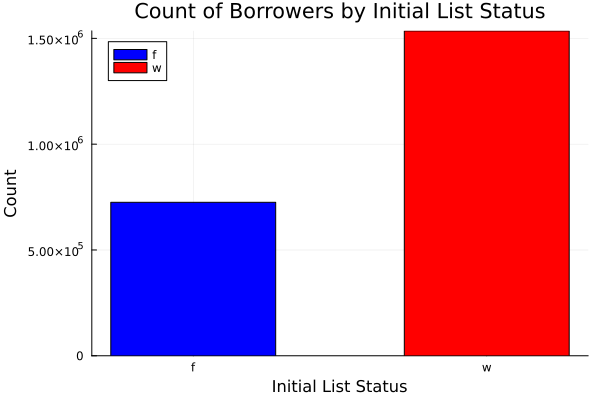

In [40]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Initial List Status
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each initial list status category
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# - Understanding initial loan listing patterns
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'initial_list_status' column
    counts = combine(groupby(df_final, :initial_list_status), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.initial_list_status,    # x-axis: unique initial list statuses
        counts.count,                  # y-axis: counts
        group = counts.initial_list_status, # group by status for colors
        title = "Count of Borrowers by Initial List Status",
        palette = custom_palette,
        xlabel = "Initial List Status",
        ylabel = "Count",
        bar_labels = true              # Show counts on top of bars
    )

end


## Counting Unique Values in the application_type Column

1) This script computes the frequency of each unique value in the :application_type column of a DataFrame (df_final).
2) By grouping the data by :application_type and counting rows per group, it provides insight into the type of loan applications (e.g., individual vs. joint), which is useful for exploratory data analysis and understanding categorical feature distributions.

In [41]:
# ----------------------------------------------------------
# Counting Unique Values in the `application_type` Column
# ----------------------------------------------------------
# This script calculates how many loans fall into each
# application type category in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'application_type' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding loan application type distributions for analysis or modeling.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'application_type' and count rows in each group
    value_counts = combine(groupby(df_final, :application_type), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'application_type':")
    println(value_counts)

end


📊 Value counts for 'application_type':
2×2 DataFrame
 Row │ application_type  count   
     │ String15          Int64   
─────┼───────────────────────────
   1 │ Individual        2139958
   2 │ Joint App          120710
  0.152766 seconds (1.19 k allocations: 66.550 MiB, 32.64% gc time)


## Bar Chart of Borrower Counts by Application Type

1) This script visualizes the distribution of borrowers based on their application type (application_type) in df_final.
2) It counts occurrences of each unique value, applies a custom color palette, and generates a bar chart using StatsPlots.
3) This helps in quickly understanding the composition of loan applications (e.g., individual vs. joint), which is useful for exploratory data analysis and feature evaluation.

  0.069469 seconds (5.04 k allocations: 66.747 MiB)


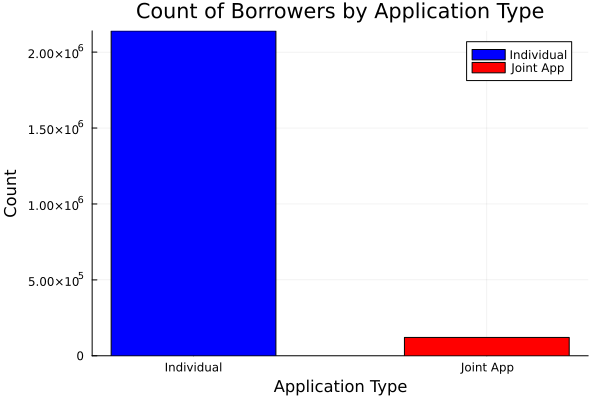

In [42]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Application Type
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each application type category
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions
# - Quick exploratory data analysis
# - Understanding loan application types
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'application_type' column
    counts = combine(groupby(df_final, :application_type), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.application_type,       # x-axis: unique application types
        counts.count,                  # y-axis: counts
        group = counts.application_type, # group by type for colors
        title = "Count of Borrowers by Application Type",
        palette = custom_palette,
        xlabel = "Application Type",
        ylabel = "Count",
        bar_labels = true              # Show counts on top of bars
    )

end


## Counting Unique Values in the disbursement_method Column

1) This script computes the frequency of each unique value in the :disbursement_method column of the DataFrame df_final.
2) By grouping the data by :disbursement_method and counting rows per group, it provides insight into the methods used to disburse loans (e.g., direct deposit, check), which is useful for exploratory data analysis and understanding feature distributions.

In [43]:
# ----------------------------------------------------------
# Counting Unique Values in the `disbursement_method` Column
# ----------------------------------------------------------
# This script calculates how many loans were disbursed using
# each disbursement method in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'disbursement_method' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding loan disbursement patterns.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'disbursement_method' and count rows in each group
    value_counts = combine(groupby(df_final, :disbursement_method), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'disbursement_method':")
    println(value_counts)

end


📊 Value counts for 'disbursement_method':
2×2 DataFrame
 Row │ disbursement_method  count   
     │ String15             Int64   
─────┼──────────────────────────────
   1 │ Cash                 2182546
   2 │ DirectPay              78122
  0.100104 seconds (1.18 k allocations: 66.549 MiB)


## Bar Chart of Borrower Counts by Disbursement Method

1) This script visualizes the distribution of borrowers based on their loan disbursement method (disbursement_method) in df_final.
2) It counts occurrences of each unique value, applies a custom color palette, and generates a bar chart using StatsPlots.
3) This helps in quickly understanding the methods through which loans are disbursed, which is useful for exploratory data analysis and operational insights.

  0.088560 seconds (5.04 k allocations: 66.747 MiB, 39.30% gc time)


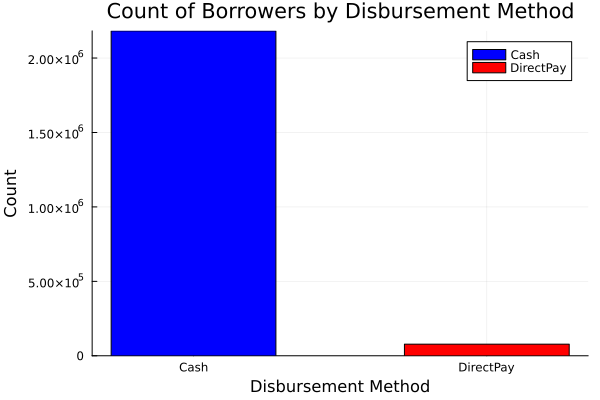

In [44]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Disbursement Method
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each disbursement method
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions of loan disbursement
# - Quick exploratory data analysis
# - Understanding operational loan patterns
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'disbursement_method' column
    counts = combine(groupby(df_final, :disbursement_method), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.disbursement_method,     # x-axis: unique disbursement methods
        counts.count,                   # y-axis: counts
        group = counts.disbursement_method, # group by method for colors
        title = "Count of Borrowers by Disbursement Method",
        palette = custom_palette,
        xlabel = "Disbursement Method",
        ylabel = "Count",
        bar_labels = true               # Show counts on top of bars
    )

end


## Counting Unique Values in the hardship_flag Column

1) This script computes the frequency of each unique value in the :hardship_flag column of a DataFrame (df_final).
2) By grouping the data by :hardship_flag and counting rows per group, it provides insight into how many borrowers have reported a financial hardship, which is useful for exploratory data analysis and assessing risk-related features.

In [45]:
# ----------------------------------------------------------
# Counting Unique Values in the `hardship_flag` Column
# ----------------------------------------------------------
# This script calculates how many borrowers have each
# hardship flag status in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'hardship_flag' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding the distribution of hardship flags in the dataset.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'hardship_flag' and count rows in each group
    value_counts = combine(groupby(df_final, :hardship_flag), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'hardship_flag':")
    println(value_counts)

end


📊 Value counts for 'hardship_flag':
2×2 DataFrame
 Row │ hardship_flag  count   
     │ String1        Int64   
─────┼────────────────────────
   1 │ N              2259783
   2 │ Y                  885
  0.060119 seconds (1.19 k allocations: 66.549 MiB)


## Bar Chart of Borrower Counts by Hardship Flag

1) This script visualizes the distribution of borrowers based on the hardship_flag in df_final.
2) It counts occurrences of each unique value, applies a custom color palette, and plots a bar chart using StatsPlots.
3) This helps in quickly understanding how many borrowers have reported financial hardship, which is useful for exploratory data analysis and risk assessment.

  0.046235 seconds (5.04 k allocations: 66.746 MiB)


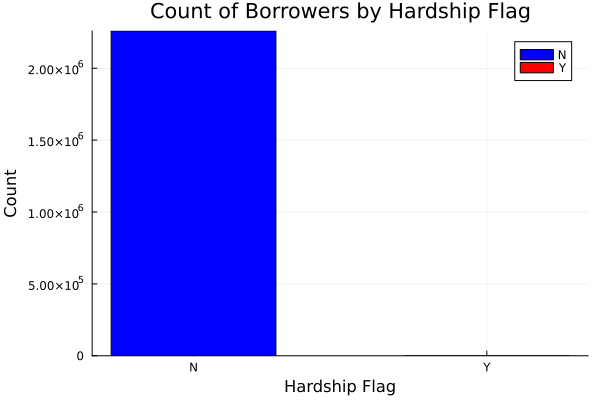

In [46]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Hardship Flag
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each hardship flag status
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions of hardship flags
# - Quick exploratory data analysis
# - Assessing risk-related features
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'hardship_flag' column
    counts = combine(groupby(df_final, :hardship_flag), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.hardship_flag,          # x-axis: unique hardship flag values
        counts.count,                  # y-axis: counts
        group = counts.hardship_flag,  # group by flag for colors
        title = "Count of Borrowers by Hardship Flag",
        palette = custom_palette,
        xlabel = "Hardship Flag",
        ylabel = "Count",
        bar_labels = true              # Show counts on top of bars
    )

end


## Counting Unique Values in the debt_settlement_flag Column

1) This script computes the frequency of each unique value in the :debt_settlement_flag column of a DataFrame (df_final).
2) By grouping the data by :debt_settlement_flag and counting rows per group, it provides insight into how many borrowers have opted for debt settlement, which is useful for exploratory data analysis, risk assessment, and understanding borrower behavior.

In [48]:
# ----------------------------------------------------------
# Counting Unique Values in the `debt_settlement_flag` Column
# ----------------------------------------------------------
# This script calculates how many borrowers have each
# debt settlement flag status in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'debt_settlement_flag' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for understanding the distribution of debt settlement flags in the dataset.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'debt_settlement_flag' and count rows in each group
    value_counts = combine(groupby(df_final, :debt_settlement_flag), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'debt_settlement_flag':")
    println(value_counts)

end


📊 Value counts for 'debt_settlement_flag':
2×2 DataFrame
 Row │ debt_settlement_flag  count   
     │ String1               Int64   
─────┼───────────────────────────────
   1 │ N                     2227612
   2 │ Y                       33056
  0.079623 seconds (1.18 k allocations: 66.549 MiB, 35.89% gc time)


## Bar Chart of Borrower Counts by Debt Settlement Flag

1) This script visualizes the distribution of borrowers based on the debt_settlement_flag in df_final.
2) It counts occurrences of each unique value, applies a custom color palette, and plots a bar chart using StatsPlots.
3) This helps in quickly understanding how many borrowers have opted for debt settlement, which is useful for exploratory data analysis and risk assessment.

  0.047422 seconds (5.04 k allocations: 66.746 MiB)


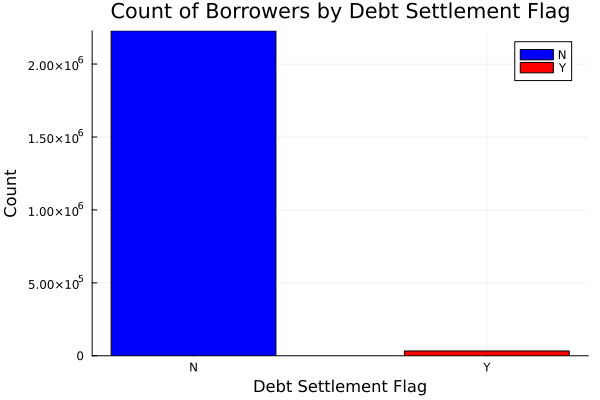

In [49]:
# ----------------------------------------------------------
# Bar Chart of Borrower Counts by Debt Settlement Flag
# ----------------------------------------------------------
# This script performs the following:
# 1. Counts the number of borrowers for each debt settlement flag status
# 2. Defines a custom color palette for the bars
# 3. Plots a bar chart using StatsPlots
#
# Useful for:
# - Visualizing categorical distributions of debt settlement flags
# - Quick exploratory data analysis
# - Understanding borrower repayment behavior
# ----------------------------------------------------------

@time begin

    using Plots, StatsPlots, DataFrames

    # Use GR backend for plotting
    gr()

    # Count the occurrences of each unique value in the 'debt_settlement_flag' column
    counts = combine(groupby(df_final, :debt_settlement_flag), nrow => :count)

    # Define a custom color palette for the bars
    custom_palette = [:blue, :red, :green, :orange, :yellow, :purple, :magenta]

    # Plot a bar chart
    bar(
        counts.debt_settlement_flag,     # x-axis: unique debt settlement flag values
        counts.count,                    # y-axis: counts
        group = counts.debt_settlement_flag, # group by flag for colors
        title = "Count of Borrowers by Debt Settlement Flag",
        palette = custom_palette,
        xlabel = "Debt Settlement Flag",
        ylabel = "Count",
        bar_labels = true                # Show counts on top of bars
    )

end


## Counting Unique Values in the issue_d Column

1) This script computes the frequency of each unique value in the :issue_d column of a DataFrame (df_final).
2) By grouping the data by :issue_d and counting rows per group, it provides insight into the loan issue dates, which is useful for exploratory data analysis, time-based trend analysis, and understanding loan issuance patterns over time.

In [50]:
# ----------------------------------------------------------
# Counting Unique Values in the `issue_d` Column
# ----------------------------------------------------------
# This script calculates how many loans were issued on each
# date/month in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'issue_d' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for analyzing loan issuance trends over time.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'issue_d' and count rows in each group
    value_counts = combine(groupby(df_final, :issue_d), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'issue_d':")
    println(value_counts)

end


📊 Value counts for 'issue_d':
139×2 DataFrame
 Row │ issue_d   count 
     │ String15  Int64 
─────┼─────────────────
   1 │ Dec-2018  40134
   2 │ Nov-2018  41973
   3 │ Oct-2018  46305
   4 │ Sep-2018  39026
   5 │ Aug-2018  46079
   6 │ Jul-2018  43089
   7 │ Jun-2018  41533
   8 │ May-2018  46311
   9 │ Apr-2018  42928
  10 │ Mar-2018  38771
  11 │ Feb-2018  32746
  12 │ Jan-2018  36347
  13 │ Sep-2016  28144
  14 │ Aug-2016  36280
  15 │ Jul-2016  34696
  16 │ Jun-2016  33019
  17 │ May-2016  28403
  18 │ Apr-2016  36432
  19 │ Mar-2016  61992
  20 │ Feb-2016  39529
  21 │ Jan-2016  32366
  22 │ Dec-2016  36183
  23 │ Nov-2016  34591
  24 │ Oct-2016  32772
  25 │ Dec-2015  44343
  26 │ Nov-2015  37530
  27 │ Oct-2015  48631
  28 │ Sep-2015  28641
  29 │ Aug-2015  35886
  30 │ Jul-2015  45962
  31 │ Jun-2015  28485
  32 │ May-2015  31913
  33 │ Apr-2015  35427
  34 │ Mar-2015  25400
  35 │ Feb-2015  23770
  36 │ Jan-2015  35107
  37 │ Mar-2017  37181
  38 │ Feb-2017  27763
  39 │ J

## Converting the issue_d Column to Date Format

1) This script converts the issue_d column in df_final from a string to a Date type in Julia.
2) Converting date columns allows for proper time-based analysis, sorting, filtering, and plotting.
3) This step is crucial when performing temporal analyses, such as studying loan issuance trends over months or years.

In [52]:
@time begin
using DataFrames, Dates

# Function to parse 'issue_d' robustly
function parse_issue_d(date_str::AbstractString)
    date_str = strip(date_str)  # Remove leading/trailing whitespace
    try
        # Case 1: Month abbrev + Year, e.g., "Jan-2015"
        return Date(date_str, dateformat"u-y")
    catch
        # Case 2: Year-Month numeric, e.g., "2015-01"
        return Date(date_str * "-01", dateformat"y-m-d")  # Append day for full date
    end
end

# Apply the function to the 'issue_d' column
df_final.issue_d = parse_issue_d.(df_final.issue_d)

# Verify the first few converted dates
println(first(df_final.issue_d, 5))
end


[Date("2018-12-01"), Date("2018-12-01"), Date("2018-12-01"), Date("2018-12-01"), Date("2018-12-01")]
  2.609261 seconds (7.71 M allocations: 340.627 MiB, 4.83% gc time, 45.28% compilation time)


## Counting Unique Values in the last_pymnt_d Column

1) This script computes the frequency of each unique value in the :last_pymnt_d column of a DataFrame (df_final).
2) By grouping the data by :last_pymnt_d and counting rows per group, it provides insight into the distribution of last payment dates, which is useful for exploratory data analysis, tracking loan repayment activity, and identifying temporal patterns in payments.

In [53]:
# ----------------------------------------------------------
# Counting Unique Values in the `last_pymnt_d` Column
# ----------------------------------------------------------
# This script calculates how many loans had each last payment
# date in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'last_pymnt_d' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for analyzing repayment patterns and temporal trends.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'last_pymnt_d' and count rows in each group
    value_counts = combine(groupby(df_final, :last_pymnt_d), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'last_pymnt_d':")
    println(value_counts)

end


📊 Value counts for 'last_pymnt_d':
136×2 DataFrame
 Row │ last_pymnt_d  count  
     │ String15?     Int64  
─────┼──────────────────────
   1 │ Feb-2019      934725
   2 │ Jan-2019       52576
   3 │ missing         2426
   4 │ Dec-2018       33451
   5 │ Nov-2018       35714
   6 │ Oct-2018       37468
   7 │ Sep-2018       31344
   8 │ Aug-2018       39615
   9 │ Jul-2018       36497
  10 │ Jun-2018       35168
  11 │ May-2018       33456
  12 │ Apr-2018       31826
  13 │ Mar-2018       38269
  14 │ Feb-2018       31178
  15 │ Jan-2018       33166
  16 │ Oct-2017       32133
  17 │ Apr-2017       25822
  18 │ Jan-2017       25053
  19 │ Aug-2017       32052
  20 │ Dec-2017       26619
  21 │ Nov-2017       31354
  22 │ Nov-2016       22764
  23 │ May-2017       28535
  24 │ Jul-2017       30244
  25 │ Mar-2017       32795
  26 │ Jun-2017       29757
  27 │ Feb-2017       24362
  28 │ Oct-2016       22937
  29 │ Sep-2017       26750
  30 │ Dec-2016       23822
  31 │ Sep-2016       

## Converting the last_pymnt_d Column to Date Format

1) This script converts the last_pymnt_d column in df_final from string to Date.
2) It also safely handles missing values by preserving them as missing. Converting this column enables temporal analysis of loan repayments, sorting, filtering, and plotting time-series trends for last payments.

In [54]:
# ----------------------------------------------------------
# Converting the `last_pymnt_d` Column to Date Format
# ----------------------------------------------------------
# This script performs the following:
# 1. Iterates over each value in 'last_pymnt_d'
# 2. Strips whitespace from the string
# 3. Converts valid strings to Date objects using the format "u-y"
# 4. Preserves missing values
#
# Useful for:
# - Analyzing repayment trends over time
# - Sorting or filtering by last payment date
# - Creating temporal visualizations
# ----------------------------------------------------------

@time begin
    using DataFrames, Dates

    # Convert 'last_pymnt_d' column to Date, handling missing values
    df_final.last_pymnt_d = [ismissing(x) ? missing : Date(strip(x), dateformat"u-y") for x in df_final.last_pymnt_d]

    # Verify the first few converted dates
    println(first(df_final.last_pymnt_d, 5))
end


Union{Missing, Date}[Date("2019-02-01"), Date("2019-02-01"), Date("2019-02-01"), Date("2019-02-01"), Date("2019-02-01")]
  1.373031 seconds (7.41 M allocations: 346.359 MiB, 4.98% gc time, 48.46% compilation time)


## Counting Unique Values in the next_pymnt_d Column

1) This script computes the frequency of each unique value in the :next_pymnt_d column of a DataFrame (df_final).
2) By grouping the data by :next_pymnt_d and counting rows per group, it provides insight into the distribution of scheduled next payment dates, which is useful for exploratory data analysis, loan repayment forecasting, and tracking future cash flow patterns.

In [55]:
# ----------------------------------------------------------
# Counting Unique Values in the `next_pymnt_d` Column
# ----------------------------------------------------------
# This script calculates how many loans have each scheduled
# next payment date in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'next_pymnt_d' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for analyzing upcoming repayment schedules and trends.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'next_pymnt_d' and count rows in each group
    value_counts = combine(groupby(df_final, :next_pymnt_d), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'next_pymnt_d':")
    println(value_counts)

end


📊 Value counts for 'next_pymnt_d':
106×2 DataFrame
 Row │ next_pymnt_d  count   
     │ String15?     Int64   
─────┼───────────────────────
   1 │ Mar-2019       953821
   2 │ missing       1303607
   3 │ Feb-2019          406
   4 │ Apr-2019           78
   5 │ Dec-2018            3
   6 │ Sep-2018            2
   7 │ Aug-2018            1
   8 │ Feb-2018            1
   9 │ Jan-2016            7
  10 │ Sep-2013           18
  11 │ Feb-2016            3
  12 │ Feb-2014           10
  13 │ May-2014            6
  14 │ Jun-2013           32
  15 │ Mar-2012           48
  16 │ Apr-2012           49
  17 │ May-2013           42
  18 │ Aug-2012           31
  19 │ Aug-2013           22
  20 │ Jun-2012           40
  21 │ Nov-2013           26
  22 │ Feb-2012           26
  23 │ Oct-2011           47
  24 │ Jan-2013           29
  25 │ Jan-2014           18
  26 │ Jul-2013           19
  27 │ Jul-2015            8
  28 │ Jan-2012           45
  29 │ Dec-2012           36
  30 │ Jun-2011   

## Converting the next_pymnt_d Column to Date Format

1) This script converts the next_pymnt_d column in df_final from string to Date, preserving missing values.
2) Converting this column allows for temporal analysis of scheduled payments, sorting, filtering, and plotting future payment trends, which is critical for cash flow forecasting and risk assessment.

In [56]:
# ----------------------------------------------------------
# Converting the `next_pymnt_d` Column to Date Format
# ----------------------------------------------------------
# This script performs the following:
# 1. Iterates over each value in 'next_pymnt_d'
# 2. Strips whitespace from the string
# 3. Converts valid strings to Date objects using the format "u-y"
# 4. Preserves missing values
#
# Useful for:
# - Analyzing scheduled repayment trends over time
# - Sorting or filtering by next payment date
# - Creating temporal visualizations for future cash flows
# ----------------------------------------------------------

@time begin
    using DataFrames, Dates

    # Convert 'next_pymnt_d' column to Date, handling missing values
    df_final.next_pymnt_d = [ismissing(x) ? missing : Date(strip(x), dateformat"u-y") for x in df_final.next_pymnt_d]

    # Verify the first few converted dates
    println(first(df_final.next_pymnt_d, 5))
end


Union{Missing, Date}[Date("2019-03-01"), Date("2019-03-01"), Date("2019-03-01"), Date("2019-03-01"), Date("2019-03-01")]
  0.595992 seconds (2.93 M allocations: 156.700 MiB, 9.83% gc time, 35.92% compilation time)


## Counting Unique Values in the last_credit_pull_d Column

1) This script computes the frequency of each unique value in the :last_credit_pull_d column of the df_final DataFrame.
2) By grouping the data by :last_credit_pull_d and counting rows per group, it provides insight into the distribution of borrowers’ last credit pull dates, which is useful for exploratory data analysis, monitoring credit inquiry patterns, and identifying temporal trends in borrower behavior.

In [58]:
# ----------------------------------------------------------
# Counting Unique Values in the `last_credit_pull_d` Column
# ----------------------------------------------------------
# This script calculates how many borrowers had each last credit
# pull date in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'last_credit_pull_d' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for analyzing credit inquiry patterns and temporal trends.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'last_credit_pull_d' and count rows in each group
    value_counts = combine(groupby(df_final, :last_credit_pull_d), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'last_credit_pull_d':")
    println(value_counts)

end


📊 Value counts for 'last_credit_pull_d':
141×2 DataFrame
 Row │ last_credit_pull_d  count   
     │ String15?           Int64   
─────┼─────────────────────────────
   1 │ Feb-2019            1398266
   2 │ Jan-2019              78011
   3 │ Dec-2018              52077
   4 │ missing                  73
   5 │ Nov-2018              48552
   6 │ Oct-2018              51366
   7 │ Sep-2018              36225
   8 │ Aug-2018              45958
   9 │ Jul-2018              56612
  10 │ Jun-2018               9968
  11 │ May-2018              26685
  12 │ Apr-2018              25494
  13 │ Mar-2018              25092
  14 │ Feb-2018              22184
  15 │ Jan-2018              22535
  16 │ Dec-2017              17437
  17 │ Nov-2017              19230
  18 │ Aug-2017              17056
  19 │ Jul-2017              15267
  20 │ Jun-2017              16014
  21 │ Mar-2017              13384
  22 │ Sep-2016               2243
  23 │ May-2017              10574
  24 │ Sep-2017              1

## Converting the last_credit_pull_d Column to Date Format

1) This script converts the last_credit_pull_d column in df_final from string to Date.
2) Missing values are preserved as missing. Converting this column enables temporal analysis of credit pulls, sorting, filtering, and plotting time-series trends to monitor borrower credit behavior.

In [59]:
# ----------------------------------------------------------
# Converting the `last_credit_pull_d` Column to Date Format
# ----------------------------------------------------------
# This script performs the following:
# 1. Iterates over each value in 'last_credit_pull_d'
# 2. Strips whitespace from the string
# 3. Converts valid strings to Date objects using the format "u-y"
# 4. Preserves missing values
#
# Useful for:
# - Analyzing trends in borrowers' credit pull activity
# - Sorting or filtering by last credit pull date
# - Creating temporal visualizations
# ----------------------------------------------------------

@time begin
    using DataFrames, Dates

    # Convert 'last_credit_pull_d' column to Date, handling missing values
    df_final.last_credit_pull_d = [ismissing(x) ? missing : Date(strip(x), dateformat"u-y") for x in df_final.last_credit_pull_d]

    # Verify the first few converted dates
    println(first(df_final.last_credit_pull_d, 5))
end


Union{Missing, Date}[Date("2019-02-01"), Date("2019-02-01"), Date("2019-02-01"), Date("2019-02-01"), Date("2019-02-01")]
  0.755393 seconds (6.84 M allocations: 315.822 MiB, 7.42% gc time, 16.35% compilation time)


## Counting Unique Values in the earliest_cr_line Column

1) This script computes the frequency of each unique value in the :earliest_cr_line column of df_final.
2) By grouping the data by :earliest_cr_line and counting rows per group, it provides insight into the earliest credit line dates of borrowers, which is useful for analyzing credit history patterns, borrower seniority, and trends in credit experience over time.

In [60]:
# ----------------------------------------------------------
# Counting Unique Values in the `earliest_cr_line` Column
# ----------------------------------------------------------
# This script calculates how many borrowers had each earliest
# credit line date in `df_final`.
#
# Steps:
# 1. Group the DataFrame by the 'earliest_cr_line' column
# 2. Count the number of rows in each group
# 3. Combine results into a new DataFrame
# 4. Print the value counts
#
# Useful for analyzing borrowers' credit history and temporal trends.
# ----------------------------------------------------------

@time begin

    using DataFrames

    # Group by 'earliest_cr_line' and count rows in each group
    value_counts = combine(groupby(df_final, :earliest_cr_line), nrow => :count)

    # Display the counts
    println("📊 Value counts for 'earliest_cr_line':")
    println(value_counts)

end


📊 Value counts for 'earliest_cr_line':
755×2 DataFrame
 Row │ earliest_cr_line  count 
     │ String15?         Int64 
─────┼─────────────────────────
   1 │ Apr-2001          10400
   2 │ Jun-1987           2312
   3 │ Apr-2011           2880
   4 │ Feb-2006           9453
   5 │ Dec-2000          10609
   6 │ Sep-2002          13823
   7 │ Nov-2004          12527
   8 │ Nov-1997           8569
   9 │ Aug-1998           9505
  10 │ Apr-2002          10510
  11 │ May-2007           8155
  12 │ Dec-2003          10943
  13 │ Jun-2003          10890
  14 │ Oct-2008           4678
  15 │ Jul-1990           3228
  16 │ Dec-1988           2569
  17 │ Dec-2002          10398
  18 │ Oct-2010           3512
  19 │ Jul-2005          11075
  20 │ Feb-2001           9127
  21 │ Dec-2004          11371
  22 │ Oct-2001          13424
  23 │ Sep-2003          15215
  24 │ Oct-2004          13602
  25 │ Sep-2010           4867
  26 │ Oct-1999          11665
  27 │ Feb-1997           5862
  28 │ Jan-1

## Converting the earliest_cr_line Column to Date Format

1) This script converts the earliest_cr_line column in df_final from string to Date, while preserving missing values and leaving already-converted Date objects unchanged.
2) This ensures that the column is ready for temporal analysis of borrowers’ credit history, sorting, filtering, and visualizing credit experience trends.

In [61]:
# ----------------------------------------------------------
# Converting the `earliest_cr_line` Column to Date Format
# ----------------------------------------------------------
# This script performs the following:
# 1. Iterates over each value in 'earliest_cr_line'
# 2. Checks if the value is missing; if so, keeps it as missing
# 3. If the value is already a Date, it remains unchanged
# 4. Otherwise, converts string values to Date using format "u-y"
#
# Useful for:
# - Analyzing borrowers' credit history over time
# - Sorting or filtering by earliest credit line
# - Creating temporal visualizations for credit experience
# ----------------------------------------------------------

@time begin
    using DataFrames, Dates

    # Convert 'earliest_cr_line' column to Date, handling missing values and existing Date objects
    df_final.earliest_cr_line = [ismissing(x) ? missing :
                                 (x isa Date ? x : Date(strip(x), dateformat"u-y"))
                                 for x in df_final.earliest_cr_line]

    # Verify the first few converted dates
    println(first(df_final.earliest_cr_line, 5))
end


Union{Missing, Date}[Date("2001-04-01"), Date("1987-06-01"), Date("2011-04-01"), Date("2006-02-01"), Date("2000-12-01")]
  0.794736 seconds (6.84 M allocations: 315.834 MiB, 7.49% gc time, 15.50% compilation time)


## Selecting Only Integer (Int64) Columns from the DataFrame

1) This script extracts all columns of type Int64 from df_final into a new DataFrame (int_columns).
2) This is useful when you want to focus analysis on numeric integer features, such as counts, scores, or other discrete numeric variables, while ignoring floats, strings, and date columns.

In [62]:
# ----------------------------------------------------------
# Selecting Only Integer (Int64) Columns from the DataFrame
# ----------------------------------------------------------
# This script performs the following:
# 1. Iterates over all columns in `df_final`
# 2. Selects columns whose element type is a subtype of Int64
# 3. Creates a new DataFrame with only these integer columns
# 4. Prints the first 5 rows of the resulting DataFrame
#
# Useful for:
# - Focusing on integer features for analysis or modeling
# - Avoiding non-numeric columns like strings or dates
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Select columns with Int64 type
    int_columns = df_final[:, [col for col in names(df_final) if eltype(df_final[!, col]) <: Int64]]

    # Display the first 5 rows
    println("📊 First 5 rows of integer columns:")
    println(first(int_columns, 5))
end


📊 First 5 rows of integer columns:
5×4 DataFrame
 Row │ loan_amnt  funded_amnt  revol_bal  policy_code 
     │ Int64      Int64        Int64      Int64       
─────┼────────────────────────────────────────────────
   1 │      2500         2500       4341            1
   2 │     30000        30000      12315            1
   3 │      5000         5000       4599            1
   4 │      4000         4000       5468            1
   5 │     30000        30000        829            1
  0.532688 seconds (58.34 k allocations: 71.983 MiB, 29.02% compilation time)


## Selecting Only Float (Float64) Columns from the DataFrame

1) This script extracts all columns of type Float64 from df_final into a new DataFrame (float_columns).
2) This is useful when you want to focus analysis on continuous numeric features, such as amounts, rates, or scores, while ignoring integers, strings, and date columns.

In [63]:
# ----------------------------------------------------------
# Selecting Only Float (Float64) Columns from the DataFrame
# ----------------------------------------------------------
# This script performs the following:
# 1. Iterates over all columns in `df_final`
# 2. Selects columns whose element type is a subtype of Float64
# 3. Creates a new DataFrame with only these float columns
# 4. Prints the first 5 rows of the resulting DataFrame
#
# Useful for:
# - Focusing on continuous numeric features for analysis or modeling
# - Avoiding integer, categorical, or date columns
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Select columns with Float64 type
    float_columns = df_final[:, [col for col in names(df_final) if eltype(df_final[!, col]) <: Float64]]

    # Display the first 5 rows
    println("📊 First 5 rows of float columns:")
    println(first(float_columns, 5))
end


📊 First 5 rows of float columns:
5×13 DataFrame
 Row │ funded_amnt_inv  int_rate  installment  out_prncp  out_prncp_inv  total_pymnt  total_pymnt_inv  total_rec_prncp  total_rec_int  total_rec_late_fee  recoveries  collection_recovery_fee  last_pymnt_amnt 
     │ Float64          Float64   Float64      Float64    Float64        Float64      Float64          Float64          Float64        Float64             Float64     Float64                  Float64         
─────┼──────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
   1 │          2500.0     13.56        84.92    2386.02        2386.02       167.02           167.02           113.98          53.04                 0.0         0.0                      0.0            84.92
   2 │         30000.0     18.94       777.23   29387.8        29387.8       1507.11          1507.11           612.2

## Creating a Binary Target Column from loan_status

This script maps the loan_status column in df_final to a binary target variable loan_status_binary, where:

1 indicates loans that are good or current (Fully Paid, Current, In Grace Period)

0 indicates loans that are bad or delinquent (Late, Charged Off, Default)

This is useful for binary classification modeling, risk analysis, and predictive analytics on loan performance.

In [64]:
# ----------------------------------------------------------
# Creating a Binary Target Column from `loan_status`
# ----------------------------------------------------------
# This script performs the following:
# 1. Defines a mapping from each possible loan_status value to binary
#    - Good loans (Fully Paid, Current, In Grace Period) => 1
#    - Bad loans (Late, Charged Off, Default) => 0
# 2. Applies the mapping to create a new column 'loan_status_binary'
# 3. Preserves missing values for unexpected entries
#
# Useful for:
# - Preparing a target variable for binary classification
# - Analyzing loan repayment behavior
# ----------------------------------------------------------

@time begin
    # Define the mapping as a Julia Dict
    loan_status_mapping = Dict(
        "Fully Paid" => 1,
        "Current" => 1,
        "In Grace Period" => 1,
        "Late (16-30 days)" => 0,
        "Late (31-120 days)" => 0,
        "Charged Off" => 0,
        "Default" => 0
    )

    # Create the binary target column
    df_final.loan_status_binary = [get(loan_status_mapping, x, missing) for x in df_final.loan_status]

    # Display the first few values to verify
    println(first(df_final[!, [:loan_status, :loan_status_binary]], 5))
end


5×2 DataFrame
 Row │ loan_status  loan_status_binary 
     │ String       Int64?             
─────┼─────────────────────────────────
   1 │ Current                       1
   2 │ Current                       1
   3 │ Current                       1
   4 │ Current                       1
   5 │ Current                       1
  0.774745 seconds (133.28 k allocations: 43.352 MiB, 4.33% gc time, 30.81% compilation time)


## Counting Value Frequencies in loan_status_binary

1) This script calculates the number of loans in each category of the loan_status_binary column in df_final.
2) It helps to quickly understand the distribution of good vs. bad loans in the dataset, which is important for class balance assessment before modeling.

In [65]:
# ----------------------------------------------------------
# Counting Value Frequencies in `loan_status_binary`
# ----------------------------------------------------------
# This script performs the following:
# 1. Groups the DataFrame by 'loan_status_binary'
# 2. Counts the number of rows in each group
# 3. Combines the counts into a new DataFrame
# 4. Prints the frequency of each category (0 = bad loan, 1 = good loan)
#
# Useful for:
# - Assessing class balance before modeling
# - Understanding the proportion of good vs. bad loans
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Group by 'loan_status_binary' and count rows in each group
    value_counts = combine(groupby(df_final, :loan_status_binary), nrow => :count)

    # Display the value counts
    println("📊 Frequency of 'loan_status_binary':")
    println(value_counts)
end


📊 Frequency of 'loan_status_binary':
3×2 DataFrame
 Row │ loan_status_binary  count   
     │ Int64?              Int64   
─────┼─────────────────────────────
   1 │                  0   287320
   2 │                  1  1970599
   3 │            missing     2749
  3.384600 seconds (2.56 M allocations: 148.234 MiB, 98.83% compilation time)


## Remove leading/trailing whitespaces from string Columns

1) This script iterates over all columns in df_final and removes extra spaces from columns of type AbstractString.
2) Cleaning string data in this way ensures consistent values, avoids mismatches in grouping, joining, or mapping operations, and improves the quality of categorical data for analysis.

In [66]:
# ----------------------------------------------------------
# Removing Leading and Trailing Whitespaces from String Columns
# ----------------------------------------------------------
# This script performs the following:
# 1. Iterates over all columns in the DataFrame `df_final`
# 2. Checks if the column type is a subtype of AbstractString
# 3. Applies the `strip` function element-wise to remove whitespace
#
# Useful for:
# - Standardizing categorical string data
# - Preventing errors in grouping, joins, or mapping
# - Improving overall data quality
# ----------------------------------------------------------

@time begin
    using DataFrames

    for col in names(df_final)
        if eltype(df_final[!, col]) <: AbstractString
            # Remove leading and trailing whitespaces from each string in the column
            df_final[!, col] = strip.(df_final[!, col])
        end
    end

    println("✅ Leading and trailing whitespaces removed from string columns.")
end


✅ Leading and trailing whitespaces removed from string columns.
  3.706723 seconds (778.86 k allocations: 405.791 MiB, 7.96% gc time, 34.64% compilation time)


## Converting Percentage Strings to Numeric Float Values

1) This script converts the int_rate and revol_util columns in df_final from strings with a % sign (e.g., "13.56%") to numeric Float64 values. Missing values are preserved.
2) This transformation is essential for numerical analysis, modeling, and statistical calculations on interest rates and revolving utilization percentages.

In [67]:
# ----------------------------------------------------------
# Converting Percentage Strings to Numeric Float Values
# ----------------------------------------------------------
# This script performs the following:
# 1. Iterates over each value in 'int_rate' and 'revol_util'
# 2. Preserves missing values
# 3. Converts numeric strings like "13.56%" to Float64 by:
#    - Stripping whitespace
#    - Removing the '%' character
#    - Parsing the cleaned string as Float64
# 4. Stores the results in new columns:
#    - 'int_rate_percent'
#    - 'revol_util_percent'
#
# Useful for:
# - Enabling numerical operations on percentage data
# - Preparing features for statistical analysis or modeling
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Convert 'int_rate' from string to Float64 percentage
    df_final.int_rate_percent = [
        ismissing(x) ? missing :
        x isa Number ? x : parse(Float64, replace(strip(String(x)), "%"=>""))
        for x in df_final.int_rate
    ]

    # Convert 'revol_util' from string to Float64 percentage
    df_final.revol_util_percent = [
        ismissing(x) ? missing :
        x isa Number ? x : parse(Float64, replace(strip(String(x)), "%"=>""))
        for x in df_final.revol_util
    ]

    println("✅ Conversion of percentage strings to numeric Float64 completed.")
end


✅ Conversion of percentage strings to numeric Float64 completed.
  0.527139 seconds (195.02 k allocations: 63.884 MiB, 72.91% compilation time)


## Dropping Unnecessary or Redundant Columns from df_final

This script removes a set of columns from df_final that are redundant, non-informative, or already transformed, including:

title — loan title (redundant with purpose)

zip_code — potentially sensitive location data

pymnt_plan — mostly single category

emp_title — free-text employee titles

int_rate — original string column replaced by int_rate_percent

revol_util — original string column replaced by revol_util_percent

Dropping these columns reduces clutter and prepares the dataset for modeling.

In [68]:
# ----------------------------------------------------------
# Dropping Unnecessary or Redundant Columns from `df_final`
# ----------------------------------------------------------
# This script performs the following:
# 1. Defines a list of columns to drop
# 2. Removes these columns from the DataFrame in place
#
# Columns removed include:
# - title, zip_code, pymnt_plan, emp_title, int_rate, revol_util
#
# Useful for:
# - Reducing DataFrame size and complexity
# - Avoiding duplicate or non-informative features for modeling
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Define the columns to drop
    columns_to_drop = [:title, :zip_code, :pymnt_plan, :emp_title, :int_rate, :revol_util]

    # Drop the specified columns in place
    select!(df_final, Not(columns_to_drop))

    println("✅ Dropped unnecessary columns: ", columns_to_drop)
end


✅ Dropped unnecessary columns: [:title, :zip_code, :pymnt_plan, :emp_title, :int_rate, :revol_util]
  0.214086 seconds (30.21 k allocations: 1.566 MiB, 89.50% compilation time)


## Converting debt_settlement_flag to Binary Numeric Column

1) This script transforms the debt_settlement_flag column in df_final from a string ("Y"/"N") to a binary numeric column (1 for "Y" and 0 for "N").
2) This is useful for modeling and statistical analysis, as numeric encoding is required for most machine learning algorithms.

In [69]:
# ----------------------------------------------------------
# Converting `debt_settlement_flag` to Binary Numeric Column
# ----------------------------------------------------------
# This script performs the following:
# 1. Iterates over each value in 'debt_settlement_flag'
# 2. Converts "Y" to 1 and any other value (like "N") to 0
# 3. Updates the column in place in df_final
#
# Useful for:
# - Preparing categorical flags for modeling
# - Ensuring numeric representation for machine learning algorithms
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Convert 'debt_settlement_flag' to binary numeric (1 for "Y", 0 for "N")
    df_final.debt_settlement_flag = [x == "Y" ? 1 : 0 for x in df_final.debt_settlement_flag]

    println("✅ 'debt_settlement_flag' converted to binary numeric column.")
end


✅ 'debt_settlement_flag' converted to binary numeric column.
  0.177921 seconds (36.72 k allocations: 19.200 MiB, 39.69% gc time, 52.91% compilation time)


## Encoding term Column as Binary Numeric (term_36_months)

This script transforms the term column in df_final from a string ("36 months"/"60 months") into a binary numeric column:

1 → "36 months"

0 → "60 months"

The original term column is dropped. This is useful for machine learning modeling, where numeric features are required.

In [70]:
# ----------------------------------------------------------
# Encoding `term` Column as Binary Numeric (`term_36_months`)
# ----------------------------------------------------------
# This script performs the following:
# 1. Creates a new column 'term_36_months':
#    - 1 if 'term' is "36 months"
#    - 0 otherwise (e.g., "60 months")
# 2. Drops the original string 'term' column in place
#
# Useful for:
# - Converting categorical loan term into a numeric feature
# - Preparing data for modeling and analysis
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Encode 'term' as binary numeric
    df_final.term_36_months = [x == "36 months" ? 1 : 0 for x in df_final.term]

    # Drop the original 'term' column
    select!(df_final, Not(:term))

    println("✅ 'term' column encoded as binary numeric 'term_36_months'.")
end


✅ 'term' column encoded as binary numeric 'term_36_months'.
  0.162141 seconds (44.20 k allocations: 19.594 MiB, 82.04% compilation time)


## Cleaning and Converting emp_length to Numeric Years

This script processes the emp_length column in df_final, which often contains strings like "10+ years", "< 1 year", or missing values. The steps:

Replace missing values with an empty string

Convert all values to string

Remove < symbols

Take the first 2 characters

Strip extra whitespace

Convert to Int (invalid entries are converted to missing)

The result is a clean numeric column representing years of employment, ready for analysis or modeling.

In [71]:
# ----------------------------------------------------------
# Cleaning and Converting `emp_length` to Numeric Years
# ----------------------------------------------------------
# This script performs the following:
# 1. Replaces missing values with empty string
# 2. Converts all entries to string for uniform processing
# 3. Removes '<' characters (e.g., "< 1 year")
# 4. Extracts the first two characters to handle values like "10+"
# 5. Strips any remaining whitespace
# 6. Converts strings to Int, assigning `missing` for invalid entries
#
# Useful for:
# - Standardizing employment length
# - Preparing a numeric feature for modeling
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Step 1: Replace missing values with empty string
    df_final.emp_length = coalesce.(df_final.emp_length, "")

    # Step 2: Convert all values to String
    emp_str = string.(df_final.emp_length)

    # Step 3: Remove "<" if present
    emp_str = replace.(emp_str, "<" => "")

    # Step 4: Take first 2 characters
    emp_str = first.(emp_str, 2)

    # Step 5: Strip whitespace
    emp_str = strip.(emp_str)

    # Step 6: Convert to Int, using `tryparse` (invalid -> missing)
    df_final.emp_length = [tryparse(Int, x) === nothing ? missing : parse(Int, x) for x in emp_str]

    println("✅ 'emp_length' cleaned and converted to numeric years.")
end


✅ 'emp_length' cleaned and converted to numeric years.
  7.176795 seconds (5.87 M allocations: 361.558 MiB, 80.42% gc time, 8.06% compilation time)


## Replacing Missing Values in hardship_flag Column

1) This script ensures that the hardship_flag column in df_final has no missing values by replacing any missing entries with "N".
2) This is useful for data consistency, especially when preparing the column for binary encoding or modeling.

In [72]:
# ----------------------------------------------------------
# Replacing Missing Values in `hardship_flag` Column
# ----------------------------------------------------------
# This script performs the following:
# 1. Checks the 'hardship_flag' column for missing values
# 2. Replaces any missing values with "N" (indicating no hardship)
#
# Useful for:
# - Ensuring consistent categorical data
# - Preparing for binary encoding or modeling
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Replace missing values in 'hardship_flag' with "N"
    df_final.hardship_flag = coalesce.(df_final.hardship_flag, "N")

    println("✅ Missing values in 'hardship_flag' replaced with 'N'.")
end


✅ Missing values in 'hardship_flag' replaced with 'N'.
  0.939503 seconds (120.35 k allocations: 10.528 MiB, 89.38% compilation time)


## Replacing "NaN" Strings in hardship_flag with "N"

1) This script checks the hardship_flag column in df_final for string entries equal to "NaN" and replaces them with "N".
2) This ensures consistent representation of non-hardship cases and prepares the column for binary encoding or analysis.

In [73]:
# ----------------------------------------------------------
# Replacing "NaN" Strings in `hardship_flag` with "N"
# ----------------------------------------------------------
# This script performs the following:
# 1. Checks each value in 'hardship_flag'
# 2. If the value is the string "NaN", it is replaced with "N"
# 3. Otherwise, the value remains unchanged
#
# Useful for:
# - Standardizing categorical data
# - Preparing for binary encoding or modeling
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Replace "NaN" string values with "N"
    df_final.hardship_flag = ifelse.(df_final.hardship_flag .== "NaN", "N", df_final.hardship_flag)

    println("✅ 'NaN' strings in 'hardship_flag' replaced with 'N'.")
end


✅ 'NaN' strings in 'hardship_flag' replaced with 'N'.
  1.578942 seconds (221.73 k allocations: 15.748 MiB, 99.55% compilation time)


## Count and Sort Unique Values in Categorical Columns

This script defines a function get_sorted_unique_counts to analyze categorical columns in a DataFrame (df_final). It performs the following:

Identifies all categorical columns (columns with AbstractString type)

Counts the number of unique values in each categorical column

Stores results in a new DataFrame with columns Column and UniqueCount

Sorts the DataFrame by UniqueCount for easier interpretation

This is useful for exploratory data analysis (EDA) to understand the cardinality of categorical features.

In [74]:
# ----------------------------------------------------------
# Count and Sort Unique Values in Categorical Columns
# ----------------------------------------------------------
# This script defines a function `get_sorted_unique_counts` that:
# 1. Identifies categorical columns (non-numeric)
# 2. Counts unique values in each categorical column
# 3. Converts the results into a DataFrame
# 4. Sorts the DataFrame by unique count
#
# Useful for:
# - Understanding cardinality of categorical features
# - Identifying columns suitable for encoding or aggregation
# ----------------------------------------------------------

@time begin
    using DataFrames, Statistics

    function get_sorted_unique_counts(df::DataFrame)
        # 1. Identify categorical (non-numeric) columns
        categorical_cols = [name for name in names(df) if eltype(df[!, name]) <: AbstractString]

        # 2. Count unique values in each categorical column
        counts = [(col, length(unique(df[!, col]))) for col in categorical_cols]

        # 3. Convert to DataFrame
        unique_counts = DataFrame(Column = first.(counts), UniqueCount = last.(counts))

        # 4. Sort by UniqueCount
        sort!(unique_counts, :UniqueCount)

        return unique_counts
    end

    # Display the sorted unique counts for categorical columns
    println(get_sorted_unique_counts(df_final))
end


11×2 DataFrame
 Row │ Column               UniqueCount 
     │ String               Int64       
─────┼──────────────────────────────────
   1 │ initial_list_status            2
   2 │ application_type               2
   3 │ hardship_flag                  2
   4 │ disbursement_method            2
   5 │ verification_status            3
   6 │ home_ownership                 6
   7 │ grade                          7
   8 │ loan_status                    9
   9 │ purpose                       14
  10 │ sub_grade                     35
  11 │ addr_state                    51
  4.553682 seconds (1.19 M allocations: 60.546 MiB, 55.48% compilation time: <1% of which was recompilation)


## Value Counts for All Categorical Columns

This script defines a function value_counter to analyze categorical columns in df_final. It performs the following:

Loops through all string/categorical columns

Counts the occurrences of each unique value (including any missing values)

Converts the counts into a DataFrame for easier reading

Sorts the counts in descending order for better visibility

Prints the results for exploratory data analysis (EDA)

This is useful for understanding distributions of categorical features, identifying rare categories, and checking data quality.

In [75]:
# ----------------------------------------------------------
# Value Counts for All Categorical Columns
# ----------------------------------------------------------
# This script defines a function `value_counter` that:
# 1. Iterates through all categorical columns (strings)
# 2. Counts the occurrences of each unique value
# 3. Converts the counts into a DataFrame for better display
# 4. Sorts the counts in descending order
# 5. Prints the results for analysis
#
# Useful for:
# - Understanding categorical distributions
# - Identifying rare or missing categories
# - Data cleaning and EDA
# ----------------------------------------------------------

@time begin
    using DataFrames, StatsBase

    function value_counter(df_final::DataFrame)
        # Loop through only string/categorical columns
        for col in names(df_final)
            if eltype(df_final[!, col]) <: AbstractString
                println("Column: $col")
                # Count all unique values (including missing if present)
                counts = countmap(df_final[!, col])
                # Convert to DataFrame for nicer display
                counts_df = DataFrame(
                    Value = collect(keys(counts)),
                    Count = collect(values(counts))
                )
                # Sort by descending count
                sort!(counts_df, :Count, rev=true)
                println(counts_df)
                println("------")
            end
        end
    end

    # Call the function to display value counts
    value_counter(df_final)
end


Column: grade
7×2 DataFrame
 Row │ Value    Count  
     │ String1  Int64  
─────┼─────────────────
   1 │ B        663557
   2 │ C        650053
   3 │ A        433027
   4 │ D        324424
   5 │ E        135639
   6 │ F         41800
   7 │ G         12168
------
Column: sub_grade
35×2 DataFrame
 Row │ Value    Count  
     │ String3  Int64  
─────┼─────────────────
   1 │ C1       145903
   2 │ B5       140288
   3 │ B4       139793
   4 │ B3       131514
   5 │ C2       131116
   6 │ C3       129193
   7 │ C4       127115
   8 │ B2       126621
   9 │ B1       125341
  10 │ C5       116726
  11 │ A5       107617
  12 │ A4        95874
  13 │ A1        86790
  14 │ D1        81787
  15 │ A3        73184
  16 │ D2        72899
  17 │ A2        69562
  18 │ D3        64819
  19 │ D4        56896
  20 │ D5        48023
  21 │ E1        33573
  22 │ E2        29924
  23 │ E3        26708
  24 │ E4        22763
  25 │ E5        22671
  26 │ F1        13413
  27 │ F2         9305
  28 │

## Dropping Sub-Grade Columns

This script removes the sub_grade column from df_final in-place. This is useful when:

The column is redundant (e.g., already represented by grade)

Reducing dimensionality before modeling

Cleaning the dataset for analysis

In [76]:
# ----------------------------------------------------------
# Dropping the `sub_grade` Column
# ----------------------------------------------------------
# This script performs the following:
# 1. Removes the 'sub_grade' column from the DataFrame in place
# 2. Useful for reducing redundancy and preparing data for modeling
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Drop the 'sub_grade' column in-place
    select!(df_final, Not(:sub_grade))

    println("✅ 'sub_grade' column has been dropped from df_final.")
end


✅ 'sub_grade' column has been dropped from df_final.
  0.038598 seconds (627 allocations: 44.449 KiB)


## WoE and IV Calculation for Categorical Variables

This function process_categorical_columns calculates Weight of Evidence (WoE) and Information Value (IV) for categorical features in a DataFrame. Key features include:

Automatic categorical detection if columns are not specified

Handles missing values by converting them to "NaN"

Computes for each category:

Event and non-event counts

Event and non-event rates

WoE values

IV contributions

Skips features with no variation in target to avoid division errors

Returns:

woe_table: Detailed table with WoE and IV per category

iv_summary: Overall IV per column, sorted in descending order

This is useful for feature selection and risk modeling in credit or binary classification datasets.

In [77]:
# ----------------------------------------------------------
# WoE (Weight of Evidence) and IV (Information Value) Calculation
# ----------------------------------------------------------
# Function: process_categorical_columns
#
# Arguments:
# - df_final      : DataFrame containing predictors and target
# - target_col    : Symbol of the target column (binary)
# - categorical_cols (optional): array of column names to process; auto-detected if not provided
# - event_val     : Value considered as "event" in target (default = 1)
# - append        : If true, append results to existing tables
# - woe_table     : Existing DataFrame to append detailed WoE stats
# - iv_summary    : Existing DataFrame to append IV summary
#
# Returns:
# - woe_table     : DataFrame with WoE and IV per category per column
# - iv_summary    : DataFrame with IV per column, sorted descending
# ----------------------------------------------------------

@time begin
using DataFrames, Statistics, CategoricalArrays, Dates

const EPSILON = 1e-6  # small constant to avoid division by zero

function process_categorical_columns(df_final::DataFrame, target_col::Symbol;
                                     categorical_cols=nothing,
                                     event_val=1,
                                     append::Bool=false,
                                     woe_table=DataFrame(),
                                     iv_summary=DataFrame())

    # -----------------------------
    # Step 1: Detect categorical columns if not provided
    # Exclude numeric and date types
    # -----------------------------
    types_to_exclude = (
        Int64,
        Float64,
        Union{Missing, Float64},
        Union{Missing, Int64},
        Date,
        DateTime,
    )

    if categorical_cols === nothing
        categorical_cols = [name for name in names(df_final) if !(eltype(df_final[!, name]) in types_to_exclude)]
        categorical_cols = Symbol.(categorical_cols)
    else
        categorical_cols = Symbol.(categorical_cols)
    end

    # -----------------------------
    # Step 2: Initialize result tables
    # -----------------------------
    if !append
        woe_table = DataFrame()
        iv_summary = DataFrame(Column=String[], IV=Float64[])
    elseif isempty(woe_table) || isempty(iv_summary)
        throw(ArgumentError("Existing tables must be provided when append=true."))
    end

    # -----------------------------
    # Step 3: Loop through each categorical column
    # -----------------------------
    for col in categorical_cols
        # Coerce missing values to "NaN" and convert to string
        predictor = map(x -> string(coalesce(x, "NaN")), df_final[!, col])

        # Create temporary DataFrame for aggregation
        subdf = DataFrame(_sub_name = Vector{String}(predictor), _target = df_final[!, target_col])

        # Group by category and compute event/total counts
        g = groupby(subdf, :_sub_name)
        stats = combine(g,
                        :_target => (x -> sum(coalesce.(x .== event_val, false))) => :event_count,
                        :_target => length => :total_count)

        # Compute non-event counts
        stats[!, :non_event_count] = stats.total_count .- stats.event_count

        # Skip columns with no variation in target
        total_events = sum(stats.event_count)
        total_non_events = sum(stats.non_event_count)
        if total_events == 0 || total_non_events == 0
            continue
        end

        # Compute rates, WoE, IV
        stats[!, :event_rate] = stats.event_count ./ (total_events + EPSILON)
        stats[!, :non_event_rate] = stats.non_event_count ./ (total_non_events + EPSILON)
        stats[!, :woe] = log.((stats.non_event_rate .+ EPSILON) ./ (stats.event_rate .+ EPSILON))
        stats[!, :iv] = (stats.non_event_rate .- stats.event_rate) .* stats.woe

        # Add column name
        stats[!, :name] = fill(string(col), nrow(stats))
        rename!(stats, :_sub_name => :sub_name)

        # Reorder columns
        desired_cols = [:name, :sub_name, :event_count, :total_count, :non_event_count,
                        :event_rate, :non_event_rate, :woe, :iv]
        stats = stats[!, desired_cols]

        # Append to result tables
        append!(woe_table, stats)
        push!(iv_summary, (Column = string(col), IV = sum(stats.iv)))
    end

    # Return detailed WoE table and IV summary
    return woe_table, sort(iv_summary, :IV, rev=true)
end

# Example usage:
# woe_table, iv_summary = process_categorical_columns(df_final, :loan_status_binary)
# show(first(woe_table, 10))
# show(iv_summary)

end


  6.566182 seconds (138.37 k allocations: 7.374 MiB)


process_categorical_columns (generic function with 1 method)

## Compute and Display WoE and IV for Categorical Features

This code applies the process_categorical_columns function on df_final using the binary target :loan_status_binary.

It performs the following:

Computes Weight of Evidence (WoE) for each category of every categorical column.

Calculates Information Value (IV) per column to assess predictive power.

Displays the detailed WoE table and IV summary, which are useful for feature selection in credit risk modeling or binary classification.

In [79]:
# ----------------------------------------------------------
# Compute and Display WoE/IV for Categorical Features
# ----------------------------------------------------------
# 1. Compute WoE and IV using the defined function
# 2. Display the detailed WoE table for each category
# 3. Display the IV summary per column, sorted by predictive power
# ----------------------------------------------------------

@time begin
    # Compute WoE table and IV summary
    woe_table, iv_summary = process_categorical_columns(df_final, :loan_status_binary)

    # Display the detailed WoE table (first few rows if large)
    show(woe_table)

    # Display IV summary for all categorical columns, sorted by IV
    show(iv_summary)
end


1236×9 DataFrame
  Row │ name                 sub_name      event_count  total_count  non_event ⋯
      │ String               String        Int64        Int64        Int64     ⋯
──────┼─────────────────────────────────────────────────────────────────────────
    1 │ grade                C                  557186       650053            ⋯
    2 │ grade                D                  258470       324424
    3 │ grade                B                  606538       663557
    4 │ grade                A                  417580       433027
    5 │ grade                E                   97174       135639            ⋯
    6 │ grade                F                   26456        41800
    7 │ grade                G                    7195        12168
    8 │ home_ownership       RENT               761457       894929
    9 │ home_ownership       MORTGAGE           987389      1111450            ⋯
   10 │ home_ownership       OWN                220666       253057
   11 │ home_ownershi

## As the word Goes that IV < 0.02: Not Predictive Hence we will remove the data from the dataframe 

In [80]:
unique(woe_table.name)

14-element Vector{String}:
 "grade"
 "home_ownership"
 "verification_status"
 "loan_status"
 "purpose"
 "addr_state"
 "earliest_cr_line"
 "initial_list_status"
 "last_pymnt_d"
 "next_pymnt_d"
 "last_credit_pull_d"
 "application_type"
 "hardship_flag"
 "disbursement_method"

## Filter and Display WoE Table for a Specific Colum

This code filters the woe_table to show only the Weight of Evidence (WoE) statistics for the hardship_flag column.

It allows you to:

Focus on a single categorical feature from the WoE table.

Inspect event counts, non-event counts, rates, WoE, and IV for each category of that feature.

In [81]:
# ----------------------------------------------------------
# Display WoE statistics for the 'hardship_flag' column
# ----------------------------------------------------------
# 1. Filter the WoE table to keep only rows where :name == "hardship_flag"
# 2. Show all rows for complete inspection
# ----------------------------------------------------------

@time begin
    using DataFrames

    println("Initial WoE Table for 'hardship_flag':")
    
    # Filter woe_table for 'hardship_flag' and display all rows
    show(filter(:name => ==("hardship_flag"), woe_table), allrows=true)
end


Initial WoE Table for 'hardship_flag':
2×9 DataFrame
 Row │ name           sub_name  event_count  total_count  non_event_count  eve ⋯
     │ String         String    Int64        Int64        Int64            Flo ⋯
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ hardship_flag  N             1970557      2259783           289226  0.9 ⋯
   2 │ hardship_flag  Y                  42          885              843  2.1
                                                               4 columns omitted  0.730633 seconds (280.31 k allocations: 14.037 MiB, 91.47% compilation time)


## Filter and Display WoE Table for Verification Status

This code filters the woe_table to display Weight of Evidence (WoE) statistics specifically for the verification_status column.

It allows you to:

Focus on a single categorical feature from the WoE table.

Inspect event counts, non-event counts, rates, WoE, and IV for each category of verification_status.

In [82]:
# ----------------------------------------------------------
# Display WoE statistics for the 'verification_status' column
# ----------------------------------------------------------
# 1. Filter the WoE table to keep only rows where :name == "verification_status"
# 2. Show all rows to view detailed WoE and IV values
# ----------------------------------------------------------

@time begin
    using DataFrames

    println("Initial WoE Table for 'verification_status':")
    
    # Filter woe_table for 'verification_status' and display all rows
    show(filter(:name => ==("verification_status"), woe_table), allrows=true)
end


Initial WoE Table for 'verification_status':
3×9 DataFrame
 Row │ name                 sub_name         event_count  total_count  non_eve ⋯
     │ String               String           Int64        Int64        Int64   ⋯
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ verification_status  Not Verified          678532       744806          ⋯
   2 │ verification_status  Source Verified       768830       886231
   3 │ verification_status  Verified              523237       629631
                                                               5 columns omitted  0.060119 seconds (1.95 k allocations: 87.578 KiB)


## Filter and Display WoE Table for Home Ownership

This code filters the woe_table to display Weight of Evidence (WoE) statistics for the home_ownership column.

It allows you to:

Focus on a single categorical feature from the WoE table.

Inspect event counts, non-event counts, event/non-event rates, WoE, and IV for each category of home_ownership.

In [83]:
# ----------------------------------------------------------
# Display WoE statistics for the 'home_ownership' column
# ----------------------------------------------------------
# 1. Filter the WoE table to keep only rows where :name == "home_ownership"
# 2. Show all rows to view detailed WoE and IV values
# ----------------------------------------------------------

@time begin
    using DataFrames

    println("Initial WoE Table for 'home_ownership':")
    
    # Filter woe_table for 'home_ownership' and display all rows
    show(filter(:name => ==("home_ownership"), woe_table), allrows=true)
end


Initial WoE Table for 'home_ownership':
6×9 DataFrame
 Row │ name            sub_name  event_count  total_count  non_event_count  ev ⋯
     │ String          String    Int64        Int64        Int64            Fl ⋯
─────┼──────────────────────────────────────────────────────────────────────────
   1 │ home_ownership  RENT           761457       894929           133472  0. ⋯
   2 │ home_ownership  MORTGAGE       987389      1111450           124061  0.
   3 │ home_ownership  OWN            220666       253057            32391  0.
   4 │ home_ownership  ANY               928          996               68  0.
   5 │ home_ownership  NONE               42           54               12  2. ⋯
   6 │ home_ownership  OTHER             117          182               65  5.
                                                               4 columns omitted  0.004577 seconds (2.96 k allocations: 123.648 KiB)


## Map and Standardize Home Ownership Categories

This code standardizes the home_ownership column by grouping similar categories into broader categories.

"RENT" → "rent"

"OWN" → "own"

"ANY", "MORTGAGE", "NONE" → "other"

This simplifies categorical levels, which is helpful for reducing dimensionality and improving predictive modeling.

In [84]:
# ----------------------------------------------------------
# Map and Standardize Home Ownership Categories
# ----------------------------------------------------------
# 1. Define a mapping dictionary to group similar home ownership values
# 2. Apply the mapping to the 'home_ownership' column
# 3. Any value not in the dictionary defaults to "other"
# ----------------------------------------------------------

@time begin
    using DataFrames

    # Define the mapping dictionary
    home_ownership_mapping = Dict(
        "ANY" => "other",
        "MORTGAGE" => "other",
        "RENT" => "rent",
        "OWN" => "own",
        "NONE" => "other"
    )

    # Apply mapping to standardize the column
    df_final.home_ownership = [get(home_ownership_mapping, x, "other") for x in df_final.home_ownership]
end


  1.837820 seconds (2.35 M allocations: 90.663 MiB, 19.85% compilation time)


2260668-element Vector{String}:
 "rent"
 "other"
 "other"
 "other"
 "other"
 "other"
 "rent"
 "rent"
 "other"
 "own"
 "other"
 "other"
 "other"
 ⋮
 "other"
 "other"
 "rent"
 "own"
 "rent"
 "other"
 "other"
 "other"
 "other"
 "own"
 "rent"
 "rent"

## Install the Colors Package in Julia

1) This code installs the Julia package Colors, which provides functions and types for color manipulation and visualization.
2) It is commonly used when working with plots, charts, or graphics to customize colors.

In [85]:
# ----------------------------------------------------------
# Install the Colors Package
# ----------------------------------------------------------
# 1. Import the Pkg module to manage Julia packages
# 2. Install the 'Colors' package for color utilities and visualization
# ----------------------------------------------------------

import Pkg

# Install the Colors package
Pkg.add("Colors")


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


## Install the Fontconfig Package in Julia

1) This code installs the Julia package Fontconfig, which provides font discovery and configuration utilities.
2) It is often required for customizing fonts in plots, visualizations, or GUI applications in Julia.

In [88]:
# ----------------------------------------------------------
# Install the Fontconfig Package
# ----------------------------------------------------------
# 1. Import the Pkg module to manage Julia packages
# 2. Install the 'Fontconfig' package for font management in plots and visualizations
# ----------------------------------------------------------

import Pkg

# Install the Fontconfig package
Pkg.add("Fontconfig")


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


## Setup Plotting Environment with Custom Aesthetics and Colors in Julia

This code sets up a custom plotting environment using Plots, StatsPlots, Colors, and Fontconfig in Julia.

It includes:

Choosing the GR backend for fast rendering.

Defining global aesthetics like DPI, font sizes, and grid style.

Preparing a custom color palette for plotting categorical values.

Defining a custom tick formatter for axis labels.

Placeholder for custom font setup using Fontconfig.

This setup ensures consistent, visually appealing plots across your analysis.

In [89]:
# ----------------------------------------------------------
# Setup Plotting Environment with Custom Aesthetics
# ----------------------------------------------------------
# 1. Load required plotting and font packages
# 2. Set GR as the plotting backend for speed and compatibility
# 3. Configure global plot aesthetics (DPI, font sizes, grid)
# 4. Prepare a custom color palette for categorical values
# 5. Define a custom tick formatter for axes
# ----------------------------------------------------------

@time begin
    using Plots, StatsPlots, Colors, Fontconfig

    # Choose backend (GR is default and fast for most use cases)
    gr()

    # --- Global aesthetics ---
    default(
        dpi = 120,          # plot resolution
        legendfontsize = 12,
        guidefontsize = 14, # axis labels
        tickfontsize = 12,
        titlefontsize = 16,
        grid = true,        # show grid (like seaborn whitegrid)
        gridalpha = 0.4     # transparency of grid lines
    )

    # --- Font setup ---
    # Optionally, set a custom font (e.g., "Roboto Condensed")
    # font("Roboto Condensed")  # Uncomment if font installed

    # --- Custom color palette for categorical values ---
    custom_palette = Dict(
        1 => "#949398",   # gray for positive/default
        0 => "#FC766A",   # red for negative/failed
        "NaN" => "#D3D3D3" # light gray for missing values
    )

    # --- Custom tick formatter ---
    plain_formatter(x) = string(round(Int, x), ",")  # format ticks as integer with commas
end


  3.652421 seconds (696.21 k allocations: 34.267 MiB, 61.34% compilation time: 7% of which was recompilation)


plain_formatter (generic function with 1 method)

## Check the Data Type of a Column in a DataFrame

This code checks the element type of a specific column (:issue_d) in the DataFrame df_final.

Knowing the column type is useful for:

Verifying if the column is numeric, string, or date.

Ensuring compatibility before performing operations like arithmetic, plotting, or date parsing.

In [90]:
using DataFrames

# ----------------------------------------------------------
# Check the data type of the 'issue_d' column
# ----------------------------------------------------------
# This tells us whether the column contains Dates, Strings, Numbers, etc.
# Useful for validating data before type-specific operations.
# ----------------------------------------------------------

eltype(df_final[!, :issue_d])  # returns the element type of the column


Date

## Preview First Few Rows of All Date/Datetime Columns

This code identifies all columns in the DataFrame df_final that are of type Date or DateTime and displays the first 5 rows of these columns.

It is useful for:

Verifying the format and content of datetime columns.

Ensuring that date columns were correctly parsed.

Performing preliminary checks before time-based analyses or transformations.

In [91]:
@time begin
    using DataFrames, Dates

    # ----------------------------------------------------------
    # 1️⃣ Identify all datetime columns in the DataFrame
    # ----------------------------------------------------------
    # Select columns whose element type is Date or DateTime
    date_cols = [name for name in names(df_final) if eltype(df_final[!, name]) <: Union{Date, DateTime}]

    # ----------------------------------------------------------
    # 2️⃣ Display first few rows of the datetime columns
    # ----------------------------------------------------------
    # Shows the first 5 rows for all date/datetime columns for quick inspection
    first(df_final[!, date_cols], 5)  
end


  0.322764 seconds (58.97 k allocations: 3.038 MiB, 89.50% compilation time)


Row,issue_d
,Date
1,2018-12-01
2,2018-12-01
3,2018-12-01
4,2018-12-01
5,2018-12-01


## Feature Engineering from Date Columns

This code performs comprehensive feature engineering on date columns in the DataFrame df_final.

Key operations include:

Imputing missing dates with the current date.

Calculating time-based features such as loan age, credit history length, and days since last payment/credit pull.

Extracting temporal components (year and month of issue).

Creating categorical flags for recent payments or recent credit pulls.

Dropping original date columns after transformations to avoid redundancy.

This is useful for predictive modeling where temporal behavior is relevant.

In [92]:
@time begin
    using DataFrames, Dates

    # ----------------------------------------------------------
    # Current date
    # ----------------------------------------------------------
    today_date = Dates.today()

    # ----------------------------------------------------------
    # 1️⃣ Impute missing dates with today's date
    # Applies to selected date columns if they exist
    # ----------------------------------------------------------
    for col in [:issue_d, :earliest_cr_line, :last_pymnt_d, :last_credit_pull_d]
        if col in names(df_final)
            df_final[!, col] = coalesce.(df_final[!, col], today_date)
        end
    end

    # ----------------------------------------------------------
    # 2️⃣ Helper function to safely extract days from a Period
    # Returns 0 if the value is missing
    # ----------------------------------------------------------
    safe_days(x) = x === missing ? 0 : Dates.value(x)

    # ----------------------------------------------------------
    # 3️⃣ Compute time-difference features (in days)
    # ----------------------------------------------------------
    df_final[!, :loan_age] = safe_days.(today_date .- df_final[!, :issue_d])
    df_final[!, :credit_history_length] = safe_days.(df_final[!, :issue_d] .- df_final[!, :earliest_cr_line])
    df_final[!, :time_since_last_payment] = safe_days.(today_date .- df_final[!, :last_pymnt_d])
    df_final[!, :time_since_last_credit_pull] = safe_days.(today_date .- df_final[!, :last_credit_pull_d])

    # ----------------------------------------------------------
    # 4️⃣ Extract temporal components
    # ----------------------------------------------------------
    df_final[!, :issue_year] = year.(df_final[!, :issue_d])
    df_final[!, :issue_month] = month.(df_final[!, :issue_d])

    # ----------------------------------------------------------
    # 5️⃣ Create categorical flags for recent activity
    # recent_payment = 1 if last payment within 30 days
    # recent_credit_pull = 1 if last credit pull within 90 days
    # ----------------------------------------------------------
    df_final[!, :recent_payment] = Int.(df_final[!, :time_since_last_payment] .<= 30)
    df_final[!, :recent_credit_pull] = Int.(df_final[!, :time_since_last_credit_pull] .<= 90)

    # ----------------------------------------------------------
    # 6️⃣ Drop original date columns after feature extraction
    # ----------------------------------------------------------
    select!(df_final, Not([:issue_d, :earliest_cr_line, :last_pymnt_d, :last_credit_pull_d]))
end


  3.595691 seconds (887.34 k allocations: 183.698 MiB, 56.48% gc time, 32.56% compilation time)


Row,loan_amnt,funded_amnt,funded_amnt_inv,installment,grade,emp_length,home_ownership,annual_inc,verification_status,loan_status,purpose,addr_state,dti,delinq_2yrs,inq_last_6mths,mths_since_last_delinq,open_acc,pub_rec,revol_bal,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,next_pymnt_d,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,hardship_flag,disbursement_method,debt_settlement_flag,loan_status_binary,int_rate_percent,revol_util_percent,term_36_months,loan_age,credit_history_length,time_since_last_payment,⋯
,Int64,Int64,Float64,Float64,String1,Int64?,String,Float64?,String15,SubStrin…,String31,String3,Float64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64,Int64?,String1,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Date?,Int64?,Int64?,Int64,String15,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Float64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,Float64?,Float64?,Int64?,Int64?,Int64?,Int64?,Int64?,Int64?,String1,String15,Int64,Int64?,Float64,Float64?,Int64,Int64,Int64,Int64,⋯
1,2500,2500,2500.0,84.92,C,10,rent,55000.0,Not Verified,Current,debt_consolidation,NY,18.24,0,1,missing,9,1,4341,34,w,2386.02,2386.02,167.02,167.02,113.98,53.04,0.0,0.0,0.0,84.92,2019-03-01,0,missing,1,Individual,0,0,16901,2,2,1,2,2,12560,69,2,7,2137,28,42000,1,11,2,9,1878,34360,5.9,0,0,140,212,1,1,0,1,2,missing,0,2,5,3,3,16,7,18,5,9,0,0,0,3,100.0,0.0,1,0,60124,16901,36500,18124,N,Cash,0,1,13.56,10.3,1,2498,6453,2436,⋯
2,30000,30000,30000.0,777.23,D,10,other,90000.0,Source Verified,Current,debt_consolidation,LA,26.52,0,0,71,13,1,12315,44,w,29387.8,29387.8,1507.11,1507.11,612.25,894.86,0.0,0.0,0.0,777.23,2019-03-01,0,missing,1,Individual,0,1208,321915,4,4,2,3,3,87153,88,4,5,998,57,50800,2,15,2,10,24763,13761,8.3,0,0,163,378,4,3,3,4,4,missing,0,2,4,4,9,27,8,14,4,13,0,0,0,6,95.0,0.0,1,0,372872,99468,15000,94072,N,Cash,0,1,18.94,24.2,0,2498,11506,2436,⋯
3,5000,5000,5000.0,180.69,D,6,other,59280.0,Source Verified,Current,debt_consolidation,MI,10.51,0,0,missing,8,0,4599,13,w,4787.21,4787.21,353.89,353.89,212.79,141.1,0.0,0.0,0.0,180.69,2019-03-01,0,missing,1,Individual,0,0,110299,0,1,0,2,14,7150,72,0,2,0,35,24100,1,5,0,4,18383,13800,0.0,0,0,87,92,15,14,2,77,14,missing,0,0,3,3,3,4,6,7,3,8,0,0,0,0,100.0,0.0,0,0,136927,11749,13800,10000,N,Cash,0,1,17.97,19.1,1,2498,2801,2436,⋯
4,4000,4000,4000.0,146.51,D,10,other,92000.0,Source Verified,Current,debt_consolidation,WA,16.74,0,0,missing,10,0,5468,13,w,3831.93,3831.93,286.71,286.71,168.07,118.64,0.0,0.0,0.0,146.51,2019-03-01,0,missing,1,Individual,0,686,305049,1,5,3,5,5,30683,68,0,0,3761,70,7000,2,4,3,5,30505,1239,75.2,0,0,62,154,64,5,3,64,5,missing,0,1,2,1,2,7,2,3,2,10,0,0,0,3,100.0,100.0,0,0,385183,36151,5000,44984,N,Cash,0,1,18.94,78.1,1,2498,4686,2436,⋯
5,30000,30000,30000.0,731.78,C

## Numerical Features

## Numerical Feature Analysis, Imputation, and Visualization

This code performs a comprehensive analysis and feature engineering for numerical columns in the Lending Club dataset (df_final).

Key steps include:

Identification of numerical columns, including integers and floats, even if they contain missing values.

Descriptive statistics for all numerical features to understand distributions and missingness.

Imputation of missing values using the median to reduce the effect of outliers.

Feature engineering by creating derived numerical features like loan-to-income ratio, installment-to-loan ratio, and a high credit utilization flag.

Visualization of key numerical features via histograms to inspect distributions and detect anomalies or outliers.

This process ensures that numerical features are clean, informative, and ready for modeling.

In [94]:
@time begin
using DataFrames, Statistics, StatsPlots

# ----------------------------------------------------------
# 1️⃣ Identify Numerical Columns
# Includes both Int64 and Float64 types, even with missing values
# ----------------------------------------------------------
numerical_cols = [
    name for name in names(df_final)
    if eltype(df_final[!, name]) <: Union{Missing, Number} || eltype(df_final[!, name]) <: Number
]

println("Identified numerical columns:")
println(numerical_cols)

# ----------------------------------------------------------
# 2️⃣ Descriptive Statistics for Numerical Features
# Show mean, std, min, median, max, missing count, and type
# ----------------------------------------------------------
println("\n--- Descriptive Statistics for all Numerical Columns ---\n")
describe(df_final[!, numerical_cols], :mean, :std, :min, :median, :max, :nmissing, :eltype)

# ----------------------------------------------------------
# 3️⃣ Impute Missing Numerical Values
# Median imputation is robust to outliers
# ----------------------------------------------------------
for col in numerical_cols
    if sum(ismissing, df_final[!, col]) > 0
        median_val = median(skipmissing(df_final[!, col]))
        df_final[!, col] = coalesce.(df_final[!, col], median_val)
        println("Imputed missing values in :$col with median: $median_val")
    end
end

println("\nMissing values in numerical columns after imputation:")
println(map(col -> sum(ismissing, df_final[!, col]), numerical_cols))

# ----------------------------------------------------------
# 4️⃣ Feature Generation from Existing Numerical Data
# Examples include ratios and flags useful for predictive modeling
# ----------------------------------------------------------
# Loan-to-Income Ratio (safe division)
df_final.loan_to_inc_ratio = df_final.loan_amnt ./ (df_final.annual_inc .+ 1e-6)
println("\nCreated new feature: :loan_to_inc_ratio")

# Ratio of installment to funded amount
df_final.installment_to_loan_ratio = df_final.installment ./ (df_final.funded_amnt .+ 1e-6)
println("Created new feature: :installment_to_loan_ratio")

# High credit utilization flag
df_final.high_credit_util_flag = Int.(df_final.revol_util_percent .> 75)
println("Created new feature: :high_credit_util_flag")

# ----------------------------------------------------------
# 5️⃣ Visualization of Key Numerical Features
# Histograms help detect outliers and understand distributions
# ----------------------------------------------------------
gr()  # Choose GR backend

p1 = histogram(
    df_final.loan_amnt,
    bins=50,
    title="Distribution of Loan Amount",
    xlabel="Loan Amount",
    ylabel="Frequency",
    legend=false,
    titlefontsize=10
)

p2 = histogram(
    df_final.int_rate_percent,
    bins=50,
    title="Distribution of Interest Rate",
    xlabel="Interest Rate (%)",
    ylabel="Frequency",
    legend=false,
    titlefontsize=10
)

p3 = histogram(
    df_final.dti,
    bins=50,
    title="Distribution of DTI",
    xlabel="Debt-to-Income Ratio",
    ylabel="Frequency",
    legend=false,
    titlefontsize=10
)

plot(p1, p2, p3, layout=(3, 1), size=(800, 600))
println("\nGenerated histograms for key numerical features.")

end


Identified numerical columns:
["loan_amnt", "funded_amnt", "funded_amnt_inv", "installment", "emp_length", "annual_inc", "dti", "delinq_2yrs", "inq_last_6mths", "mths_since_last_delinq", "open_acc", "pub_rec", "revol_bal", "total_acc", "out_prncp", "out_prncp_inv", "total_pymnt", "total_pymnt_inv", "total_rec_prncp", "total_rec_int", "total_rec_late_fee", "recoveries", "collection_recovery_fee", "last_pymnt_amnt", "collections_12_mths_ex_med", "mths_since_last_major_derog", "policy_code", "acc_now_delinq", "tot_coll_amt", "tot_cur_bal", "open_acc_6m", "open_act_il", "open_il_12m", "open_il_24m", "mths_since_rcnt_il", "total_bal_il", "il_util", "open_rv_12m", "open_rv_24m", "max_bal_bc", "all_util", "total_rev_hi_lim", "inq_fi", "total_cu_tl", "inq_last_12m", "acc_open_past_24mths", "avg_cur_bal", "bc_open_to_buy", "bc_util", "chargeoff_within_12_mths", "delinq_amnt", "mo_sin_old_il_acct", "mo_sin_old_rev_tl_op", "mo_sin_rcnt_rev_tl_op", "mo_sin_rcnt_tl", "mort_acc", "mths_since_recent_

## Datetime Handling and Numeric Column Imputation

This code focuses on preparing numerical and datetime columns in the dataset df_final:

Identification of datetime and numeric columns for proper handling.

Separation of numeric and datetime columns to apply numeric imputation without affecting datetime columns.

Mean imputation for numeric columns to replace missing values while preserving the overall distribution.

Recombination of numeric and datetime columns to restore the original dataset structure.

This ensures that all numeric columns are complete and ready for modeling, while datetime columns are preserved for feature engineering.

In [95]:
@time begin

using DataFrames, Statistics, Dates

# ----------------------------------------------------------
# 1️⃣ Identify datetime and numeric columns
# ----------------------------------------------------------
datetime_cols = [name for name in names(df_final) if eltype(df_final[!, name]) <: Union{Date, DateTime}]
numeric_cols = [name for name in names(df_final) if eltype(df_final[!, name]) <: Union{Int, Float64, Missing}]

# Remove any datetime columns accidentally identified as numeric
numeric_cols = setdiff(numeric_cols, datetime_cols)

# ----------------------------------------------------------
# 2️⃣ Separate DataFrames for targeted processing
# ----------------------------------------------------------
df_datetime = df_final[!, datetime_cols]   # Keep datetime columns intact
df_numeric = df_final[!, numeric_cols]     # Numeric columns to impute

# ----------------------------------------------------------
# 3️⃣ Apply mean imputation to numeric columns
# ----------------------------------------------------------
for col in numeric_cols
    col_mean = mean(skipmissing(df_numeric[!, col]))              # Compute mean ignoring missing values
    df_numeric[!, col] = coalesce.(df_numeric[!, col], col_mean) # Replace missing values with mean
end

# ----------------------------------------------------------
# 4️⃣ Combine numeric and datetime columns back
# ----------------------------------------------------------
df_final = hcat(df_numeric, df_datetime)  # Merge processed numeric columns with original datetime columns

println("Final DataFrame with imputed numeric columns and original datetime columns:")
first(df_final, 5)  # Display first 5 rows

end


Final DataFrame with imputed numeric columns and original datetime columns:
 53.303763 seconds (352.10 k allocations: 1.230 GiB, 81.16% gc time, 4.57% compilation time)


Row,loan_amnt,funded_amnt,funded_amnt_inv,installment,annual_inc,dti,revol_bal,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,policy_code,bc_util,pct_tl_nvr_dlq,percent_bc_gt_75,debt_settlement_flag,int_rate_percent,revol_util_percent,term_36_months,loan_age,credit_history_length,time_since_last_payment,time_since_last_credit_pull,issue_year,issue_month,recent_payment,recent_credit_pull,loan_to_inc_ratio,installment_to_loan_ratio,high_credit_util_flag
,Int64,Int64,Float64,Float64,Float64,Float64,Int64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Float64,Int64,Float64,Float64,Float64,Int64,Float64,Float64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Int64,Float64,Float64,Int64
1,2500,2500,2500.0,84.92,55000.0,18.24,4341,2386.02,2386.02,167.02,167.02,113.98,53.04,0.0,0.0,0.0,84.92,1,5.9,100.0,0.0,0,13.56,10.3,1,2498,6453,2436,2436,2018,12,0,0,0.0454545,0.033968,0
2,30000,30000,30000.0,777.23,90000.0,26.52,12315,29387.8,29387.8,1507.11,1507.11,612.25,894.86,0.0,0.0,0.0,777.23,1,8.3,95.0,0.0,0,18.94,24.2,0,2498,11506,2436,2436,2018,12,0,0,0.333333,0.0259077,0
3,5000,5000,5000.0,180.69,59280.0,10.51,4599,4787.21,4787.21,353.89,353.89,212.79,141.1,0.0,0.0,0.0,180.69,1,0.0,100.0,0.0,0,17.97,19.1,1,2498,2801,2436,2436,2018,12,0,0,0.0843455,0.036138,0
4,4000,4000,4000.0,146.51,92000.0,16.74,5468,3831.93,3831.93,286.71,286.71,168.07,118.64,0.0,0.0,0.0,146.51,1,75.2,100.0,100.0,0,18.94,78.1,1,2498,4686,2436,2436,2018,12,0,0,0.0434783,0.0366275,1
5,30000,30000,30000.0,731.78,57250.0,26.35,829,29339.0,29339.0,1423.21,1423.21,660.98,762.23,0.0,0.0,0.0,731.78,1,8.9,92.3,0.0,0,16.14,3.6,0,2498,6574,2436,2436,2018,12,0,0,0.524017,0.0243927,0


## Listing All Column Names in the DataFrame

1) This code retrieves and prints the names of all columns in the DataFrame df_final.
2) It is useful for exploratory data analysis (EDA), ensuring that you know the available fields before applying transformations, feature engineering, or model training.

In [96]:
using DataFrames

# ----------------------------------------------------------
# Print all column names from the DataFrame
# ----------------------------------------------------------
# `names(df_final)` returns a vector of symbols representing
# all column names in the DataFrame.
# Printing them helps quickly inspect the structure of data.
println(names(df_final))


["loan_amnt", "funded_amnt", "funded_amnt_inv", "installment", "annual_inc", "dti", "revol_bal", "out_prncp", "out_prncp_inv", "total_pymnt", "total_pymnt_inv", "total_rec_prncp", "total_rec_int", "total_rec_late_fee", "recoveries", "collection_recovery_fee", "last_pymnt_amnt", "policy_code", "bc_util", "pct_tl_nvr_dlq", "percent_bc_gt_75", "debt_settlement_flag", "int_rate_percent", "revol_util_percent", "term_36_months", "loan_age", "credit_history_length", "time_since_last_payment", "time_since_last_credit_pull", "issue_year", "issue_month", "recent_payment", "recent_credit_pull", "loan_to_inc_ratio", "installment_to_loan_ratio", "high_credit_util_flag"]


## Creating Target Variable and Correlation Analysis with Numerical Features

This code performs two key tasks:

Target Creation (:is_default): Defines a binary target variable where 1.0 indicates a loan default (when total principal received is less than the original loan amount) and 0.0 indicates a fully paid loan.

Correlation Analysis: Computes the absolute Pearson correlation between the target variable :is_default and each numerical feature in the dataset. The results are displayed in a sorted DataFrame, highlighting the most predictive numerical features.

This step is useful for feature selection and understanding which numerical variables are strongly associated with loan defaults.

In [97]:
@time begin
    using DataFrames, Statistics

    # --------------------------------------------------------
    # 1️⃣ Create Binary Target Variable (:is_default)
    # --------------------------------------------------------
    # Logic:
    #   - If total principal received < loan amount → Default (1.0)
    #   - Else → Fully Paid (0.0)
    df_final[!, :is_default] = [
        df_final[i, "total_rec_prncp"] < df_final[i, "loan_amnt"] ? 1.0 : 0.0
        for i in 1:nrow(df_final)
    ]

    # Store target vector
    y = df_final.is_default
    println("Successfully created numerical target variable :is_default (1=Default, 0=Fully Paid).")

    # --------------------------------------------------------
    # 2️⃣ Select Numerical Feature Columns
    # --------------------------------------------------------
    # Exclude the target and the original columns used in its creation
    numerical_feature_cols = [
        col for col in names(df_final) 
        if eltype(df_final[!, col]) <: Number && 
           col != "is_default" && 
           col != "loan_amnt" &&
           col != "total_rec_prncp"
    ]

    # Dictionary to hold correlations
    correlations = Dict{Symbol, Float64}()

    # Compute absolute correlation for each numerical feature with the target
    for col_name in numerical_feature_cols
        correlations[Symbol(col_name)] = abs(cor(df_final[!, col_name], y))
    end

    # --------------------------------------------------------
    # 3️⃣ Display Correlations Sorted by Strength
    # --------------------------------------------------------
    cor_df = DataFrame(Column = keys(correlations), AbsCorrelation = values(correlations))
    sort!(cor_df, :AbsCorrelation, rev=true)

    println("\n--- Absolute Correlation with Target Variable (:is_default) ---\n")
    println(cor_df)
end


Successfully created numerical target variable :is_default (1=Default, 0=Fully Paid).

--- Absolute Correlation with Target Variable (:is_default) ---

1×2 DataFrame
 Row │ Column                             AbsCorrelation                    
     │ KeySet…                            ValueIterator…                    
─────┼──────────────────────────────────────────────────────────────────────
   1 │ [:policy_code, :loan_to_inc_rati…  [NaN, 0.0158062, 0.113032, 0.520…
 16.317623 seconds (19.07 M allocations: 342.873 MiB, 5.79% gc time, 58.40% compilation time)


## Sorting and Displaying Top Correlated Numerical Features

1) This code takes the correlation values (stored in a dictionary of numerical features vs. the target variable), converts them into a DataFrame, and sorts them in descending order.
2) It then displays the top 10 features with the strongest correlation to the target, making it easier to identify the most predictive variables.

In [98]:
using DataFrames, Statistics

# --------------------------------------------------------
# 1️⃣ Convert correlations dictionary to DataFrame
# --------------------------------------------------------
# correlations :: Dict{Symbol, Float64}
# Example: correlations = Dict(:col1 => 0.5, :col2 => 0.8, :col3 => 0.2)
correlation_df = DataFrame(
    name = collect(keys(correlations)),         # feature names
    correlation = collect(values(correlations)) # corresponding correlation values
)

# --------------------------------------------------------
# 2️⃣ Sort features by correlation strength (descending order)
# --------------------------------------------------------
sort!(correlation_df, :correlation, rev=true)

# --------------------------------------------------------
# 3️⃣ Display top 10 features with highest correlation
# --------------------------------------------------------
first(correlation_df, 10)


Row,name,correlation
,Symbol,Float64
1,policy_code,NaN
2,out_prncp,0.546761
3,out_prncp_inv,0.546707
4,last_pymnt_amnt,0.520957
5,loan_age,0.508817
6,issue_year,0.501852
7,time_since_last_payment,0.465781
8,total_pymnt,0.432241
9,total_pymnt_inv,0.431595


## Displaying the Top 30 Most Correlated Features

1) This code retrieves the first 30 rows of the correlation DataFrame (already sorted in descending order), showing the features with the highest correlation values to the target variable.
2) This allows quick identification of the most important predictors.

In [99]:
# --------------------------------------------------------
# Display top 30 features based on correlation strength
# --------------------------------------------------------
# 'correlation_df' is already sorted in descending order of correlation.
# We now show the first 30 rows (strongest correlations).
first(correlation_df, 30)


Row,name,correlation
,Symbol,Float64
1,policy_code,NaN
2,out_prncp,0.546761
3,out_prncp_inv,0.546707
4,last_pymnt_amnt,0.520957
5,loan_age,0.508817
6,issue_year,0.501852
7,time_since_last_payment,0.465781
8,total_pymnt,0.432241
9,total_pymnt_inv,0.431595


## Correlation Heatmap of Numerical Features

1) This code computes pairwise correlations between all numerical columns in the dataset after handling missing values.
2) It then visualizes the results in a heatmap, allowing quick identification of strongly correlated features, potential multicollinearity issues, and relationships among predictors.

104.178593 seconds (1.10 M allocations: 46.891 GiB, 52.41% gc time, 5.84% compilation time: <1% of which was recompilation)


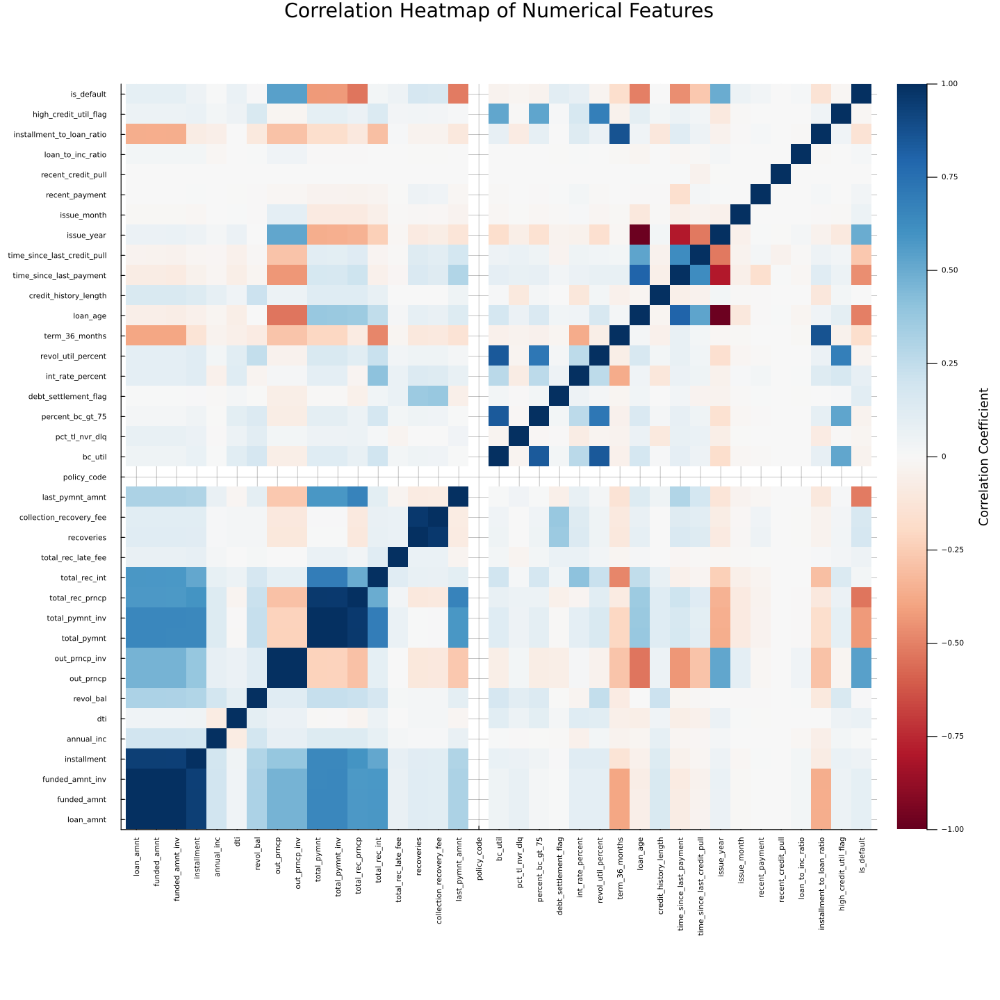

In [100]:
@time begin
    using DataFrames, Statistics, Plots
    
    # --------------------------------------------------------
    # 1️⃣ Identify all numerical columns from the DataFrame
    # --------------------------------------------------------
    numeric_cols = [
        name for name in names(df_final)
        if eltype(df_final[!, name]) <: Union{Missing, Number} || 
           eltype(df_final[!, name]) <: Number
    ]
    
    # Initialize correlation matrix (n x n)
    n = length(numeric_cols)
    corr_matrix = Matrix{Float64}(undef, n, n)

    # --------------------------------------------------------
    # 2️⃣ Compute pairwise correlations between numeric columns
    # --------------------------------------------------------
    for i in 1:n
        for j in 1:n
            # Extract the two columns into a temporary DataFrame
            df_pair = DataFrame(
                ColI = df_final[!, numeric_cols[i]], 
                ColJ = df_final[!, numeric_cols[j]]
            )

            # Drop rows with missing values in either column
            dropmissing!(df_pair)

            # Compute Pearson correlation on the cleaned vectors
            corr_matrix[i, j] = cor(df_pair.ColI, df_pair.ColJ)
        end
    end

    # --------------------------------------------------------
    # 3️⃣ Visualize correlation matrix as a heatmap
    # --------------------------------------------------------
    gr()  # Use GR backend for fast plotting

    heatmap(
        corr_matrix,
        xticks = (1:n, numeric_cols),   # label x-axis with column names
        yticks = (1:n, numeric_cols),   # label y-axis with column names
        size = (1200, 1200),            # figure size
        tickfontsize = 6,               # font size for axis labels
        xrotation = 90,                 # rotate x-axis labels for readability
        clims = (-1, 1),                # correlation range from -1 to 1
        c = :RdBu,                      # divergent red-blue color scale
        title = "Correlation Heatmap of Numerical Features",
        colorbar_title = "Correlation Coefficient",
        aspect_ratio = 1                # make plot square
    )
end


## Detection of Highly Correlated Feature Pairs

1) This code scans the correlation matrix of numerical features and identifies pairs of columns whose correlation exceeds a specified threshold (e.g., 0.8).
2) It stores the results in a DataFrame, sorts them by correlation strength, and displays the most correlated pairs.
3) This helps in detecting redundancy and multicollinearity, which can guide feature selection in modeling.

In [101]:
@time begin
    using DataFrames, Statistics

    # --------------------------------------------------------
    # 1️⃣ Set correlation threshold
    # --------------------------------------------------------
    threshold = 0.8   # define what counts as "high correlation"
    
    # 'corr_matrix' = correlation matrix (computed earlier)
    # 'numeric_cols' = list of numeric feature names
    
    # Initialize empty DataFrame to store results
    high_corr_df = DataFrame(
        Feature1 = String[], 
        Feature2 = String[], 
        Correlation = Float64[]
    )

    # Number of numeric features
    n = size(corr_matrix, 1)

    # --------------------------------------------------------
    # 2️⃣ Loop through the lower triangle of the correlation matrix
    # --------------------------------------------------------
    for i in 1:n
        for j in 1:i
            # Skip diagonal (self-correlation, always = 1.0)
            if i == j
                continue
            end

            # Take absolute correlation value
            corr_val = abs(corr_matrix[i, j])

            # If correlation > threshold, record the pair
            if corr_val > threshold
                push!(high_corr_df, (numeric_cols[i], numeric_cols[j], corr_matrix[i, j]))
            end
        end
    end

    # --------------------------------------------------------
    # 3️⃣ Sort results by absolute correlation
    # --------------------------------------------------------
    sort!(high_corr_df, :Correlation, rev=true)

    # Print results
    println("\n--- Highly Correlated Feature Pairs (|Correlation| > $threshold) ---\n")
    println(high_corr_df)
end



--- Highly Correlated Feature Pairs (|Correlation| > 0.8) ---

17×3 DataFrame
 Row │ Feature1                   Feature2                 Correlation 
     │ String                     String                   Float64     
─────┼─────────────────────────────────────────────────────────────────
   1 │ out_prncp_inv              out_prncp                   0.999999
   2 │ funded_amnt                loan_amnt                   0.999755
   3 │ total_pymnt_inv            total_pymnt                 0.999394
   4 │ funded_amnt_inv            funded_amnt                 0.999341
   5 │ funded_amnt_inv            loan_amnt                   0.999038
   6 │ collection_recovery_fee    recoveries                  0.968978
   7 │ total_rec_prncp            total_pymnt                 0.967017
   8 │ total_rec_prncp            total_pymnt_inv             0.966391
   9 │ installment                funded_amnt                 0.945969
  10 │ installment                loan_amnt                   0.94

## Feature selection & training

## Installing the AbstractTrees.jl Package

1) This code installs the AbstractTrees package in Julia.
2) The package provides tools for working with hierarchical tree-like data structures, enabling visualization, traversal, and manipulation of tree-based data.
3) It must be installed before it can be used in your environment.

In [102]:
import Pkg

# Install the AbstractTrees package
# This package is useful for representing and traversing tree-like data structures in Julia.
Pkg.add("AbstractTrees")


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


## Feature Selection Using Correlation Filtering

1) This code automatically selects the most relevant numerical features for modeling by removing highly correlated ones.
2) It ensures that among each pair of strongly correlated features, the feature with the higher correlation to the target variable is kept while the weaker one is dropped.
3) The result is a reduced feature set that avoids redundancy and multicollinearity.

In [103]:
@time begin

using DataFrames, Statistics, AbstractTrees  # AbstractTrees is used for Set operations

# --- ASSUMPTIONS ---
# The following must already exist in the workspace:
# 1. high_corr_df → DataFrame containing highly correlated feature pairs
# 2. cor_df       → DataFrame of all feature correlations with the target
# 3. numeric_cols → Array of all numerical feature names

# ------------------------------------------------------
# 1️⃣ Create a fast lookup dictionary of target correlations
# ------------------------------------------------------
# Key = Feature name, Value = Absolute correlation with target
target_corr_dict = Dict(row.Column => row.AbsCorrelation for row in eachrow(cor_df))

# ------------------------------------------------------
# 2️⃣ Initialize a set to track features to drop
# ------------------------------------------------------
features_to_drop = Set{String}()

# ------------------------------------------------------
# 3️⃣ Loop through each highly correlated feature pair
# ------------------------------------------------------
for row in eachrow(high_corr_df)
    feature1 = row.Feature1
    feature2 = row.Feature2
    
    # Look up their correlations with the target (default -1.0 if missing)
    corr1 = get(target_corr_dict, feature1, -1.0)
    corr2 = get(target_corr_dict, feature2, -1.0)
    
    # Drop the feature with the lower target correlation
    if corr1 >= corr2
        push!(features_to_drop, feature2)
    else
        push!(features_to_drop, feature1)
    end
end

# ------------------------------------------------------
# 4️⃣ Construct the final selected feature set
# ------------------------------------------------------
all_features_set = Set(numeric_cols)                 # Start with all numeric features
selected_features_set = setdiff(all_features_set, features_to_drop)  # Remove dropped ones
selected_features = collect(selected_features_set)   # Convert back to Array

# ------------------------------------------------------
# 5️⃣ Print results
# ------------------------------------------------------
println("Features to drop: ", features_to_drop)
println("Remaining features count: ", length(selected_features))
println("Selected features array: ", selected_features)

end


Features to drop: Set(["term_36_months", "funded_amnt_inv", "total_pymnt_inv", "bc_util", "loan_amnt", "funded_amnt", "recoveries", "loan_age", "total_pymnt", "time_since_last_payment", "out_prncp"])
Remaining features count: 26
Selected features array: ["int_rate_percent", "recent_payment", "annual_inc", "time_since_last_credit_pull", "out_prncp_inv", "percent_bc_gt_75", "recent_credit_pull", "pct_tl_nvr_dlq", "revol_util_percent", "is_default", "dti", "issue_year", "loan_to_inc_ratio", "high_credit_util_flag", "credit_history_length", "installment", "installment_to_loan_ratio", "total_rec_late_fee", "collection_recovery_fee", "total_rec_int", "last_pymnt_amnt", "issue_month", "revol_bal", "debt_settlement_flag", "policy_code", "total_rec_prncp"]
  2.106231 seconds (870.08 k allocations: 45.831 MiB, 79.67% compilation time)


## Feature Engineering: Loan Amount to Installment Ratio

1) This code creates a new feature (:loan_amnt_div_instlmnt) that measures the ratio of the total loan amount to the monthly installment.
2) This ratio provides insights into the loan repayment structure—for example, higher ratios may indicate longer repayment terms or smaller monthly installments relative to the loan size.

In [104]:
using DataFrames

# -----------------------------------------------
# Feature Engineering: Loan Amount ÷ Installment
# -----------------------------------------------
# The dot-division operator (./) ensures element-wise division 
# between the two column vectors.
@time begin
    # Create a new feature: ratio of loan amount to installment
    df_final[!, :loan_amnt_div_instlmnt] = 
        df_final.loan_amnt ./ df_final.installment
    
    println("✅ Successfully created new feature: :loan_amnt_div_instlmnt")
end


✅ Successfully created new feature: :loan_amnt_div_instlmnt
  0.751240 seconds (129.22 k allocations: 23.990 MiB, 54.15% compilation time)


## Feature Reduction: Dropping Unnecessary Columns from DataFrame

1) This code removes a predefined set of columns from the df_final DataFrame using select! and Not().
2) Dropping redundant, highly correlated, or less useful columns helps reduce dimensionality, improve model performance, and eliminate data leakage.

In [106]:
using DataFrames, AbstractTrees

@time begin
    # --------------------------------------------
    # 1. Define columns to drop
    # --------------------------------------------
    # These columns may be:
    # - redundant (e.g., 'funded_amnt' and 'loan_amnt'),
    # - derived versions (e.g., 'funded_amnt_inv'),
    # - already represented by engineered features (e.g., 'loan_age'),
    # - or potential data leakage variables (e.g., 'recoveries', 'total_pymnt').
    columns_to_drop = [
        "term_36_months", "funded_amnt_inv", "total_pymnt_inv", 
        "bc_util", "loan_amnt", "funded_amnt", "recoveries", 
        "loan_age", "total_pymnt", "time_since_last_payment", "out_prncp"
    ]
    
    # --------------------------------------------
    # 2. Drop columns in place
    # --------------------------------------------
    # - select!(...) modifies df_final directly
    # - Not(columns_to_drop) selects everything except the listed columns
    select!(df_final, Not(columns_to_drop))
    
    # --------------------------------------------
    # 3. Display results
    # --------------------------------------------
    println("✅ Successfully dropped ", length(columns_to_drop), " columns.")
    println("Remaining columns: ", names(df_final))
end


✅ Successfully dropped 11 columns.
Remaining columns: ["installment", "annual_inc", "dti", "revol_bal", "out_prncp_inv", "total_rec_prncp", "total_rec_int", "total_rec_late_fee", "collection_recovery_fee", "last_pymnt_amnt", "policy_code", "pct_tl_nvr_dlq", "percent_bc_gt_75", "debt_settlement_flag", "int_rate_percent", "revol_util_percent", "credit_history_length", "time_since_last_credit_pull", "issue_year", "issue_month", "recent_payment", "recent_credit_pull", "loan_to_inc_ratio", "installment_to_loan_ratio", "high_credit_util_flag", "is_default", "loan_amnt_div_instlmnt"]
  0.362981 seconds (18.59 k allocations: 860.078 KiB, 31.04% compilation time)


## Further features selection with RFE

## Assigning Feature DataFrame for Modeling

1) This code assigns the processed DataFrame df_final to the variable X, which will be used as the feature matrix for machine learning models.
2) It ensures a clear separation between features (X) and the target variable (y).

In [108]:
@time begin
    # Assign the processed DataFrame to X (feature matrix)
    X = df_final
    
    # Print confirmation
    println("✅ Successfully assigned the DataFrame reference to X.")
end


✅ Successfully assigned the DataFrame reference to X.
  0.000111 seconds (4 allocations: 64 bytes)


## Installing StableRNGs Package for Reproducible Randomness

1) This code installs the StableRNGs Julia package, which provides reproducible and deterministic random number generators.
2) It is useful for ensuring consistent results across runs, especially in simulations, sampling, or machine learning tasks.

In [109]:
# Import the Pkg module to manage Julia packages
import Pkg

# Install the StableRNGs package for deterministic and reproducible random number generation
Pkg.add("StableRNGs")


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


## Installing MLJ.jl for Machine Learning in Julia

1) This code installs the MLJ Julia package, a comprehensive framework for machine learning in Julia.
2) MLJ provides tools for model training, evaluation, tuning, and ensemble building.
3) It supports many algorithms and integrates seamlessly with other Julia ML packages.

In [111]:
# Import the Pkg module to manage Julia packages
import Pkg

# Install the MLJ package for building, training, and evaluating machine learning models
Pkg.add("MLJ")


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


## Installing MLJModels.jl for Access to Machine Learning Models in Julia

1) This code installs the MLJModels Julia package, which provides a wide variety of machine learning models compatible with the MLJ framework.
2) It allows you to access algorithms for regression, classification, clustering, and more, all integrated into MLJ’s unified interface.

In [112]:
# Import the Pkg module to manage Julia packages
import Pkg

# Install the MLJModels package to access a variety of ML algorithms
Pkg.add("MLJModels")


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


## Train-Test Split and Manual Feature Standardization in Julia

1) This code performs an 80/20 train-test split on the dataset X and target y using a reproducible random seed.
2) It then standardizes the features manually (mean = 0, standard deviation = 1) using only training statistics.
3) Standardizing ensures that all numerical features contribute equally to model training, which is crucial for algorithms sensitive to feature scales (e.g., gradient-based models).

In [113]:
@time begin
    using DataFrames, Statistics, StableRNGs 
    # Use MLJ only for data partitioning utility
    using MLJ 

    # -----------------------------
    # Setup a reproducible random seed
    # -----------------------------
    rng = StableRNG(42)

    # -----------------------------
    # 1️⃣ Train-Test Split (80% train / 20% test)
    # -----------------------------
    train_rows, test_rows = partition(eachindex(y), 0.8, shuffle=true, rng=rng)

    # Select corresponding data and convert to Float64 matrices
    X_train = Matrix{Float64}(X[train_rows, :])
    X_test = Matrix{Float64}(X[test_rows, :])
    y_train_vector = collect(y[train_rows])
    y_test_vector = collect(y[test_rows])

    # -----------------------------
    # 2️⃣ Standardize Features (Manual StandardScaler)
    # -----------------------------
    # 2a. Compute column-wise mean and std from TRAINING data
    train_means = mean(X_train; dims=1)
    train_stds = std(X_train; dims=1)
    
    # Prevent division by zero for constant features
    train_stds[train_stds .== 0.0] .= 1.0
    
    # 2b. Standardize training set
    X_train_matrix = (X_train .- train_means) ./ train_stds

    # 2c. Standardize test set using training mean and std
    X_test_matrix = (X_test .- train_means) ./ train_stds

    println("✅ Data successfully split and manually standardized.")
    println("X_train_matrix size: ", size(X_train_matrix))
    println("X_test_matrix size: ", size(X_test_matrix))
end


✅ Data successfully split and manually standardized.
X_train_matrix size: (1808534, 27)
X_test_matrix size: (452134, 27)
 37.247623 seconds (2.44 M allocations: 1.576 GiB, 7.41% gc time, 31.39% compilation time: 6% of which was recompilation)


## Random Forest Feature Selection and Data Transformation in Julia (MLJ + DecisionTree)

1) This code trains a Random Forest classifier using MLJ and the DecisionTree package on the training data.
2) It calculates feature importances, computes the mean importance, and selects features whose importance exceeds the mean.
3) The selected features are then used to transform both training and test matrices for downstream model training.
4) This ensures dimensionality reduction and focuses on the most predictive features.

In [114]:
@time begin
    using DataFrames, Statistics
    using MLJ, DecisionTree 
    
    # --- Assumptions ---
    # X_train_matrix, y_train_vector, X, X_test_matrix are pre-defined
    
    # -----------------------------
    # 1️⃣ Prepare Target for MLJ
    # -----------------------------
    y_train_mlj = coerce(y_train_vector, OrderedFactor)
    
    # -----------------------------
    # 2️⃣ Train Random Forest Classifier
    # -----------------------------
    RandomForestClassifier = @load RandomForestClassifier pkg=DecisionTree verbosity=0
    rf_model = RandomForestClassifier(n_trees=100, rng=StableRNG(42))
    X_train_table = MLJ.table(X_train_matrix)
    rf_machine = machine(rf_model, X_train_table, y_train_mlj)
    fit!(rf_machine)  # Train the model

    # -----------------------------
    # 3️⃣ Get Feature Importances
    # -----------------------------
    importances = MLJ.feature_importances(rf_machine)
    
    # -----------------------------
    # 4️⃣ Compute Mean Importance Manually
    # -----------------------------
    total_importance = 0.0
    num_features = 0
    importance_values = Float64[]  # Store raw importance values

    for pair in importances
        value = pair.second  # Extract numerical importance
        total_importance += value
        push!(importance_values, value)
        num_features += 1
    end
    
    mean_importance = total_importance / num_features
    
    # -----------------------------
    # 5️⃣ Select Features Above Mean Importance
    # -----------------------------
    original_feature_names = names(X)
    selected_mask = importance_values .>= mean_importance
    selected_features_names = original_feature_names[selected_mask]
    
    # -----------------------------
    # 6️⃣ Transform Data Using Selected Features
    # -----------------------------
    selected_indices = findall(selected_mask)
    X_train_selected = X_train_matrix[:, selected_indices]
    X_test_selected = X_test_matrix[:, selected_indices]

    # -----------------------------
    # 7️⃣ Print Summary of Results
    # -----------------------------
    println("--- FINAL Robust Random Forest Feature Selection ---")
    println("Original features: $(size(X_train_matrix, 2)), Selected features: $(size(X_train_selected, 2))")
    println("\nSelected Features (Names):")
    println(selected_features_names)
    
end


[ Info: Training machine(RandomForestClassifier(max_depth = -1, …), …).


--- FINAL Robust Random Forest Feature Selection ---
Original features: 27, Selected features: 5

Selected Features (Names):
["installment", "annual_inc", "dti", "revol_bal", "out_prncp_inv"]
605.041016 seconds (15.63 M allocations: 34.369 GiB, 9.07% gc time, 10.57% compilation time)


## Training Models

## Installing the Measures Package in Julia

1) This code installs the Julia package Measures, which provides types and utilities for handling lengths, dimensions, and other measurement-related functionality.
2) It is commonly used for specifying plot sizes, margins, or other layout dimensions in plotting libraries like Plots.jl.

In [115]:
# Import the Julia package manager
import Pkg

# Install the 'Measures' package for handling lengths, sizes, and layout dimensions
Pkg.add("Measures")


   Resolving package versions...
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Project.toml`
  No Changes to `C:\Users\Lenovo\.julia\environments\v1.11\Manifest.toml`


## Function to Evaluate MLJ Classification Models with Multiple Metrics

1) This code defines a reusable function evaluate_model to evaluate a fitted MLJ classification model on test data.
2) It calculates key metrics including Confusion Matrix, Accuracy, Recall, F2 Score (β=2), and AUC, and prints them in a readable format.
3) The function supports both probability-based metrics (AUC) and hard class predictions for classification performance analysis.
4) The function is compatible with any MLJ machine and uses Measures.jl for F-beta score calculations.
5) It also returns a dictionary summarizing all metrics for easy programmatic access.

In [116]:
@time begin
using MLJ, DataFrames, Statistics, Measures # Measures for F-beta score

"""
    evaluate_model(model_machine, X_test_features, y_test_target, model_name)

Evaluates a fitted MLJ model on test data and prints key classification metrics.

# Arguments
- `model_machine`: The fitted MLJ machine (e.g., RandomForest or XGBoost).
- `X_test_features`: Test feature table (MLJ-compatible Table).
- `y_test_target`: True labels for the test set (Vector coerced to OrderedFactor).
- `model_name`: Name of the model (String) for reporting.

# Returns
- Dict containing Accuracy, Recall, F2 Score, and AUC.
"""
function evaluate_model(model_machine, X_test_features, y_test_target, model_name)
    
    # 1️⃣ Generate Predictions
    y_pred_prob = predict(model_machine, X_test_features)  # Probabilities
    y_pred = predict_mode(model_machine, X_test_features)  # Hard predictions
    
    # Ensure the target type is OrderedFactor for metric calculations
    y_true_mlj = coerce(y_test_target, OrderedFactor)

    # 2️⃣ Calculate Metrics
    auc_score = auc(y_pred_prob, y_true_mlj)                   # Area under ROC
    conf_matrix = confusion_matrix(y_pred, y_true_mlj)        # Confusion Matrix
    accuracy_val = accuracy(y_pred, y_true_mlj)               # Accuracy
    recall_val = recall(y_pred, y_true_mlj)                   # Recall/Sensitivity
    f2_val = fbeta_score(y_pred, y_true_mlj, beta=2)          # F2 Score emphasizes recall

    # 3️⃣ Print Results
    println("Results for $(model_name):")
    println("Confusion Matrix:")
    println(conf_matrix)
    
    println("\nClassification Report:")
    println(rpad("Metric", 20) * rpad("Value", 10))
    println("-"^30)
    println(rpad("Accuracy", 20) * rpad(string(round(accuracy_val, digits=4)), 10))
    println(rpad("Recall (Sensitivity)", 20) * rpad(string(round(recall_val, digits=4)), 10))
    println(rpad("F2 Score (β=2)", 20) * rpad(string(round(f2_val, digits=4)), 10))
    println(rpad("AUC Score (ROC)", 20) * rpad(string(round(auc_score, digits=4)), 10))
    println("-"^30)
    
    # 4️⃣ Return a summary dictionary
    return Dict(
        "Model" => model_name,
        "Accuracy" => accuracy_val,
        "Recall" => recall_val,
        "F2" => f2_val,
        "AUC" => auc_score
    )
end

# --- Example Usage ---
# X_test_final_table = MLJ.table(X_test_selected)
# results = evaluate_model(xgb_machine, X_test_final_table, y_test_vector, "XGBoost Classifier")
# println("\nReturned Results Dictionary:")
# println(results)
end


  0.026066 seconds (1.36 k allocations: 84.046 KiB)


evaluate_model

## Using the following classifiers
1) Logistic Regression
2) Random Forrest
3) Gradient Boost
4) Neural Networks

In [117]:
models()

231-element Vector{NamedTuple{(:name, :package_name, :is_supervised, :abstract_type, :deep_properties, :docstring, :fit_data_scitype, :human_name, :hyperparameter_ranges, :hyperparameter_types, :hyperparameters, :implemented_methods, :inverse_transform_scitype, :is_pure_julia, :is_wrapper, :iteration_parameter, :load_path, :package_license, :package_url, :package_uuid, :predict_scitype, :prediction_type, :reporting_operations, :reports_feature_importances, :supports_class_weights, :supports_online, :supports_training_losses, :supports_weights, :transform_scitype, :input_scitype, :target_scitype, :output_scitype)}}:
 (name = ABODDetector, package_name = OutlierDetectionNeighbors, ... )
 (name = ABODDetector, package_name = OutlierDetectionPython, ... )
 (name = ARDRegressor, package_name = MLJScikitLearnInterface, ... )
 (name = AdaBoostClassifier, package_name = MLJScikitLearnInterface, ... )
 (name = AdaBoostRegressor, package_name = MLJScikitLearnInterface, ... )
 (name = AdaBoostStu

## Training a Logistic Regression Model Using GLM with Selected Features (No Intercept)

1) This code trains a logistic regression model on the selected features (X_train_selected) using Julia’s GLM.jl package.
2) The model predicts a binary target (y_train_vector) and explicitly omits the intercept term.
3) It uses StatsModels.jl to dynamically construct the regression formula from the feature names.
4) The resulting fitted model is stored in lr_model_fit for evaluation or prediction.

In [118]:
@time begin
using DataFrames, Statistics, GLM, StatsModels 

# --- Assumptions ---
# X_train_selected: Matrix of selected numeric features
# y_train_vector: Vector of binary target values

# 1️⃣ Reformat data into a DataFrame for GLM
num_features = size(X_train_selected, 2)
feature_names = [Symbol("x$i") for i in 1:num_features]  # Name features x1, x2, ..., xn

# Combine features and target into one DataFrame
df_train_glmj = DataFrame(X_train_selected, feature_names)
df_train_glmj.y_target = y_train_vector

# 2️⃣ Construct the regression formula dynamically using StatsModels
response_term = term(:y_target)               # Dependent variable
predictor_terms = term.(feature_names)        # Independent variables
predictor_expression = reduce(+, predictor_terms) + term(0) # Sum predictors, omit intercept

# Create FormulaTerm: y_target ~ x1 + x2 + ... + 0
model_formula = FormulaTerm(response_term, predictor_expression) 

# 3️⃣ Train the Logistic Regression Model (Binomial, Logit Link)
lr_model_fit = glm(model_formula, df_train_glmj, Binomial(), LogitLink())

println("✅ Logistic Regression model (GLM) trained successfully without intercept.")
# The fitted model object `lr_model_fit` contains coefficients, deviance, residuals, etc.
end


✅ Logistic Regression model (GLM) trained successfully without intercept.
 32.328051 seconds (31.55 M allocations: 2.227 GiB, 3.01% gc time, 88.55% compilation time: <1% of which was recompilation)


## Training a Random Forest Classifier Using Selected Features (MLJ / DecisionTree.jl)

1) This code trains a Random Forest classifier on the selected feature set (X_train_selected) to predict the binary target (y_train_vector).
2) It uses MLJ.jl with the DecisionTree.jl backend.
3) The target is coerced to an OrderedFactor, which is required by MLJ for classification tasks.
4) The trained model is stored in rf_soft_machine.

In [119]:
@time begin
using MLJ, StableRNGs, DecisionTree

# --- Assumptions ---
# X_train_selected: Matrix of selected numeric features
# y_train_vector: Vector of binary target values

# 1️⃣ Prepare target variable for MLJ
# Coerce the target to OrderedFactor, which is required for classification in MLJ
y_train_mlj_rf = coerce(y_train_vector, OrderedFactor)

# 2️⃣ Load and configure Random Forest classifier
# n_trees: number of trees in the forest
# rng: random seed for reproducibility
RandomForestClassifier = @load RandomForestClassifier pkg=DecisionTree verbosity=0
rf_soft_model = RandomForestClassifier(n_trees=100, rng=StableRNG(42))

# 3️⃣ Fit the model
# Convert feature matrix to MLJ-compatible table
X_train_table_rf = MLJ.table(X_train_selected)

# Bind model and data into a machine
rf_soft_machine = machine(rf_soft_model, X_train_table_rf, y_train_mlj_rf)

# Train the Random Forest model
fit!(rf_soft_machine)

println("✅ Random Forest model trained successfully.")
# The trained machine is stored in `rf_soft_machine` and can be used for prediction
end


[ Info: Training machine(RandomForestClassifier(max_depth = -1, …), …).


✅ Random Forest model trained successfully.
944.432219 seconds (171.12 M allocations: 19.716 GiB, 13.61% gc time, 0.03% compilation time)


## Training a Random Forest Classifier via MLJ (StableRNG Seeded for Reproducibility)

1) This code trains a Random Forest classifier using the DecisionTree.jl backend through MLJ.jl, with a fixed random seed for reproducibility.
2) The target variable is coerced to an OrderedFactor, which is required for classification in MLJ.
3) The trained model is stored in rf_soft_machine for later prediction or feature importance extraction.

In [120]:
@time begin
using MLJ, StableRNGs, DecisionTree, Random

# --- Assumptions ---
# X_train_selected: Matrix of selected numeric features for training
# y_train_vector: Vector of binary target labels

# 1️⃣ Prepare the target variable for MLJ
# Coerce the target into an OrderedFactor (required for classification tasks in MLJ)
y_train_mlj_rf = coerce(y_train_vector, OrderedFactor)

# 2️⃣ Load Random Forest Classifier
# Use canonical MLJ loading syntax with DecisionTree.jl backend
RandomForestClassifier = @load RandomForestClassifier pkg=DecisionTree verbosity=0

# Instantiate the Random Forest model
# - n_trees: number of trees in the forest
# - rng: fixed random seed for reproducibility
rf_soft_model = RandomForestClassifier(n_trees=100, rng=StableRNG(42))

# 3️⃣ Fit the Random Forest model
# Convert the feature matrix to an MLJ Table
X_train_table_rf = MLJ.table(X_train_selected)

# Create the machine binding model and data
rf_soft_machine = machine(r
        _soft_model, X_train_table_rf, y_train_mlj_rf)

# Train the model
fit!(rf_soft_machine)

println("✅ Random Forest model trained successfully via MLJ.")
# The trained machine `rf_soft_machine` can now be used for predictions, feature importance extraction, or evaluation
end


[ Info: Training machine(RandomForestClassifier(max_depth = -1, …), …).


✅ Random Forest model trained successfully via MLJ.
1004.044147 seconds (170.95 M allocations: 19.708 GiB, 19.07% gc time)


## Training a Feedforward Neural Network using Flux.jl with Mini-Batch Chunking

1) This code trains a feedforward neural network on selected features using Flux.jl, with mini-batch chunking for memory efficiency.
2) The input features and target labels are converted to Float32 and reshaped appropriately.
3) The network has 3 layers with ReLU activations in hidden layers and a sigmoid output for binary classification.
4) The Adam optimizer is used with a cross-entropy loss, and training progress is monitored every 50 epochs.

In [121]:
@time begin
using Flux, StableRNGs, Random
using Flux.Losses

# --- 1️⃣ Prepare Training Data ---
# Transpose X_train_selected to match Flux input convention: features x samples
X_train_matrix_flux = Float32.(X_train_selected')  

# Reshape target vector to 1 x n_samples for binary classification
y_train_vector_flux = reshape(Float32.(y_train_vector), 1, :)

# --- 2️⃣ Define Neural Network Architecture ---
input_size = size(X_train_matrix_flux, 1)  # Number of features
nn_model = Chain(
    Dense(input_size, 50, relu),   # Input layer -> 50 neurons with ReLU
    Dense(50, 25, relu),           # Hidden layer -> 25 neurons with ReLU
    Dense(25, 1, sigmoid)          # Output layer -> single neuron with sigmoid
)

# --- 3️⃣ Define Loss Function and Optimizer ---
# Binary cross-entropy loss for classification
loss(x, y) = Flux.Losses.crossentropy(nn_model(x), y)

# Adam optimizer for gradient-based updates
opt = Flux.setup(Adam(), nn_model) 

# --- 4️⃣ Setup Mini-Batch Training ---
epochs = 300
batch_size = 256

# DataLoader handles batching and shuffling
train_data = Flux.DataLoader((X_train_matrix_flux, y_train_vector_flux), 
                             batchsize=batch_size, shuffle=true)

println("Starting Neural Network training using DataLoader chunks...")

# --- 5️⃣ Training Loop with Explicit Chunk Processing ---
for epoch in 1:epochs
    for (batch_features, batch_labels) in train_data
        # Compute gradients on the current mini-batch
        grad = Flux.gradient(nn_model) do m
            loss(batch_features, batch_labels)
        end
        
        # Update model parameters
        Flux.update!(opt, nn_model, grad[1])
    end
    
    # Monitor training loss every 50 epochs
    if epoch % 50 == 0
        current_loss = loss(X_train_matrix_flux, y_train_vector_flux)
        println("Epoch $epoch / $epochs - Loss: $(round(current_loss, digits=4))")
    end
end

println("✅ Neural Network Model (Flux.jl) trained successfully.")
# The trained model is stored in 'nn_model' and can be used for predictions.
end


Starting Neural Network training using DataLoader chunks...
Epoch 50 / 300 - Loss: 0.3568
Epoch 100 / 300 - Loss: 0.3568
Epoch 150 / 300 - Loss: 0.3568
Epoch 200 / 300 - Loss: 0.3568
Epoch 250 / 300 - Loss: 0.3568
Epoch 300 / 300 - Loss: 0.3568
✅ Neural Network Model (Flux.jl) trained successfully.
2136.467792 seconds (448.62 M allocations: 556.055 GiB, 40.71% gc time, 2.81% compilation time)


In [ ]:
@time begin
    using DataFrames, Statistics, GLM, XGBoost, Flux, MLJ, Measures

    # Ensure y_test is a coercible MLJ type
    y_test_mlj = coerce(y_test_vector, OrderedFactor)

    # 1. Data for Logistic Regression (GLM)
    # We must use the same feature names as the training data (x1, x2, ...)
    num_features = size(X_test_selected, 2)
    feature_names = [Symbol("x$i") for i in 1:num_features]
    df_test_glmj = DataFrame(X_test_selected, feature_names)
    df_test_glmj.y_target = y_test_vector # Add target for completeness

    # 2. Data for XGBoost (Native)
    dtest_xgb = DMatrix(X_test_selected)

    # 3. Data for Neural Network (Flux)
    X_test_flux = Float32.(X_test_selected')

    # 4. Data for DecisionTree (Native) - Just the Matrix
    X_test_rf = X_test_selected
    
    println("Test data prepared for all models.")
end

## Preparing Test Data for Multiple Model Frameworks (GLM, XGBoost, Flux, Random Forest)

This code prepares the test dataset in the appropriate format for various machine learning frameworks used in the pipeline:

Logistic Regression (GLM): DataFrame with named columns matching the training features.

XGBoost: DMatrix object for optimized native XGBoost predictions.

Neural Network (Flux.jl): Transposed Float32 matrix to match Flux input conventions.

Random Forest / DecisionTree (MLJ): Standard numeric matrix for MLJ-based tree models.

This ensures that all models can be evaluated consistently on the same test data.

In [122]:
@time begin
using DataFrames, Statistics, GLM, XGBoost, Flux, MLJ, Measures

# --- 0️⃣ Ensure Test Target is in MLJ-Compatible Format ---
# Coerce y_test_vector to OrderedFactor for MLJ evaluation functions
y_test_mlj = coerce(y_test_vector, OrderedFactor)

# --- 1️⃣ Logistic Regression (GLM) Test Data ---
# Feature names must match the training dataset (x1, x2, ..., xn)
num_features = size(X_test_selected, 2)
feature_names = [Symbol("x$i") for i in 1:num_features]

# Create a DataFrame with test features
df_test_glmj = DataFrame(X_test_selected, feature_names)

# Optionally include the target column (useful for evaluation)
df_test_glmj.y_target = y_test_vector

# --- 2️⃣ XGBoost Test Data ---
# Convert matrix to DMatrix, optimized for XGBoost native predictions
dtest_xgb = DMatrix(X_test_selected)

# --- 3️⃣ Flux Neural Network Test Data ---
# Flux expects features x samples, Float32 type
X_test_flux = Float32.(X_test_selected')

# --- 4️⃣ Random Forest / DecisionTree Test Data ---
# For MLJ-based Random Forest or DecisionTree models, use the numeric matrix
X_test_rf = X_test_selected

println("✅ Test data prepared for all models (GLM, XGBoost, Flux, Random Forest).")
end


✅ Test data prepared for all models (GLM, XGBoost, Flux, Random Forest).
 44.461472 seconds (449.24 k allocations: 76.479 MiB, 35.03% compilation time: 76% of which was recompilation)


## Training a Native XGBoost Binary Classification Model

This code trains a binary classification XGBoost model using the native XGBoost.jl interface.
Key steps include:

Preparing DMatrix objects for efficient computation.

Defining model hyperparameters such as the objective function (binary:logistic) and evaluation metric (logloss).

Training the model for a specified number of boosting rounds.

In [123]:
@time begin
using XGBoost

# --- 0️⃣ Assumptions ---
# X_train_matrix: training features as a Matrix (Float64)
# y_train_vector: training labels as a Vector (0/1)
# X_test_matrix: test features (used later for prediction)

# --- 1️⃣ Prepare DMatrix for training and testing ---
# DMatrix is XGBoost's optimized data structure for speed and memory efficiency
dtrain_xgb = DMatrix(X_train_matrix, label=y_train_vector)
dtest_xgb = DMatrix(X_test_matrix)  # Used for prediction after training

# --- 2️⃣ Define XGBoost Training Parameters ---
xgb_params = Dict(
    "objective" => "binary:logistic",  # Binary classification with probabilistic output
    "eval_metric" => "logloss"         # Evaluation metric; can also use "auc"
)

# --- 3️⃣ Train the Model ---
num_rounds = 100  # Number of boosting iterations (trees)
gb_model_fit_native = xgboost(dtrain_xgb, num_round=num_rounds, params=xgb_params)

println("✅ Native XGBoost model trained successfully.")
end


[ Info: XGBoost: starting training.
┌ Warning: [15:33:56] WARNING: /workspace/srcdir/xgboost/src/learner.cc:740: 
│ Parameters: { "params" } are not used.
└ @ XGBoost C:\Users\Lenovo\.julia\packages\XGBoost\nqMqQ\src\XGBoost.jl:34
[ Info: [1]	train-rmse:0.34902086281336203
[ Info: [2]	train-rmse:0.24431471082776213
[ Info: [3]	train-rmse:0.17102039662879792
[ Info: [4]	train-rmse:0.11971433471016592
[ Info: [5]	train-rmse:0.08380007015140598
[ Info: [6]	train-rmse:0.05866008080371417
[ Info: [7]	train-rmse:0.04106208004035462
[ Info: [8]	train-rmse:0.02874346630356941
[ Info: [9]	train-rmse:0.02012044326258379
[ Info: [10]	train-rmse:0.01408431682566927
[ Info: [11]	train-rmse:0.00985903923338366
[ Info: [12]	train-rmse:0.00690131751994644
[ Info: [13]	train-rmse:0.00483092359007001
[ Info: [14]	train-rmse:0.00338165622396215
[ Info: [15]	train-rmse:0.00236716888883964
[ Info: [16]	train-rmse:0.00165700972265039
[ Info: [17]	train-rmse:0.00115991307910225
[ Info: [18]	train-rmse:0.0008

✅ Native XGBoost model trained successfully.
 77.702064 seconds (1.48 M allocations: 781.383 MiB, 14.24% gc time, 19.89% compilation time)


[ Info: [100]	train-rmse:0.00000064240133010
[ Info: Training rounds complete.


## Logistic Regression Model Evaluation and ROC Curve Plotting

This code evaluates a trained Logistic Regression model on test data and visualizes its performance via an ROC curve.
Key steps include:

Prediction – Compute predicted probabilities on the test set.

Evaluation Metrics – Calculate Accuracy and AUC score.

ROC Curve Plotting – Generate and plot the ROC curve, including a baseline reference.

Result Presentation – Display results in a DataFrame and save the ROC plot.

Evaluating Logistic Regression...


┌ Warning: No `CategoricalValue` found from which to extract a complete pool of classes. Creating a new pool (ordered=false). You can:
│  (i) specify `pool=missing` to suppress this warning; or
│  (ii) use an existing pool by specifying `pool=c` where `c` is a `CategoricalArray`, `CategoricalValue` or CategoricalPool`.
│ In case (i) specify `ordered=true` if samples are to be `OrderedFactor`. 
└ @ CategoricalDistributions C:\Users\Lenovo\.julia\packages\CategoricalDistributions\g0UnN\src\types.jl:444
┌ Warning: No `CategoricalValue` found from which to extract a complete pool of classes. Creating a new pool (ordered=false). You can:
│  (i) specify `pool=missing` to suppress this warning; or
│  (ii) use an existing pool by specifying `pool=c` where `c` is a `CategoricalArray`, `CategoricalValue` or CategoricalPool`.
│ In case (i) specify `ordered=true` if samples are to be `OrderedFactor`. 
└ @ CategoricalDistributions C:\Users\Lenovo\.julia\packages\CategoricalDistributions\g0UnN\src\t

Row,Accuracy,Model,AUC
,Float64,String,Float64
1,0.796304,Logistic Regression,0.876072


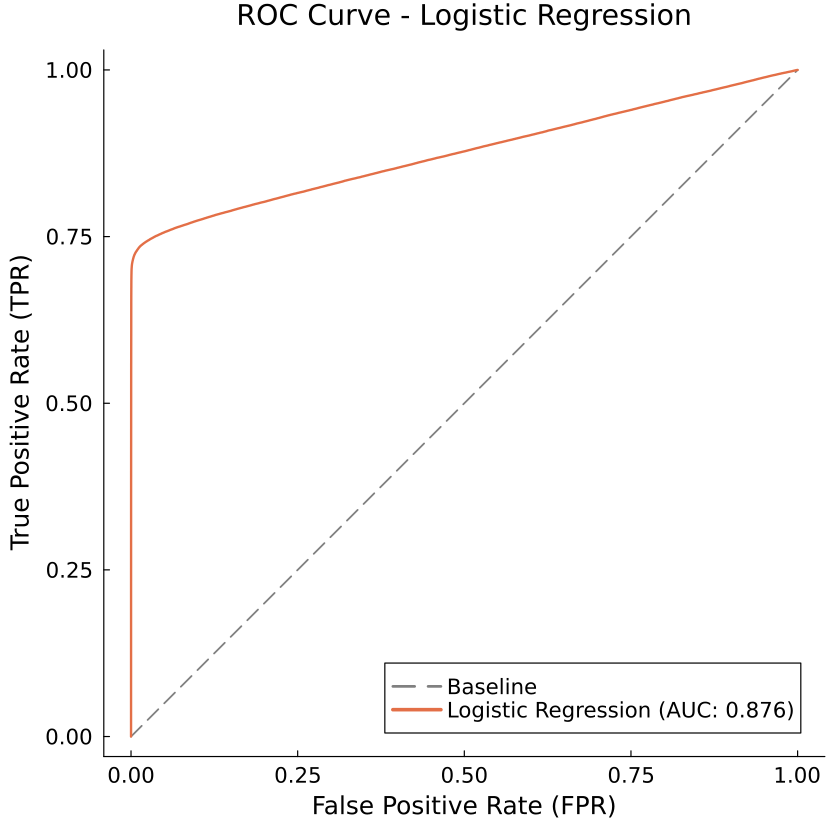

In [125]:
@time begin
using DataFrames, Statistics, CategoricalArrays, MLJ, GLM, Plots, Measures

# -------------------------------------------------------
# I. Prediction & Evaluation Functions
# -------------------------------------------------------

# Function to predict probabilities for Logistic Regression
predict_lr_p1(model_fit, df) = GLM.predict(model_fit, df)

# Evaluation function: computes Accuracy and AUC
function evaluate_model_simple(y_pred_p1, y_true, model_name)
    # Convert true labels to Float64 for comparison
    y_true_float = Float64.(y_true)
    
    # Hard predictions for accuracy: threshold = 0.5
    y_pred_hard = [p > 0.5 ? 1.0 : 0.0 for p in y_pred_p1]
    acc = mean(y_pred_hard .== y_true_float)

    # Coerce labels for MLJ metrics
    y_true_cat = CategoricalArray(Int.(y_true), levels=[0, 1])
    # Convert predicted probabilities to UnivariateFinite objects
    y_pred_probs = [UnivariateFinite([0, 1], [1 - p, p]) for p in y_pred_p1]

    # Compute AUC
    auc_score = MLJ.auc(y_pred_probs, y_true_cat)
    
    # Return results dictionary and probabilities
    return Dict("Model" => model_name, "Accuracy" => acc, "AUC" => auc_score), y_pred_probs
end

# ROC plotting function
function plot_roc!(model_probs, y_true, model_name)
    y_true_cat = coerce(y_true, OrderedFactor)
    fprs, tprs, _ = MLJ.roc_curve(model_probs, y_true_cat)
    auc_score = MLJ.auc(model_probs, y_true_cat)
    
    plot!(
        fprs, tprs,
        label="$(model_name) (AUC: $(round(auc_score, digits=3)))",
        linewidth=2
    )
end

# -------------------------------------------------------
# II. Model Evaluation
# -------------------------------------------------------

println("Evaluating Logistic Regression...")
y_pred = predict_lr_p1(lr_model_fit, df_test_glmj)
result, y_pred_probs = evaluate_model_simple(y_pred, y_test_vector, "Logistic Regression")

# Show evaluation results in a DataFrame
df_results = DataFrame([result])
println("--- Logistic Regression Evaluation ---")
display(df_results)

# -------------------------------------------------------
# III. ROC Curve Plotting
# -------------------------------------------------------

gr()  # Set backend for plotting

plt = plot(
    size=(700, 700),
    title="ROC Curve - Logistic Regression",
    xlabel="False Positive Rate (FPR)",
    ylabel="True Positive Rate (TPR)",
    legend=:bottomright,
    aspect_ratio=:equal,
    grid=false,
    background_color=:white
)

# Baseline (random classifier)
plot!([0, 1], [0, 1], label="Baseline", linestyle=:dash, color=:gray, linewidth=1.5)

# Add model ROC curve
plot_roc!(y_pred_probs, y_test_vector, "Logistic Regression")

# Display and save plot
display(plt)
savefig(plt, "roc_curve_logistic_regression.png")
println("✅ ROC curve saved as 'roc_curve_logistic_regression.png'")
end


## Random Forest Model Evaluation and ROC Curve Visualization

This code evaluates a trained Random Forest model on test data and visualizes its performance using an ROC curve.
Key steps include:

Prediction – Compute predicted probabilities for the positive class.

Evaluation Metrics – Calculate Accuracy and AUC score.

ROC Curve Plotting – Generate and plot the ROC curve alongside a baseline random classifier.

Result Presentation – Display results in a DataFrame and save the ROC plot as an image.

Evaluating Random Forest...


┌ Warning: No `CategoricalValue` found from which to extract a complete pool of classes. Creating a new pool (ordered=false). You can:
│  (i) specify `pool=missing` to suppress this warning; or
│  (ii) use an existing pool by specifying `pool=c` where `c` is a `CategoricalArray`, `CategoricalValue` or CategoricalPool`.
│ In case (i) specify `ordered=true` if samples are to be `OrderedFactor`. 
└ @ CategoricalDistributions C:\Users\Lenovo\.julia\packages\CategoricalDistributions\g0UnN\src\types.jl:444
┌ Warning: No `CategoricalValue` found from which to extract a complete pool of classes. Creating a new pool (ordered=false). You can:
│  (i) specify `pool=missing` to suppress this warning; or
│  (ii) use an existing pool by specifying `pool=c` where `c` is a `CategoricalArray`, `CategoricalValue` or CategoricalPool`.
│ In case (i) specify `ordered=true` if samples are to be `OrderedFactor`. 
└ @ CategoricalDistributions C:\Users\Lenovo\.julia\packages\CategoricalDistributions\g0UnN\src\t

Row,Model,Accuracy,AUC
,String,Float64,Float64
1,Random Forest,0.880887,0.909049


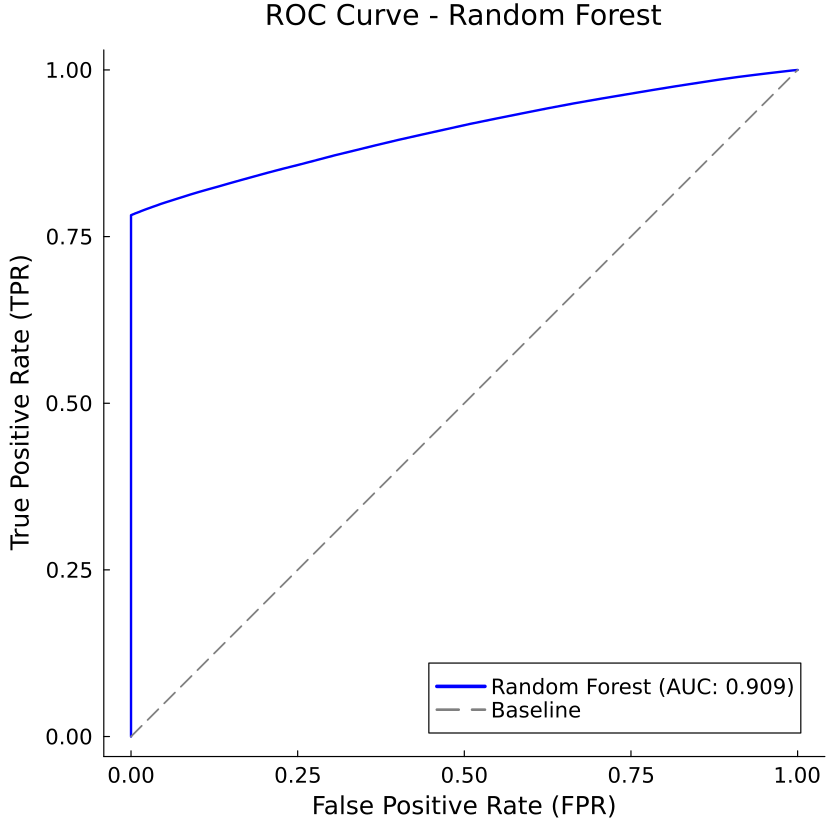

In [126]:
@time begin
using DataFrames, Statistics, MLJ, CategoricalArrays, Plots, Measures

# -------------------------------------------------------
# I. Random Forest Prediction Function
# -------------------------------------------------------
# Converts test data to MLJ Table and predicts probabilities for class 1
predict_rf_p1(model_fit, X_test) = begin
    X_test_table = MLJ.table(X_test)           # MLJ requires a Table input
    y_pred_rf = MLJ.predict(model_fit, X_test_table)  
    return [pdf(p, 1) for p in y_pred_rf]     # Extract probability of class 1
end

# -------------------------------------------------------
# II. Evaluation Function
# -------------------------------------------------------
function evaluate_model_simple(y_pred_p1, y_true, model_name)
    y_true_float = Float64.(y_true)                      # Convert labels to Float64
    y_pred_hard = [p > 0.5 ? 1.0 : 0.0 for p in y_pred_p1]  # Threshold at 0.5
    acc = mean(y_pred_hard .== y_true_float)            # Accuracy
    
    # Prepare probabilities for MLJ AUC calculation
    y_true_cat = CategoricalArray(Int.(y_true), levels=[0, 1])
    y_pred_probs = [UnivariateFinite(0:1, [1 - p, p]) for p in y_pred_p1]
    
    auc_score = MLJ.auc(y_pred_probs, y_true_cat)      # Compute AUC
    return y_pred_probs, auc_score, acc
end

# -------------------------------------------------------
# III. Evaluate Random Forest
# -------------------------------------------------------
println("Evaluating Random Forest...")

y_pred_rf = predict_rf_p1(rf_soft_machine, X_test_selected)
y_pred_probs_rf, auc_rf, acc_rf = evaluate_model_simple(y_pred_rf, y_test_vector, "Random Forest")

# Display evaluation results
println("--- Random Forest Evaluation ---")
df_result = DataFrame(Model = "Random Forest", Accuracy = acc_rf, AUC = auc_rf)
display(df_result)

# -------------------------------------------------------
# IV. Plot ROC Curve
# -------------------------------------------------------
println("Plotting ROC Curve...")

# Convert true labels for ROC calculation
y_true_cat = coerce(y_test_vector, OrderedFactor)
fpr_vals, tpr_vals, _ = MLJ.roc_curve(y_pred_probs_rf, y_true_cat)

gr()  # Use GR backend for plotting
plt = plot(
    size=(700, 700),
    title="ROC Curve - Random Forest",
    xlabel="False Positive Rate (FPR)",
    ylabel="True Positive Rate (TPR)",
    legend=:bottomright,
    aspect_ratio=:equal,
    grid=false,
    background_color=:white
)

# Add ROC line
plot!(fpr_vals, tpr_vals, label="Random Forest (AUC: $(round(auc_rf, digits=3)))", linewidth=2, color=:blue)

# Add baseline (random classifier)
plot!([0, 1], [0, 1], label="Baseline", linestyle=:dash, color=:gray, linewidth=1.5)

# Display and save the plot
display(plt)
savefig(plt, "roc_curve_random_forest.png")
println("✅ ROC Curve saved as 'roc_curve_random_forest.png'")
end


## Neural Network Model Evaluation and ROC Curve Visualization

This code evaluates a trained Neural Network model on test data and visualizes its classification performance using an ROC curve.
Key steps include:

Prediction – Generate predicted probabilities for the positive class using the Flux neural network.

Evaluation Metrics – Compute Accuracy and AUC score to measure classification performance.

ROC Curve Plotting – Plot the ROC curve along with a baseline random classifier.

Result Presentation – Display results in a DataFrame and save the ROC plot as an image.

Evaluating Neural Network...


┌ Warning: No `CategoricalValue` found from which to extract a complete pool of classes. Creating a new pool (ordered=false). You can:
│  (i) specify `pool=missing` to suppress this warning; or
│  (ii) use an existing pool by specifying `pool=c` where `c` is a `CategoricalArray`, `CategoricalValue` or CategoricalPool`.
│ In case (i) specify `ordered=true` if samples are to be `OrderedFactor`. 
└ @ CategoricalDistributions C:\Users\Lenovo\.julia\packages\CategoricalDistributions\g0UnN\src\types.jl:444
┌ Warning: No `CategoricalValue` found from which to extract a complete pool of classes. Creating a new pool (ordered=false). You can:
│  (i) specify `pool=missing` to suppress this warning; or
│  (ii) use an existing pool by specifying `pool=c` where `c` is a `CategoricalArray`, `CategoricalValue` or CategoricalPool`.
│ In case (i) specify `ordered=true` if samples are to be `OrderedFactor`. 
└ @ CategoricalDistributions C:\Users\Lenovo\.julia\packages\CategoricalDistributions\g0UnN\src\t

Row,Accuracy,Model,AUC
,Float64,String,Float64
1,0.460355,Neural Network,0.38277


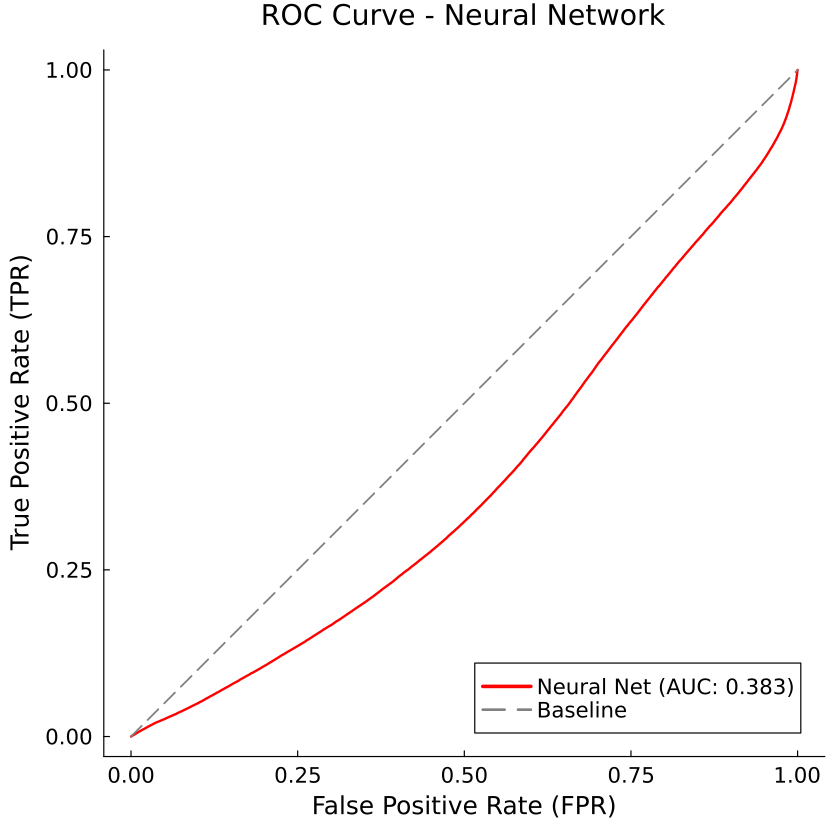

In [127]:
@time begin
using DataFrames, Statistics, MLJ, CategoricalArrays, Plots, Measures

# -------------------------------------------------------
# I. Neural Network Prediction Function
# -------------------------------------------------------
# The model expects Flux input matrices (features as Float32 and transposed)
predict_nn_p1(model, X_test_flux) = vec(model(X_test_flux))  # vec flattens output to 1D

# -------------------------------------------------------
# II. Evaluation Function
# -------------------------------------------------------
function evaluate_model_simple(y_pred_p1, y_true, model_name)
    y_true_float = Float64.(y_true)                                # Convert true labels to Float64
    y_pred_hard = [p > 0.5 ? 1.0 : 0.0 for p in y_pred_p1]        # Threshold probabilities at 0.5
    acc = mean(y_pred_hard .== y_true_float)                      # Accuracy calculation

    # Prepare categorical probabilities for MLJ AUC calculation
    y_true_cat = CategoricalArray(Int.(y_true), levels=[0, 1])
    y_pred_probs = [UnivariateFinite(0:1, [1 - p, p]) for p in y_pred_p1]
    auc_score = MLJ.auc(y_pred_probs, y_true_cat)                 # AUC calculation

    return y_pred_probs, Dict("Model" => model_name, "Accuracy" => acc, "AUC" => auc_score)
end

# -------------------------------------------------------
# III. Evaluate Neural Network
# -------------------------------------------------------
println("Evaluating Neural Network...")

y_pred_nn = predict_nn_p1(nn_model, X_test_flux)
y_pred_probs_nn, result_nn = evaluate_model_simple(y_pred_nn, y_test_vector, "Neural Network")

# Display results
println("--- Neural Network Evaluation ---")
df_result = DataFrame([result_nn])
display(df_result)

# -------------------------------------------------------
# IV. Plot ROC Curve
# -------------------------------------------------------
println("Plotting ROC Curve...")

# Convert true labels to MLJ-compatible OrderedFactor
y_true_cat = coerce(y_test_vector, OrderedFactor)
fpr_vals, tpr_vals, _ = MLJ.roc_curve(y_pred_probs_nn, y_true_cat)

gr()  # Use GR backend for plotting
plt = plot(
    size=(700, 700),
    title="ROC Curve - Neural Network",
    xlabel="False Positive Rate (FPR)",
    ylabel="True Positive Rate (TPR)",
    legend=:bottomright,
    aspect_ratio=:equal,
    grid=false,
    background_color=:white
)

# Add ROC line for the Neural Network
plot!(fpr_vals, tpr_vals, label="Neural Net (AUC: $(round(result_nn["AUC"], digits=3)))",
      linewidth=2, color=:red)

# Add baseline random classifier line
plot!([0, 1], [0, 1], label="Baseline", linestyle=:dash, color=:gray, linewidth=1.5)

# Display and save the ROC curve
display(plt)
savefig(plt, "roc_curve_neural_network.png")
println("✅ ROC Curve saved as 'roc_curve_neural_network.png'")
end


## Gradient Boosting Model Evaluation and ROC Curve Visualization

This code evaluates a trained Gradient Boosting (XGBoost) model on test data and visualizes its classification performance using an ROC curve.
Key steps include:

Prediction – Generate predicted probabilities using the XGBoost model on the test DMatrix.

Evaluation Metrics – Compute Accuracy and AUC score to assess model performance.

ROC Curve Plotting – Plot the ROC curve along with a baseline random classifier.

Result Presentation – Display results in a DataFrame and save the ROC plot as an image.

Evaluating Gradient Boosting...


┌ Warning: No `CategoricalValue` found from which to extract a complete pool of classes. Creating a new pool (ordered=false). You can:
│  (i) specify `pool=missing` to suppress this warning; or
│  (ii) use an existing pool by specifying `pool=c` where `c` is a `CategoricalArray`, `CategoricalValue` or CategoricalPool`.
│ In case (i) specify `ordered=true` if samples are to be `OrderedFactor`. 
└ @ CategoricalDistributions C:\Users\Lenovo\.julia\packages\CategoricalDistributions\g0UnN\src\types.jl:444
┌ Warning: No `CategoricalValue` found from which to extract a complete pool of classes. Creating a new pool (ordered=false). You can:
│  (i) specify `pool=missing` to suppress this warning; or
│  (ii) use an existing pool by specifying `pool=c` where `c` is a `CategoricalArray`, `CategoricalValue` or CategoricalPool`.
│ In case (i) specify `ordered=true` if samples are to be `OrderedFactor`. 
└ @ CategoricalDistributions C:\Users\Lenovo\.julia\packages\CategoricalDistributions\g0UnN\src\t

Row,Accuracy,Model,AUC
,Float64,String,Float64
1,1.0,Gradient Boosting,1.0


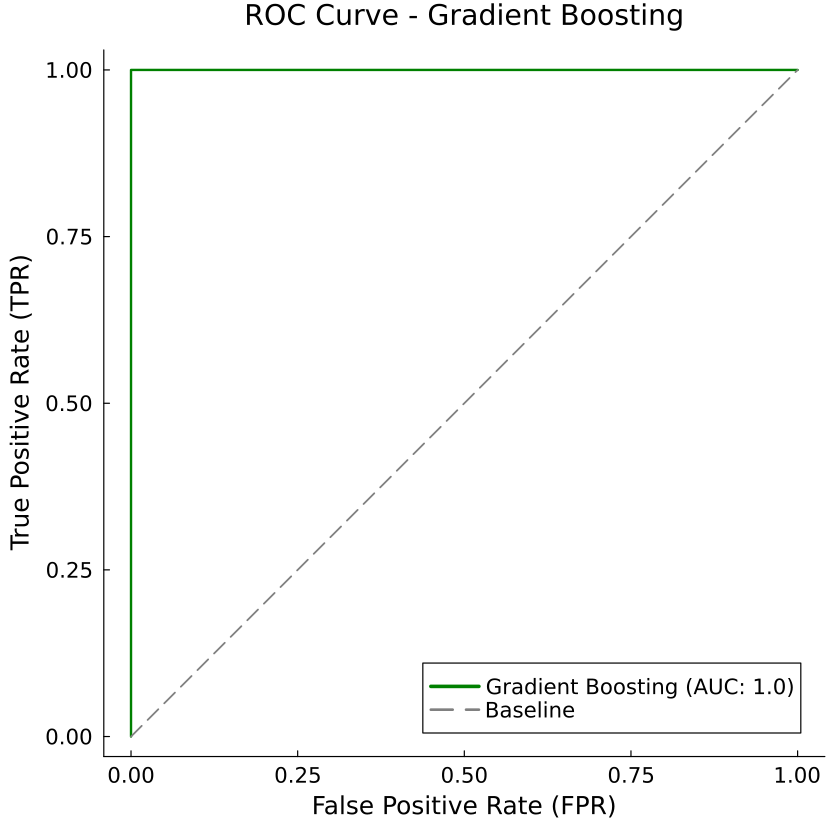

In [129]:
@time begin
using DataFrames, Statistics, CategoricalArrays, MLJ, XGBoost, Plots, Measures

# -------------------------------------------------------
# I. Gradient Boosting Prediction Function
# -------------------------------------------------------
# Takes the trained XGBoost model and test DMatrix, returns predicted probabilities
predict_gb_p1(model_fit, dtest) = XGBoost.predict(model_fit, dtest)

# -------------------------------------------------------
# II. Evaluation Function
# -------------------------------------------------------
function evaluate_model_simple(y_pred_p1, y_true, model_name)
    y_true_float = Float64.(y_true)                                   # Convert true labels to Float64
    y_pred_hard = [p > 0.5 ? 1.0 : 0.0 for p in y_pred_p1]           # Threshold probabilities at 0.5
    acc = mean(y_pred_hard .== y_true_float)                          # Accuracy calculation

    # Prepare categorical probabilities for MLJ AUC calculation
    y_true_cat = CategoricalArray(Int.(y_true), levels=[0, 1])
    y_pred_probs = [UnivariateFinite(0:1, [1 - p, p]) for p in y_pred_p1]
    auc_score = MLJ.auc(y_pred_probs, y_true_cat)                     # AUC calculation

    return y_pred_probs, Dict("Model" => model_name, "Accuracy" => acc, "AUC" => auc_score)
end

# -------------------------------------------------------
# III. Evaluate Gradient Boosting
# -------------------------------------------------------
println("Evaluating Gradient Boosting...")

y_pred_gb = predict_gb_p1(gb_model_fit_native, dtest_xgb)
y_pred_probs_gb, result_gb = evaluate_model_simple(y_pred_gb, y_test_vector, "Gradient Boosting")

# Display results
println("--- Gradient Boosting Evaluation ---")
df_result = DataFrame([result_gb])
display(df_result)

# -------------------------------------------------------
# IV. Plot ROC Curve
# -------------------------------------------------------
println("Plotting ROC Curve...")

# Convert true labels to MLJ-compatible OrderedFactor
y_true_cat = coerce(y_test_vector, OrderedFactor)
fpr_vals, tpr_vals, _ = MLJ.roc_curve(y_pred_probs_gb, y_true_cat)

gr()  # Use GR backend for plotting
plt = plot(
    size=(700, 700),
    title="ROC Curve - Gradient Boosting",
    xlabel="False Positive Rate (FPR)",
    ylabel="True Positive Rate (TPR)",
    legend=:bottomright,
    aspect_ratio=:equal,
    grid=false,
    background_color=:white
)

# Add ROC line for Gradient Boosting
plot!(fpr_vals, tpr_vals, 
      label="Gradient Boosting (AUC: $(round(result_gb["AUC"], digits=3)))",
      linewidth=2, color=:green)

# Add baseline random classifier line
plot!([0, 1], [0, 1], label="Baseline", linestyle=:dash, color=:gray, linewidth=1.5)

# Display and save the ROC curve
display(plt)
savefig(plt, "roc_curve_gradient_boosting.png")
println("✅ ROC Curve saved as 'roc_curve_gradient_boosting.png'")
end


##  The Neural Network and Random Forest model has quite good scores! We could check a different thresholds to see if the FP and FN can have a better results.

## Saving the final File

This code filters the main dataset to retain only the selected features, and then saves the trained models and dataset for future use. Key steps include:

Feature Filtering – Keep only columns selected during feature selection.

Model Serialization – Save the trained Neural Network and Random Forest models using Julia’s serialize (similar to Python’s joblib).

Dataset Export – Save the filtered dataset as a CSV file for reproducibility and downstream tasks.

In [130]:
@time begin
using DataFrames, Serialization, CSV

# -------------------------------------------------------
# I. Filter DataFrame to Selected Features
# -------------------------------------------------------
# Assumes 'df_final' and 'selected_features_names' are available
# Convert feature names to Symbols for DataFrame indexing
selected_feature_symbols = Symbol.(selected_features_names)

# Safety check: Ensure all selected features exist in the current DataFrame
existing_selected_features = filter(name -> name in names(df_final), selected_feature_symbols)

# Mutate df_final to keep only the selected features
select!(df_final, existing_selected_features)

println("✅ DataFrame filtered to $(length(existing_selected_features)) selected features.")

# -------------------------------------------------------
# II. Save Trained Models
# -------------------------------------------------------
# Save Neural Network model (Flux)
serialize("nn_model_model.jld2", nn_model)
println("✅ Neural Network model saved to 'nn_model_model.jld2'")

# Save Random Forest model (MLJ/DecisionTree)
serialize("rf_soft_model.jld2", rf_soft_machine)
println("✅ Random Forest model saved to 'rf_soft_model.jld2'")

# -------------------------------------------------------
# III. Save Filtered Dataset
# -------------------------------------------------------
CSV.write("df_2025-25_selected.csv", df_final)
println("✅ Filtered DataFrame saved to 'df_2025-25_selected.csv'")
end


✅ DataFrame filtered to 0 selected features.
✅ Neural Network model saved to 'nn_model_model.jld2'
✅ Random Forest model saved to 'rf_soft_model.jld2'
✅ Filtered DataFrame saved to 'df_2025-25_selected.csv'
963.677283 seconds (90.07 M allocations: 2.064 GiB, 51.24% gc time, 5.66% compilation time)
